In [1]:
import os
import torch
import torchvision
import numpy as np
import pandas as pd
import torch.nn as nn
from torch import optim
from tqdm.auto import tqdm
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
import torchvision.models as models
from torchvision import datasets, transforms
from torch.autograd import grad as torch_grad
from torch.utils.data import ConcatDataset, DataLoader, Subset

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

In [2]:
transform = transforms.Compose([transforms.Resize((128, 128)), 
                                transforms.ToTensor(), 
                                transforms.Normalize(mean=[0.5]*3, std=[0.5]*3)]) 

dataset = datasets.ImageFolder(
    root='/kaggle/input/datasets/zahraaghapour/flowers-images/flowers/flowers', 
    transform=transform) 

loader = DataLoader(dataset, batch_size=32, shuffle=True, drop_last=True)

In [3]:
len(loader)

189

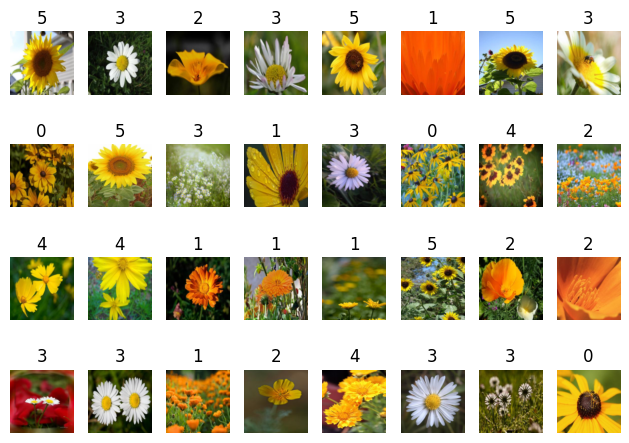

In [4]:
for image, label in loader:
    fig, ax = plt.subplots(4, 8)

    for i, ax in enumerate(ax.flat):
        img = image[i]
        lab = label[i]

        img = img * 0.5 + 0.5
        img = img.numpy()

        ax.imshow(np.transpose(img, (1,2,0)))
        ax.set_title(str(lab.item()))
        ax.axis(False)
    break

plt.tight_layout()
plt.show()

# Vanilla GAN

In [ ]:
class Generator(nn.Module):
    def __init__(self, latent_dim):
        super(Generator, self).__init__()

        self.model = nn.Sequential(
            nn.Linear(latent_dim, 256*8*8),
            nn.ReLU(),
            nn.Unflatten(1, (256, 8, 8)),
            
            nn.Upsample(scale_factor=2),
            nn.Conv2d(256, 128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128, momentum=0.8),
            nn.ReLU(),
            
            nn.Upsample(scale_factor=2),
            nn.Conv2d(128, 64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64, momentum=0.8),
            nn.ReLU(),

            nn.Upsample(scale_factor=2),
            nn.Conv2d(64, 32, kernel_size=3, padding=1),
            nn.BatchNorm2d(32, momentum=0.8),
            nn.Tanh(),
            
            nn.Upsample(scale_factor=2),
            nn.Conv2d(32, 3, kernel_size=3, padding=1),
            nn.Tanh(),
        )

    def forward(self, z):
        img = self.model(z)
        return img

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        self.model = nn.Sequential(
            nn.Conv2d(3, 32, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.1),
            
            nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64, momentum=0.8),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.1),
            
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128, momentum=0.8),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.1),
            
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256, momentum=0.8),
            nn.LeakyReLU(0.2),
            
            nn.AdaptiveAvgPool2d((1,1)),
            nn.Flatten(),
            nn.Linear(256, 1),
            nn.Sigmoid()
        )

    def forward(self, img):
        validity = self.model(img)
        return validity

In [ ]:
latent_dim = 100
D_lr = 0.0001
G_lr = 0.0002
beta1 = 0.5
beta2 = 0.999

generator = Generator(latent_dim).to(device)
discriminator = Discriminator().to(device)

adversarial_loss = nn.BCELoss()

optimizer_G = optim.Adam(generator.parameters(),
                        lr = G_lr,
                        betas = (beta1, beta2))
optimizer_D = optim.Adam(discriminator.parameters(),
                        lr = D_lr,
                        betas = (beta1, beta2))

In [ ]:
with torch.no_grad():
        z = torch.randn(16, latent_dim, device=device)
        generated = generator(z).detach().cpu()
        grid = torchvision.utils.make_grid(generated, nrow=4, normalize=True)
        plt.imshow(np.transpose(grid, (1,2,0)))
        plt.axis("off")
        plt.show()

In [ ]:
net_generator_loss = []
net_discriminator_loss = []

In [ ]:
epochs = 100

generator_loss = []
discriminator_loss = []

generator.train()
discriminator.train()

for epoch in range(epochs):
    for i, (images, labels) in tqdm(enumerate(loader), total = len(loader)):
        real_images = images.to(device)

        valid = torch.ones(real_images.size(0), 1, device=device) * 0.9
        fake = torch.zeros(real_images.size(0), 1, device=device)

        # TRAINING THE DISCRIMINATOR
        optimizer_D.zero_grad()
        z = torch.randn(real_images.size(0), latent_dim, device=device)
        fake_images = generator(z)
        real_loss = adversarial_loss(discriminator(real_images), valid)
        fake_loss = adversarial_loss(discriminator(fake_images.detach()), fake)
        d_loss = (real_loss + fake_loss)/2
        d_loss.backward()
        optimizer_D.step()

        # TRAINING THE GENERATOR
        for _ in range(2):
            optimizer_G.zero_grad()
            z = torch.randn(real_images.size(0), latent_dim, device=device)
            fake_images = generator(z)
            g_loss = adversarial_loss(discriminator(fake_images), valid)
            g_loss.backward()
            optimizer_G.step()

        discriminator_loss.append(d_loss.item())
        generator_loss.append(g_loss.item())
        
        if (i+1)%20 == 0:
            print(
                f"Epoch : {epoch+1}/{epochs} | Batch : {i+1}/{len(loader)} | ",
                f"Discriminator Loss : {d_loss.item():.4f} | ",
                f"Generator Loss : {g_loss.item():.4f} "
            )
    with torch.no_grad():
        z = torch.randn(16, latent_dim, device=device)
        generated = generator(z).detach().cpu()
        grid = torchvision.utils.make_grid(generated, nrow=4, normalize=True)
        plt.imshow(np.transpose(grid, (1,2,0)))
        plt.axis("off")
        plt.show()

net_generator_loss += generator_loss
net_discriminator_loss += discriminator_loss

In [ ]:
plt.style.use("fivethirtyeight")
plt.figure(figsize=(8,5))
plt.plot(net_generator_loss, label = "loss")
plt.plot(net_discriminator_loss, label = "loss")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

In [ ]:
with torch.no_grad():
        z = torch.randn(16, latent_dim, device=device)
        generated = generator(z).detach().cpu()
        grid = torchvision.utils.make_grid(generated, nrow=4, normalize=True)
        plt.imshow(np.transpose(grid, (1,2,0)))
        plt.axis("off")
        plt.show()

# WGAP with Gradient Penalty

In [5]:
class Generator_GP(nn.Module):
    def __init__(self, img_size, latent_dim, dim):
        super(Generator_GP, self).__init__()

        self.dim = dim
        self.latent_dim = latent_dim
        self.img_size = img_size
        self.feature_sizes = (self.img_size[1]//16, self.img_size[2]//16)

        self.latent_to_features = nn.Sequential(
            nn.Linear(latent_dim, 8*dim*self.feature_sizes[0]*self.feature_sizes[1]),
            nn.ReLU()
        )

        self.features_to_image = nn.Sequential(
            nn.ConvTranspose2d(8*dim, 4*dim, 4,2,1),
            nn.BatchNorm2d(4*dim),
            nn.ReLU(),
            nn.ConvTranspose2d(4*dim, 2*dim, 4,2,1),
            nn.BatchNorm2d(2*dim),
            nn.ReLU(),
            nn.ConvTranspose2d(2*dim, dim, 4,2,1),
            nn.BatchNorm2d(dim),
            nn.ReLU(),
            nn.ConvTranspose2d(dim, self.img_size[0], 4,2,1),
            nn.Tanh()
        )

    def forward(self, input_data):
        input_data.to(device)
        x = self.latent_to_features(input_data)
        x = x.view(-1, 8*self.dim, self.feature_sizes[0], self.feature_sizes[1])
        return self.features_to_image(x)

    def sample_latent(self, num_samples):
        return torch.randn((num_samples, self.latent_dim))

class Discriminator_GP(nn.Module):
    def __init__(self, img_size, dim):
        super(Discriminator_GP, self).__init__()

        self.img_size = img_size

        self.image_to_features = nn.Sequential(
            nn.Conv2d(self.img_size[0], dim, 4,2,1),
            nn.LeakyReLU(0.2),
            nn.Conv2d(dim, 2*dim, 4,2,1),
            nn.InstanceNorm2d(2*dim, affine=True), 
            nn.LeakyReLU(0.2),
            nn.Conv2d(2*dim, 4*dim, 4,2,1),
            nn.InstanceNorm2d(4*dim, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv2d(4*dim, 8*dim, 4,2,1),
            nn.InstanceNorm2d(8*dim, affine=True),
            nn.LeakyReLU(0.2),                       
        )

        output_size = 8*dim*(img_size[1]//16)*(img_size[2]//16)
        self.features_to_prob = nn.Sequential(
            nn.Linear(output_size, 1),
        )

    def forward(self, input_data):
        batch_size = input_data.size()[0]
        x = self.image_to_features(input_data)
        x = x.view(batch_size, -1)
        return self.features_to_prob(x)

def gradient_penalty_loss(real_data, gen_data, discriminator, gp_weight=10, device=device):
    batch_size = real_data.size(0)

    alpha = torch.rand(batch_size, 1, 1, 1, device=device)
    alpha = alpha.expand_as(real_data)

    interpolated = alpha * real_data + (1 - alpha) * gen_data
    interpolated.requires_grad_(True)

    prob_interpolated = discriminator(interpolated)

    gradients = torch.autograd.grad(
        outputs=prob_interpolated,
        inputs=interpolated,
        grad_outputs=torch.ones_like(prob_interpolated),
        create_graph=True,
        retain_graph=True)[0]

    gradients = gradients.view(batch_size, -1)
    gradient_norm = gradients.norm(2, dim=1)
    gradient_penalty = ((gradient_norm - 1) ** 2).mean()

    return gp_weight * gradient_penalty, gradient_norm.mean()

In [6]:
G_lr = 0.0002
D_lr = 0.00005

betas = (0.0, 0.9)

gp_weight = 10

img_size = (3, 128, 128)
latent_dim = 100
dim = 64

generator = Generator_GP(img_size=img_size, latent_dim=latent_dim, dim=dim)
discriminator = Discriminator_GP(img_size=img_size, dim=dim)

G_optimizer = optim.Adam(generator.parameters(), lr=G_lr, betas=betas)
D_optimizer = optim.Adam(discriminator.parameters(), lr=D_lr, betas=betas)

generator = generator.to(device)
discriminator = discriminator.to(device)

In [8]:
real_img, _ = next(iter(loader))
real_img = real_img.to(device)

z = torch.randn(32, latent_dim, device=device)
fake_img = generator(z)
print(f"Generator output shape : {fake_img.shape}")

score = discriminator(fake_img)
print(f"Discriminator output shape : {score.shape}")

gp, gn = gradient_penalty_loss(real_img, fake_img, discriminator)
print(f"Gradient penalty : {gp.item():.4f}")
print(f"Gradient norm : {gn.item():.4f}")

Generator output shape : torch.Size([32, 3, 128, 128])
Discriminator output shape : torch.Size([32, 1])
Gradient penalty : 8.8627
Gradient norm : 1.8554


In [9]:
G_loss_total = []
D_loss_total = []
Grad_pen_total = []
Grad_norm_total = []

os.makedirs("progress", exist_ok=True)

  0%|          | 0/100 [00:00<?, ?it/s]

Epoch 1/100 | Iter 19 /189 | D_loss -7.1071 | G_loss 4.3330 | Gradient_Penalty 0.7591 | Gradient_Norm 1.1861 | 
Epoch 1/100 | Iter 38 /189 | D_loss -11.6523 | G_loss 11.6571 | Gradient_Penalty 3.0017 | Gradient_Norm 1.5059 | 
Epoch 1/100 | Iter 57 /189 | D_loss -18.4500 | G_loss 20.4320 | Gradient_Penalty 3.9715 | Gradient_Norm 1.4794 | 
Epoch 1/100 | Iter 76 /189 | D_loss -10.6250 | G_loss 10.9420 | Gradient_Penalty 1.4991 | Gradient_Norm 1.3499 | 
Epoch 1/100 | Iter 95 /189 | D_loss -11.2046 | G_loss 21.7297 | Gradient_Penalty 1.2885 | Gradient_Norm 1.2959 | 
Epoch 1/100 | Iter 114/189 | D_loss -13.4006 | G_loss 22.2380 | Gradient_Penalty 1.5936 | Gradient_Norm 1.3597 | 
Epoch 1/100 | Iter 133/189 | D_loss -12.3105 | G_loss 19.1639 | Gradient_Penalty 1.9085 | Gradient_Norm 1.3984 | 
Epoch 1/100 | Iter 152/189 | D_loss -14.3061 | G_loss 23.5987 | Gradient_Penalty 1.4838 | Gradient_Norm 1.3444 | 
Epoch 1/100 | Iter 171/189 | D_loss -12.5821 | G_loss 24.5679 | Gradient_Penalty 1.6701 | 

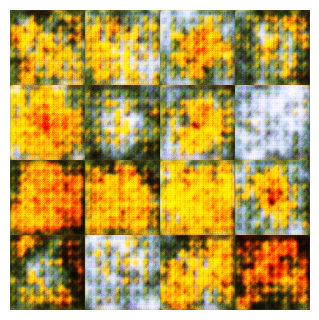

Epoch 2/100 | Iter 19 /189 | D_loss -15.8976 | G_loss 32.0076 | Gradient_Penalty 1.4470 | Gradient_Norm 1.3455 | 
Epoch 2/100 | Iter 38 /189 | D_loss -15.9190 | G_loss 34.1870 | Gradient_Penalty 1.7851 | Gradient_Norm 1.3717 | 
Epoch 2/100 | Iter 57 /189 | D_loss -15.4521 | G_loss 36.1468 | Gradient_Penalty 2.1374 | Gradient_Norm 1.4353 | 
Epoch 2/100 | Iter 76 /189 | D_loss -16.9345 | G_loss 38.8705 | Gradient_Penalty 2.4825 | Gradient_Norm 1.4539 | 
Epoch 2/100 | Iter 95 /189 | D_loss -14.3391 | G_loss 31.2545 | Gradient_Penalty 2.3621 | Gradient_Norm 1.4437 | 
Epoch 2/100 | Iter 114/189 | D_loss -13.0472 | G_loss 33.2040 | Gradient_Penalty 2.0332 | Gradient_Norm 1.4134 | 
Epoch 2/100 | Iter 133/189 | D_loss -11.3251 | G_loss 29.8394 | Gradient_Penalty 1.7231 | Gradient_Norm 1.3391 | 
Epoch 2/100 | Iter 152/189 | D_loss -14.5409 | G_loss 34.3348 | Gradient_Penalty 2.1299 | Gradient_Norm 1.3750 | 
Epoch 2/100 | Iter 171/189 | D_loss -10.8841 | G_loss 37.1496 | Gradient_Penalty 1.8618 

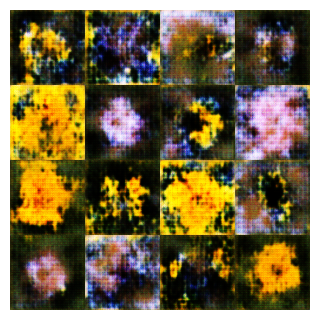

Epoch 3/100 | Iter 19 /189 | D_loss -14.1122 | G_loss 44.2915 | Gradient_Penalty 1.9897 | Gradient_Norm 1.3920 | 
Epoch 3/100 | Iter 38 /189 | D_loss -13.8934 | G_loss 40.1971 | Gradient_Penalty 2.4632 | Gradient_Norm 1.4318 | 
Epoch 3/100 | Iter 57 /189 | D_loss -14.4970 | G_loss 37.8327 | Gradient_Penalty 1.2702 | Gradient_Norm 1.3038 | 
Epoch 3/100 | Iter 76 /189 | D_loss -15.4639 | G_loss 42.3426 | Gradient_Penalty 1.8187 | Gradient_Norm 1.3703 | 
Epoch 3/100 | Iter 95 /189 | D_loss -13.9159 | G_loss 43.0552 | Gradient_Penalty 1.2784 | Gradient_Norm 1.2795 | 
Epoch 3/100 | Iter 114/189 | D_loss -12.7299 | G_loss 35.7262 | Gradient_Penalty 1.8080 | Gradient_Norm 1.3669 | 
Epoch 3/100 | Iter 133/189 | D_loss -12.8854 | G_loss 44.6446 | Gradient_Penalty 1.0478 | Gradient_Norm 1.2733 | 
Epoch 3/100 | Iter 152/189 | D_loss -13.1423 | G_loss 46.2830 | Gradient_Penalty 1.4588 | Gradient_Norm 1.3068 | 
Epoch 3/100 | Iter 171/189 | D_loss -11.4266 | G_loss 41.0325 | Gradient_Penalty 2.0913 

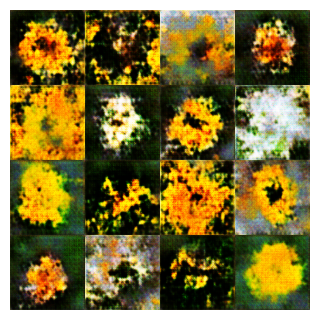

Epoch 4/100 | Iter 19 /189 | D_loss -7.3052 | G_loss 37.3238 | Gradient_Penalty 1.4057 | Gradient_Norm 1.3188 | 
Epoch 4/100 | Iter 38 /189 | D_loss -14.4692 | G_loss 44.3126 | Gradient_Penalty 1.8414 | Gradient_Norm 1.3371 | 
Epoch 4/100 | Iter 57 /189 | D_loss -15.8095 | G_loss 45.5402 | Gradient_Penalty 2.2206 | Gradient_Norm 1.3547 | 
Epoch 4/100 | Iter 76 /189 | D_loss -12.9790 | G_loss 37.2005 | Gradient_Penalty 1.3583 | Gradient_Norm 1.3268 | 
Epoch 4/100 | Iter 95 /189 | D_loss -15.6177 | G_loss 32.7115 | Gradient_Penalty 2.6081 | Gradient_Norm 1.3943 | 
Epoch 4/100 | Iter 114/189 | D_loss -12.9365 | G_loss 33.1757 | Gradient_Penalty 2.7762 | Gradient_Norm 1.4420 | 
Epoch 4/100 | Iter 133/189 | D_loss -11.0838 | G_loss 35.7137 | Gradient_Penalty 1.2715 | Gradient_Norm 1.3274 | 
Epoch 4/100 | Iter 152/189 | D_loss -10.8040 | G_loss 36.7356 | Gradient_Penalty 0.7838 | Gradient_Norm 1.2431 | 
Epoch 4/100 | Iter 171/189 | D_loss -14.7153 | G_loss 37.6039 | Gradient_Penalty 1.0373 |

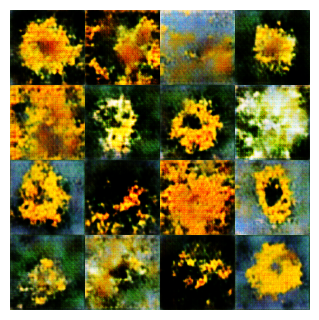

Epoch 5/100 | Iter 19 /189 | D_loss -13.7776 | G_loss 38.0610 | Gradient_Penalty 0.6849 | Gradient_Norm 1.2203 | 
Epoch 5/100 | Iter 38 /189 | D_loss -13.3592 | G_loss 35.7859 | Gradient_Penalty 1.8679 | Gradient_Norm 1.3029 | 
Epoch 5/100 | Iter 57 /189 | D_loss -16.2060 | G_loss 44.5626 | Gradient_Penalty 2.3454 | Gradient_Norm 1.3774 | 
Epoch 5/100 | Iter 76 /189 | D_loss -12.0537 | G_loss 45.2519 | Gradient_Penalty 1.6387 | Gradient_Norm 1.3156 | 
Epoch 5/100 | Iter 95 /189 | D_loss -18.8766 | G_loss 41.7075 | Gradient_Penalty 1.9154 | Gradient_Norm 1.3985 | 
Epoch 5/100 | Iter 114/189 | D_loss -9.8365 | G_loss 36.3186 | Gradient_Penalty 1.6445 | Gradient_Norm 1.3402 | 
Epoch 5/100 | Iter 133/189 | D_loss -13.1356 | G_loss 48.2945 | Gradient_Penalty 2.3051 | Gradient_Norm 1.3999 | 
Epoch 5/100 | Iter 152/189 | D_loss -12.8698 | G_loss 42.6705 | Gradient_Penalty 1.6307 | Gradient_Norm 1.3197 | 
Epoch 5/100 | Iter 171/189 | D_loss -11.9382 | G_loss 36.8477 | Gradient_Penalty 1.9038 |

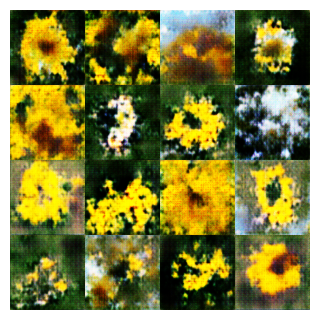

Epoch 6/100 | Iter 19 /189 | D_loss -13.2573 | G_loss 36.8894 | Gradient_Penalty 1.5743 | Gradient_Norm 1.3383 | 
Epoch 6/100 | Iter 38 /189 | D_loss -12.7829 | G_loss 33.4721 | Gradient_Penalty 1.9804 | Gradient_Norm 1.3844 | 
Epoch 6/100 | Iter 57 /189 | D_loss -15.5738 | G_loss 48.4369 | Gradient_Penalty 2.2348 | Gradient_Norm 1.3685 | 
Epoch 6/100 | Iter 76 /189 | D_loss -12.0561 | G_loss 45.8383 | Gradient_Penalty 1.5133 | Gradient_Norm 1.3063 | 
Epoch 6/100 | Iter 95 /189 | D_loss -14.4990 | G_loss 31.7427 | Gradient_Penalty 2.3086 | Gradient_Norm 1.4473 | 
Epoch 6/100 | Iter 114/189 | D_loss -12.3831 | G_loss 45.4596 | Gradient_Penalty 1.6801 | Gradient_Norm 1.3489 | 
Epoch 6/100 | Iter 133/189 | D_loss -13.7887 | G_loss 32.9987 | Gradient_Penalty 1.0049 | Gradient_Norm 1.2689 | 
Epoch 6/100 | Iter 152/189 | D_loss -10.5274 | G_loss 36.4494 | Gradient_Penalty 1.2177 | Gradient_Norm 1.3027 | 
Epoch 6/100 | Iter 171/189 | D_loss -12.2284 | G_loss 39.2292 | Gradient_Penalty 2.0196 

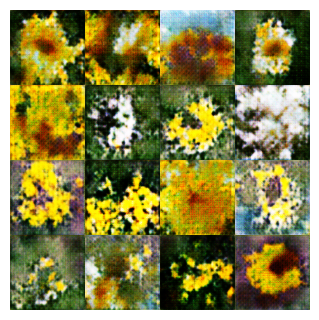

Epoch 7/100 | Iter 19 /189 | D_loss -15.7308 | G_loss 34.4196 | Gradient_Penalty 1.6914 | Gradient_Norm 1.3591 | 
Epoch 7/100 | Iter 38 /189 | D_loss -9.4251 | G_loss 30.7096 | Gradient_Penalty 0.9478 | Gradient_Norm 1.2612 | 
Epoch 7/100 | Iter 57 /189 | D_loss -7.1974 | G_loss 34.8805 | Gradient_Penalty 1.6143 | Gradient_Norm 1.3347 | 
Epoch 7/100 | Iter 76 /189 | D_loss -11.9743 | G_loss 44.2007 | Gradient_Penalty 1.4290 | Gradient_Norm 1.3407 | 
Epoch 7/100 | Iter 95 /189 | D_loss -10.9703 | G_loss 52.1218 | Gradient_Penalty 1.2665 | Gradient_Norm 1.2882 | 
Epoch 7/100 | Iter 114/189 | D_loss -15.7544 | G_loss 45.3769 | Gradient_Penalty 1.9179 | Gradient_Norm 1.3675 | 
Epoch 7/100 | Iter 133/189 | D_loss -13.7520 | G_loss 51.7835 | Gradient_Penalty 1.2464 | Gradient_Norm 1.2871 | 
Epoch 7/100 | Iter 152/189 | D_loss -6.6053 | G_loss 40.2721 | Gradient_Penalty 1.0532 | Gradient_Norm 1.2547 | 
Epoch 7/100 | Iter 171/189 | D_loss -15.3806 | G_loss 40.8979 | Gradient_Penalty 1.0470 | G

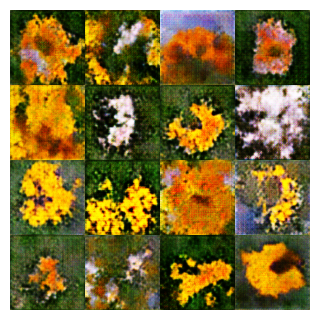

Epoch 8/100 | Iter 19 /189 | D_loss -7.3166 | G_loss 42.9114 | Gradient_Penalty 1.4766 | Gradient_Norm 1.2976 | 
Epoch 8/100 | Iter 38 /189 | D_loss -8.8410 | G_loss 40.5995 | Gradient_Penalty 1.5497 | Gradient_Norm 1.3027 | 
Epoch 8/100 | Iter 57 /189 | D_loss -14.1598 | G_loss 42.9252 | Gradient_Penalty 1.2748 | Gradient_Norm 1.3064 | 
Epoch 8/100 | Iter 76 /189 | D_loss -8.9954 | G_loss 43.6347 | Gradient_Penalty 0.6938 | Gradient_Norm 1.1874 | 
Epoch 8/100 | Iter 95 /189 | D_loss -13.6886 | G_loss 42.1004 | Gradient_Penalty 1.8195 | Gradient_Norm 1.3724 | 
Epoch 8/100 | Iter 114/189 | D_loss -11.4736 | G_loss 61.6111 | Gradient_Penalty 1.5853 | Gradient_Norm 1.3500 | 
Epoch 8/100 | Iter 133/189 | D_loss -13.4428 | G_loss 38.6178 | Gradient_Penalty 1.5574 | Gradient_Norm 1.3210 | 
Epoch 8/100 | Iter 152/189 | D_loss -12.3547 | G_loss 60.6105 | Gradient_Penalty 2.1319 | Gradient_Norm 1.3891 | 
Epoch 8/100 | Iter 171/189 | D_loss -14.4839 | G_loss 41.8259 | Gradient_Penalty 1.1422 | G

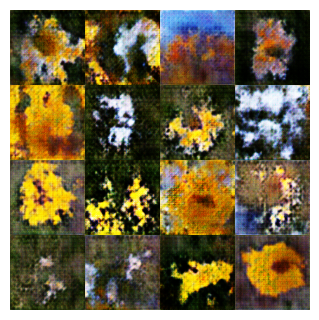

Epoch 9/100 | Iter 19 /189 | D_loss -9.1025 | G_loss 45.5151 | Gradient_Penalty 1.0185 | Gradient_Norm 1.2125 | 
Epoch 9/100 | Iter 38 /189 | D_loss -14.9101 | G_loss 36.1588 | Gradient_Penalty 3.3701 | Gradient_Norm 1.4924 | 
Epoch 9/100 | Iter 57 /189 | D_loss -17.8989 | G_loss 35.9561 | Gradient_Penalty 1.6670 | Gradient_Norm 1.3544 | 
Epoch 9/100 | Iter 76 /189 | D_loss -13.5622 | G_loss 51.3173 | Gradient_Penalty 1.4436 | Gradient_Norm 1.2744 | 
Epoch 9/100 | Iter 95 /189 | D_loss -15.0026 | G_loss 48.5096 | Gradient_Penalty 1.9964 | Gradient_Norm 1.4039 | 
Epoch 9/100 | Iter 114/189 | D_loss -15.3910 | G_loss 44.9141 | Gradient_Penalty 1.3064 | Gradient_Norm 1.3024 | 
Epoch 9/100 | Iter 133/189 | D_loss -13.0644 | G_loss 45.6514 | Gradient_Penalty 0.8656 | Gradient_Norm 1.2455 | 
Epoch 9/100 | Iter 152/189 | D_loss -4.9660 | G_loss 42.5165 | Gradient_Penalty 1.4294 | Gradient_Norm 1.3066 | 
Epoch 9/100 | Iter 171/189 | D_loss -15.1955 | G_loss 64.2733 | Gradient_Penalty 1.4091 | 

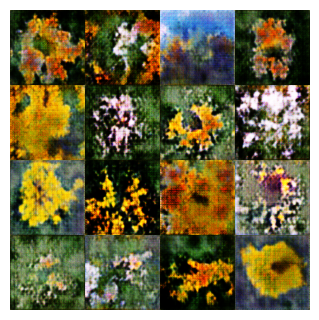

Epoch 10/100 | Iter 19 /189 | D_loss -11.0439 | G_loss 53.6635 | Gradient_Penalty 1.3998 | Gradient_Norm 1.3198 | 
Epoch 10/100 | Iter 38 /189 | D_loss -17.6045 | G_loss 48.8281 | Gradient_Penalty 1.9612 | Gradient_Norm 1.3695 | 
Epoch 10/100 | Iter 57 /189 | D_loss -17.1196 | G_loss 52.0700 | Gradient_Penalty 2.2095 | Gradient_Norm 1.3729 | 
Epoch 10/100 | Iter 76 /189 | D_loss -13.1347 | G_loss 38.7435 | Gradient_Penalty 2.0328 | Gradient_Norm 1.3753 | 
Epoch 10/100 | Iter 95 /189 | D_loss -16.4079 | G_loss 44.4504 | Gradient_Penalty 1.7091 | Gradient_Norm 1.3632 | 
Epoch 10/100 | Iter 114/189 | D_loss -11.9571 | G_loss 56.1386 | Gradient_Penalty 2.5270 | Gradient_Norm 1.4223 | 
Epoch 10/100 | Iter 133/189 | D_loss -12.7451 | G_loss 48.9793 | Gradient_Penalty 1.8358 | Gradient_Norm 1.3673 | 
Epoch 10/100 | Iter 152/189 | D_loss -12.5387 | G_loss 36.2364 | Gradient_Penalty 3.1668 | Gradient_Norm 1.5049 | 
Epoch 10/100 | Iter 171/189 | D_loss -16.4278 | G_loss 53.5639 | Gradient_Penalt

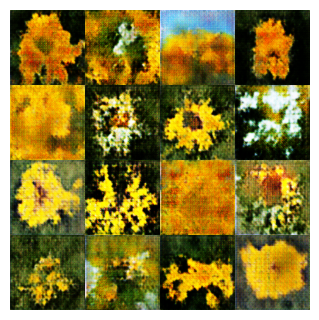

Epoch 11/100 | Iter 19 /189 | D_loss -13.0483 | G_loss 38.1611 | Gradient_Penalty 2.1702 | Gradient_Norm 1.4043 | 
Epoch 11/100 | Iter 38 /189 | D_loss -14.7650 | G_loss 49.7792 | Gradient_Penalty 1.0677 | Gradient_Norm 1.2696 | 
Epoch 11/100 | Iter 57 /189 | D_loss -17.7825 | G_loss 44.2747 | Gradient_Penalty 2.5719 | Gradient_Norm 1.4525 | 
Epoch 11/100 | Iter 76 /189 | D_loss -12.0865 | G_loss 51.2274 | Gradient_Penalty 2.9380 | Gradient_Norm 1.4574 | 
Epoch 11/100 | Iter 95 /189 | D_loss -12.4204 | G_loss 41.7389 | Gradient_Penalty 2.9863 | Gradient_Norm 1.4760 | 
Epoch 11/100 | Iter 114/189 | D_loss -11.7167 | G_loss 63.4365 | Gradient_Penalty 2.3307 | Gradient_Norm 1.3834 | 
Epoch 11/100 | Iter 133/189 | D_loss -8.3219 | G_loss 48.9039 | Gradient_Penalty 1.6349 | Gradient_Norm 1.2499 | 
Epoch 11/100 | Iter 152/189 | D_loss -12.0631 | G_loss 53.2966 | Gradient_Penalty 1.6189 | Gradient_Norm 1.3045 | 
Epoch 11/100 | Iter 171/189 | D_loss -17.8083 | G_loss 40.6239 | Gradient_Penalty

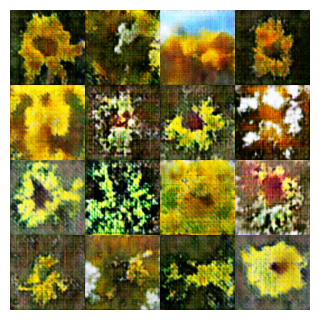

Epoch 12/100 | Iter 19 /189 | D_loss -7.9392 | G_loss 45.0218 | Gradient_Penalty 0.9867 | Gradient_Norm 1.2367 | 
Epoch 12/100 | Iter 38 /189 | D_loss -21.2927 | G_loss 57.5626 | Gradient_Penalty 2.7295 | Gradient_Norm 1.4377 | 
Epoch 12/100 | Iter 57 /189 | D_loss -13.4765 | G_loss 61.4522 | Gradient_Penalty 1.3488 | Gradient_Norm 1.2807 | 
Epoch 12/100 | Iter 76 /189 | D_loss -15.3957 | G_loss 57.4724 | Gradient_Penalty 1.3310 | Gradient_Norm 1.3077 | 
Epoch 12/100 | Iter 95 /189 | D_loss -14.0076 | G_loss 56.6153 | Gradient_Penalty 1.1785 | Gradient_Norm 1.2769 | 
Epoch 12/100 | Iter 114/189 | D_loss -13.4865 | G_loss 63.1930 | Gradient_Penalty 1.3857 | Gradient_Norm 1.3030 | 
Epoch 12/100 | Iter 133/189 | D_loss -13.4888 | G_loss 53.8044 | Gradient_Penalty 3.0693 | Gradient_Norm 1.4800 | 
Epoch 12/100 | Iter 152/189 | D_loss -11.6572 | G_loss 58.8297 | Gradient_Penalty 1.9244 | Gradient_Norm 1.3719 | 
Epoch 12/100 | Iter 171/189 | D_loss -18.9525 | G_loss 59.3254 | Gradient_Penalty

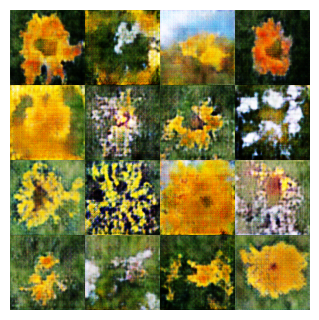

Epoch 13/100 | Iter 19 /189 | D_loss -11.3750 | G_loss 48.6462 | Gradient_Penalty 0.6693 | Gradient_Norm 1.1862 | 
Epoch 13/100 | Iter 38 /189 | D_loss -20.1609 | G_loss 43.1011 | Gradient_Penalty 1.2698 | Gradient_Norm 1.3160 | 
Epoch 13/100 | Iter 57 /189 | D_loss -13.5745 | G_loss 36.9731 | Gradient_Penalty 2.3776 | Gradient_Norm 1.3234 | 
Epoch 13/100 | Iter 76 /189 | D_loss -9.3513 | G_loss 56.7530 | Gradient_Penalty 1.1074 | Gradient_Norm 1.2459 | 
Epoch 13/100 | Iter 95 /189 | D_loss -12.2047 | G_loss 55.5595 | Gradient_Penalty 1.8552 | Gradient_Norm 1.3641 | 
Epoch 13/100 | Iter 114/189 | D_loss -20.1077 | G_loss 67.7726 | Gradient_Penalty 4.0608 | Gradient_Norm 1.5795 | 
Epoch 13/100 | Iter 133/189 | D_loss -17.0011 | G_loss 52.1927 | Gradient_Penalty 1.3578 | Gradient_Norm 1.3310 | 
Epoch 13/100 | Iter 152/189 | D_loss -16.8919 | G_loss 58.1697 | Gradient_Penalty 4.8429 | Gradient_Norm 1.5585 | 
Epoch 13/100 | Iter 171/189 | D_loss -14.9396 | G_loss 44.2805 | Gradient_Penalty

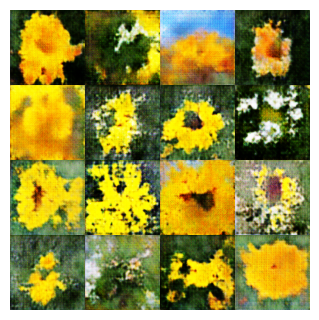

Epoch 14/100 | Iter 19 /189 | D_loss -13.7569 | G_loss 65.2212 | Gradient_Penalty 1.8479 | Gradient_Norm 1.3229 | 
Epoch 14/100 | Iter 38 /189 | D_loss -14.3136 | G_loss 55.9257 | Gradient_Penalty 1.6446 | Gradient_Norm 1.3401 | 
Epoch 14/100 | Iter 57 /189 | D_loss -17.1538 | G_loss 62.6410 | Gradient_Penalty 2.4181 | Gradient_Norm 1.4168 | 
Epoch 14/100 | Iter 76 /189 | D_loss -12.1095 | G_loss 53.1526 | Gradient_Penalty 1.8029 | Gradient_Norm 1.2902 | 
Epoch 14/100 | Iter 95 /189 | D_loss -11.7240 | G_loss 48.6432 | Gradient_Penalty 2.4311 | Gradient_Norm 1.4072 | 
Epoch 14/100 | Iter 114/189 | D_loss -11.9909 | G_loss 62.9718 | Gradient_Penalty 1.9014 | Gradient_Norm 1.3884 | 
Epoch 14/100 | Iter 133/189 | D_loss -15.5234 | G_loss 51.0443 | Gradient_Penalty 1.7166 | Gradient_Norm 1.3174 | 
Epoch 14/100 | Iter 152/189 | D_loss -16.3437 | G_loss 67.1391 | Gradient_Penalty 1.4594 | Gradient_Norm 1.3069 | 
Epoch 14/100 | Iter 171/189 | D_loss -13.0736 | G_loss 49.7839 | Gradient_Penalt

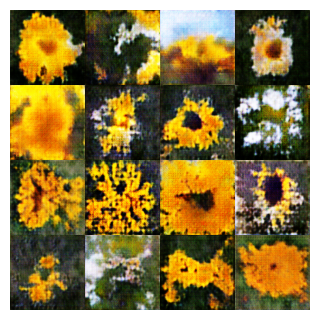

Epoch 15/100 | Iter 19 /189 | D_loss -14.9143 | G_loss 49.7998 | Gradient_Penalty 3.5728 | Gradient_Norm 1.5081 | 
Epoch 15/100 | Iter 38 /189 | D_loss -12.8412 | G_loss 58.2307 | Gradient_Penalty 1.6211 | Gradient_Norm 1.3101 | 
Epoch 15/100 | Iter 57 /189 | D_loss -12.7168 | G_loss 59.2731 | Gradient_Penalty 1.4390 | Gradient_Norm 1.3072 | 
Epoch 15/100 | Iter 76 /189 | D_loss -13.7000 | G_loss 60.8550 | Gradient_Penalty 1.1677 | Gradient_Norm 1.2710 | 
Epoch 15/100 | Iter 95 /189 | D_loss -15.2383 | G_loss 55.7958 | Gradient_Penalty 1.4916 | Gradient_Norm 1.3404 | 
Epoch 15/100 | Iter 114/189 | D_loss -9.8366 | G_loss 56.8385 | Gradient_Penalty 2.5951 | Gradient_Norm 1.3342 | 
Epoch 15/100 | Iter 133/189 | D_loss -13.8202 | G_loss 65.5612 | Gradient_Penalty 1.8587 | Gradient_Norm 1.3716 | 
Epoch 15/100 | Iter 152/189 | D_loss -17.8868 | G_loss 57.9488 | Gradient_Penalty 1.4419 | Gradient_Norm 1.3017 | 
Epoch 15/100 | Iter 171/189 | D_loss -11.8615 | G_loss 72.8408 | Gradient_Penalty

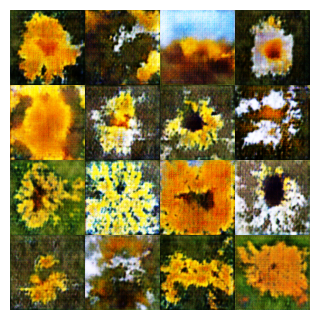

Epoch 16/100 | Iter 19 /189 | D_loss -15.8741 | G_loss 62.4357 | Gradient_Penalty 2.1411 | Gradient_Norm 1.4131 | 
Epoch 16/100 | Iter 38 /189 | D_loss -16.7520 | G_loss 61.9963 | Gradient_Penalty 1.7071 | Gradient_Norm 1.3510 | 
Epoch 16/100 | Iter 57 /189 | D_loss -16.6163 | G_loss 63.4022 | Gradient_Penalty 1.3188 | Gradient_Norm 1.2629 | 
Epoch 16/100 | Iter 76 /189 | D_loss -14.5009 | G_loss 58.0178 | Gradient_Penalty 2.0848 | Gradient_Norm 1.3661 | 
Epoch 16/100 | Iter 95 /189 | D_loss -13.9441 | G_loss 64.3565 | Gradient_Penalty 1.7522 | Gradient_Norm 1.3642 | 
Epoch 16/100 | Iter 114/189 | D_loss -8.6623 | G_loss 72.4692 | Gradient_Penalty 1.1737 | Gradient_Norm 1.2335 | 
Epoch 16/100 | Iter 133/189 | D_loss -11.8006 | G_loss 63.1264 | Gradient_Penalty 3.5652 | Gradient_Norm 1.3856 | 
Epoch 16/100 | Iter 152/189 | D_loss -11.2642 | G_loss 57.7123 | Gradient_Penalty 6.4253 | Gradient_Norm 1.5762 | 
Epoch 16/100 | Iter 171/189 | D_loss -13.6860 | G_loss 62.4106 | Gradient_Penalty

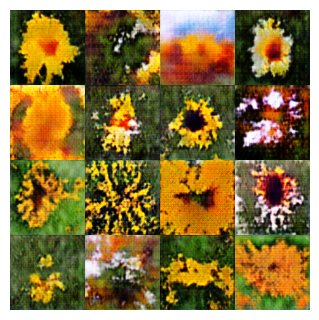

Epoch 17/100 | Iter 19 /189 | D_loss -14.7047 | G_loss 67.8558 | Gradient_Penalty 1.5256 | Gradient_Norm 1.3322 | 
Epoch 17/100 | Iter 38 /189 | D_loss -13.3759 | G_loss 63.3101 | Gradient_Penalty 1.8723 | Gradient_Norm 1.3548 | 
Epoch 17/100 | Iter 57 /189 | D_loss -20.4802 | G_loss 67.1812 | Gradient_Penalty 5.6987 | Gradient_Norm 1.4940 | 
Epoch 17/100 | Iter 76 /189 | D_loss -14.1475 | G_loss 71.8117 | Gradient_Penalty 1.1310 | Gradient_Norm 1.2772 | 
Epoch 17/100 | Iter 95 /189 | D_loss -17.6589 | G_loss 70.3355 | Gradient_Penalty 2.1309 | Gradient_Norm 1.3496 | 
Epoch 17/100 | Iter 114/189 | D_loss -12.8941 | G_loss 64.5994 | Gradient_Penalty 3.2577 | Gradient_Norm 1.4302 | 
Epoch 17/100 | Iter 133/189 | D_loss -20.1628 | G_loss 70.6838 | Gradient_Penalty 2.6352 | Gradient_Norm 1.3984 | 
Epoch 17/100 | Iter 152/189 | D_loss -10.3279 | G_loss 68.7381 | Gradient_Penalty 1.6241 | Gradient_Norm 1.3412 | 
Epoch 17/100 | Iter 171/189 | D_loss -17.1534 | G_loss 63.6776 | Gradient_Penalt

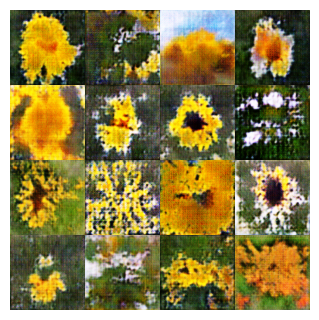

Epoch 18/100 | Iter 19 /189 | D_loss -16.2560 | G_loss 75.7289 | Gradient_Penalty 3.9988 | Gradient_Norm 1.4760 | 
Epoch 18/100 | Iter 38 /189 | D_loss -11.8214 | G_loss 61.8924 | Gradient_Penalty 1.0351 | Gradient_Norm 1.2398 | 
Epoch 18/100 | Iter 57 /189 | D_loss -16.0787 | G_loss 69.1843 | Gradient_Penalty 1.0793 | Gradient_Norm 1.2757 | 
Epoch 18/100 | Iter 76 /189 | D_loss -13.7062 | G_loss 69.6129 | Gradient_Penalty 1.1916 | Gradient_Norm 1.3000 | 
Epoch 18/100 | Iter 95 /189 | D_loss -14.3064 | G_loss 59.9832 | Gradient_Penalty 4.8620 | Gradient_Norm 1.5435 | 
Epoch 18/100 | Iter 114/189 | D_loss -20.6285 | G_loss 59.2681 | Gradient_Penalty 2.8363 | Gradient_Norm 1.4328 | 
Epoch 18/100 | Iter 133/189 | D_loss -18.3827 | G_loss 89.6143 | Gradient_Penalty 3.6442 | Gradient_Norm 1.5203 | 
Epoch 18/100 | Iter 152/189 | D_loss -13.7499 | G_loss 77.8318 | Gradient_Penalty 2.0661 | Gradient_Norm 1.3211 | 
Epoch 18/100 | Iter 171/189 | D_loss -12.0651 | G_loss 67.7146 | Gradient_Penalt

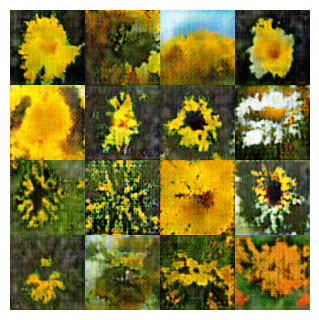

Epoch 19/100 | Iter 19 /189 | D_loss -19.9390 | G_loss 65.7224 | Gradient_Penalty 1.8577 | Gradient_Norm 1.3683 | 
Epoch 19/100 | Iter 38 /189 | D_loss -17.5193 | G_loss 72.2821 | Gradient_Penalty 4.5387 | Gradient_Norm 1.3891 | 
Epoch 19/100 | Iter 57 /189 | D_loss -17.7158 | G_loss 63.0909 | Gradient_Penalty 1.6855 | Gradient_Norm 1.3390 | 
Epoch 19/100 | Iter 76 /189 | D_loss -14.7939 | G_loss 67.8708 | Gradient_Penalty 0.7315 | Gradient_Norm 1.2078 | 
Epoch 19/100 | Iter 95 /189 | D_loss -15.1109 | G_loss 82.8294 | Gradient_Penalty 2.6533 | Gradient_Norm 1.4020 | 
Epoch 19/100 | Iter 114/189 | D_loss -12.5858 | G_loss 65.0537 | Gradient_Penalty 1.0843 | Gradient_Norm 1.2602 | 
Epoch 19/100 | Iter 133/189 | D_loss -17.3219 | G_loss 78.1749 | Gradient_Penalty 2.1660 | Gradient_Norm 1.3517 | 
Epoch 19/100 | Iter 152/189 | D_loss -9.3986 | G_loss 62.2628 | Gradient_Penalty 3.7881 | Gradient_Norm 1.4854 | 
Epoch 19/100 | Iter 171/189 | D_loss -13.6444 | G_loss 69.5006 | Gradient_Penalty

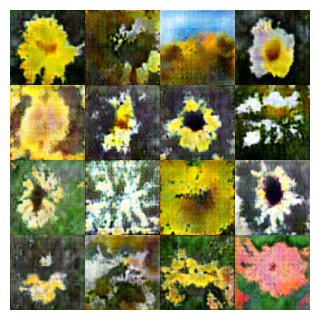

Epoch 20/100 | Iter 19 /189 | D_loss -13.0503 | G_loss 82.5849 | Gradient_Penalty 2.6705 | Gradient_Norm 1.3805 | 
Epoch 20/100 | Iter 38 /189 | D_loss -18.0655 | G_loss 85.3896 | Gradient_Penalty 2.7221 | Gradient_Norm 1.4373 | 
Epoch 20/100 | Iter 57 /189 | D_loss -14.9697 | G_loss 71.8160 | Gradient_Penalty 2.6150 | Gradient_Norm 1.3920 | 
Epoch 20/100 | Iter 76 /189 | D_loss -17.7308 | G_loss 77.7972 | Gradient_Penalty 1.8410 | Gradient_Norm 1.3133 | 
Epoch 20/100 | Iter 95 /189 | D_loss -12.5423 | G_loss 67.1686 | Gradient_Penalty 1.4998 | Gradient_Norm 1.3163 | 
Epoch 20/100 | Iter 114/189 | D_loss -12.2114 | G_loss 71.0051 | Gradient_Penalty 1.3907 | Gradient_Norm 1.2767 | 
Epoch 20/100 | Iter 133/189 | D_loss -16.8075 | G_loss 89.2345 | Gradient_Penalty 2.8244 | Gradient_Norm 1.4523 | 
Epoch 20/100 | Iter 152/189 | D_loss -14.1099 | G_loss 68.7019 | Gradient_Penalty 2.2466 | Gradient_Norm 1.3378 | 
Epoch 20/100 | Iter 171/189 | D_loss -16.6353 | G_loss 74.6882 | Gradient_Penalt

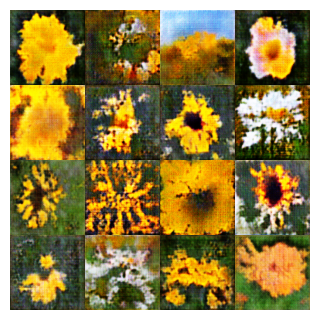

Epoch 21/100 | Iter 19 /189 | D_loss -12.2402 | G_loss 71.5985 | Gradient_Penalty 1.5070 | Gradient_Norm 1.3345 | 
Epoch 21/100 | Iter 38 /189 | D_loss -15.7730 | G_loss 63.3544 | Gradient_Penalty 2.4622 | Gradient_Norm 1.3919 | 
Epoch 21/100 | Iter 57 /189 | D_loss -15.6462 | G_loss 75.0690 | Gradient_Penalty 1.6842 | Gradient_Norm 1.3281 | 
Epoch 21/100 | Iter 76 /189 | D_loss -14.7964 | G_loss 69.5653 | Gradient_Penalty 2.4607 | Gradient_Norm 1.4154 | 
Epoch 21/100 | Iter 95 /189 | D_loss -16.6759 | G_loss 66.1400 | Gradient_Penalty 3.7415 | Gradient_Norm 1.5315 | 
Epoch 21/100 | Iter 114/189 | D_loss -17.3323 | G_loss 86.4161 | Gradient_Penalty 1.3412 | Gradient_Norm 1.2750 | 
Epoch 21/100 | Iter 133/189 | D_loss -12.2996 | G_loss 80.8347 | Gradient_Penalty 4.0115 | Gradient_Norm 1.4757 | 
Epoch 21/100 | Iter 152/189 | D_loss -15.5695 | G_loss 69.1278 | Gradient_Penalty 1.9210 | Gradient_Norm 1.3817 | 
Epoch 21/100 | Iter 171/189 | D_loss -20.3839 | G_loss 84.1254 | Gradient_Penalt

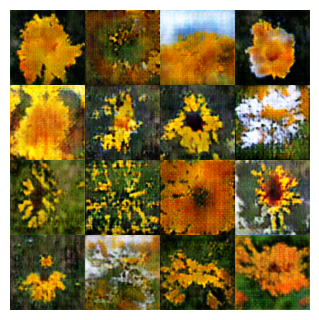

Epoch 22/100 | Iter 19 /189 | D_loss -18.3707 | G_loss 80.3476 | Gradient_Penalty 2.9428 | Gradient_Norm 1.4073 | 
Epoch 22/100 | Iter 38 /189 | D_loss -12.4945 | G_loss 74.6412 | Gradient_Penalty 3.2861 | Gradient_Norm 1.4319 | 
Epoch 22/100 | Iter 57 /189 | D_loss -14.5521 | G_loss 97.0023 | Gradient_Penalty 2.3680 | Gradient_Norm 1.3922 | 
Epoch 22/100 | Iter 76 /189 | D_loss -10.4721 | G_loss 85.7408 | Gradient_Penalty 2.1157 | Gradient_Norm 1.3710 | 
Epoch 22/100 | Iter 95 /189 | D_loss -6.2967 | G_loss 71.3959 | Gradient_Penalty 2.8683 | Gradient_Norm 1.3625 | 
Epoch 22/100 | Iter 114/189 | D_loss -17.1044 | G_loss 83.0302 | Gradient_Penalty 2.0727 | Gradient_Norm 1.3655 | 
Epoch 22/100 | Iter 133/189 | D_loss -20.9419 | G_loss 82.2905 | Gradient_Penalty 3.1264 | Gradient_Norm 1.4501 | 
Epoch 22/100 | Iter 152/189 | D_loss -14.8033 | G_loss 88.9722 | Gradient_Penalty 2.4420 | Gradient_Norm 1.4125 | 
Epoch 22/100 | Iter 171/189 | D_loss -24.0717 | G_loss 69.8351 | Gradient_Penalty

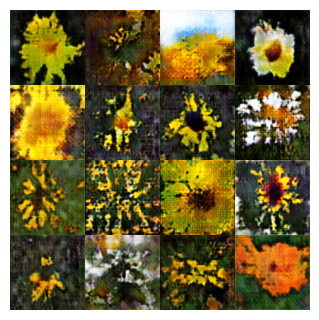

Epoch 23/100 | Iter 19 /189 | D_loss -12.0710 | G_loss 82.2520 | Gradient_Penalty 1.8832 | Gradient_Norm 1.3563 | 
Epoch 23/100 | Iter 38 /189 | D_loss -19.8441 | G_loss 68.4361 | Gradient_Penalty 8.9955 | Gradient_Norm 1.8137 | 
Epoch 23/100 | Iter 57 /189 | D_loss -21.5588 | G_loss 61.7682 | Gradient_Penalty 4.3228 | Gradient_Norm 1.4198 | 
Epoch 23/100 | Iter 76 /189 | D_loss -14.3773 | G_loss 82.5660 | Gradient_Penalty 1.8747 | Gradient_Norm 1.3618 | 
Epoch 23/100 | Iter 95 /189 | D_loss -10.4315 | G_loss 72.3921 | Gradient_Penalty 3.4289 | Gradient_Norm 1.4793 | 
Epoch 23/100 | Iter 114/189 | D_loss -22.4303 | G_loss 70.3736 | Gradient_Penalty 2.5088 | Gradient_Norm 1.3715 | 
Epoch 23/100 | Iter 133/189 | D_loss -18.2930 | G_loss 81.3602 | Gradient_Penalty 2.1321 | Gradient_Norm 1.4058 | 
Epoch 23/100 | Iter 152/189 | D_loss -9.6546 | G_loss 82.5309 | Gradient_Penalty 2.9952 | Gradient_Norm 1.3932 | 
Epoch 23/100 | Iter 171/189 | D_loss -14.5349 | G_loss 74.5630 | Gradient_Penalty

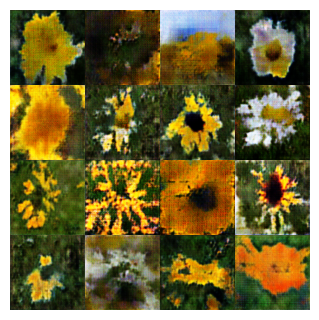

Epoch 24/100 | Iter 19 /189 | D_loss -14.9476 | G_loss 81.2455 | Gradient_Penalty 3.4134 | Gradient_Norm 1.4614 | 
Epoch 24/100 | Iter 38 /189 | D_loss -13.2334 | G_loss 78.7601 | Gradient_Penalty 1.9129 | Gradient_Norm 1.3434 | 
Epoch 24/100 | Iter 57 /189 | D_loss -13.1807 | G_loss 79.6357 | Gradient_Penalty 2.6743 | Gradient_Norm 1.4278 | 
Epoch 24/100 | Iter 76 /189 | D_loss -17.4141 | G_loss 89.5143 | Gradient_Penalty 2.5727 | Gradient_Norm 1.4154 | 
Epoch 24/100 | Iter 95 /189 | D_loss -21.2203 | G_loss 68.9760 | Gradient_Penalty 5.2855 | Gradient_Norm 1.6159 | 
Epoch 24/100 | Iter 114/189 | D_loss -22.1530 | G_loss 71.7840 | Gradient_Penalty 1.5074 | Gradient_Norm 1.2978 | 
Epoch 24/100 | Iter 133/189 | D_loss -17.4131 | G_loss 79.2365 | Gradient_Penalty 4.7616 | Gradient_Norm 1.5699 | 
Epoch 24/100 | Iter 152/189 | D_loss -14.8685 | G_loss 91.2276 | Gradient_Penalty 1.9838 | Gradient_Norm 1.3549 | 
Epoch 24/100 | Iter 171/189 | D_loss -22.8554 | G_loss 80.5507 | Gradient_Penalt

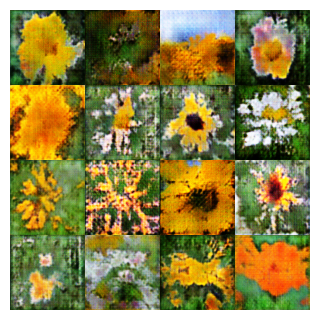

Epoch 25/100 | Iter 19 /189 | D_loss -21.2584 | G_loss 79.5619 | Gradient_Penalty 1.6695 | Gradient_Norm 1.3480 | 
Epoch 25/100 | Iter 38 /189 | D_loss -20.4134 | G_loss 81.5161 | Gradient_Penalty 3.6284 | Gradient_Norm 1.4793 | 
Epoch 25/100 | Iter 57 /189 | D_loss -19.8920 | G_loss 87.3459 | Gradient_Penalty 1.8865 | Gradient_Norm 1.3393 | 
Epoch 25/100 | Iter 76 /189 | D_loss -21.1677 | G_loss 83.3498 | Gradient_Penalty 4.3884 | Gradient_Norm 1.5439 | 
Epoch 25/100 | Iter 95 /189 | D_loss -15.4420 | G_loss 82.0566 | Gradient_Penalty 2.8101 | Gradient_Norm 1.4682 | 
Epoch 25/100 | Iter 114/189 | D_loss -21.0157 | G_loss 85.2386 | Gradient_Penalty 4.3714 | Gradient_Norm 1.5448 | 
Epoch 25/100 | Iter 133/189 | D_loss -19.4883 | G_loss 77.1313 | Gradient_Penalty 2.8332 | Gradient_Norm 1.4011 | 
Epoch 25/100 | Iter 152/189 | D_loss -11.4214 | G_loss 87.7177 | Gradient_Penalty 4.3779 | Gradient_Norm 1.5228 | 
Epoch 25/100 | Iter 171/189 | D_loss -12.9108 | G_loss 77.4956 | Gradient_Penalt

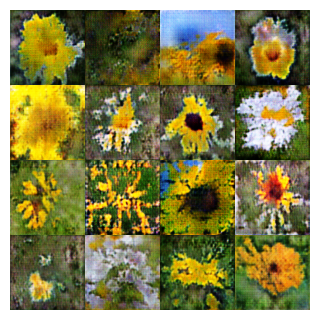

Epoch 26/100 | Iter 19 /189 | D_loss -14.8847 | G_loss 84.2864 | Gradient_Penalty 6.0291 | Gradient_Norm 1.5792 | 
Epoch 26/100 | Iter 38 /189 | D_loss -14.7496 | G_loss 88.8241 | Gradient_Penalty 6.5762 | Gradient_Norm 1.6427 | 
Epoch 26/100 | Iter 57 /189 | D_loss -16.8689 | G_loss 91.6877 | Gradient_Penalty 1.6263 | Gradient_Norm 1.2912 | 
Epoch 26/100 | Iter 76 /189 | D_loss -17.6558 | G_loss 91.2563 | Gradient_Penalty 1.9725 | Gradient_Norm 1.3165 | 
Epoch 26/100 | Iter 95 /189 | D_loss -19.9147 | G_loss 82.8501 | Gradient_Penalty 3.0521 | Gradient_Norm 1.4214 | 
Epoch 26/100 | Iter 114/189 | D_loss -12.6182 | G_loss 88.4646 | Gradient_Penalty 1.7710 | Gradient_Norm 1.3289 | 
Epoch 26/100 | Iter 133/189 | D_loss -11.0693 | G_loss 103.5111 | Gradient_Penalty 2.6573 | Gradient_Norm 1.4007 | 
Epoch 26/100 | Iter 152/189 | D_loss -20.4518 | G_loss 82.5337 | Gradient_Penalty 4.9360 | Gradient_Norm 1.5050 | 
Epoch 26/100 | Iter 171/189 | D_loss -18.7182 | G_loss 108.9286 | Gradient_Pena

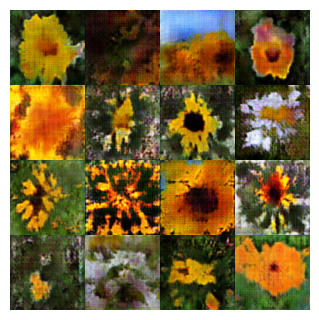

Epoch 27/100 | Iter 19 /189 | D_loss -17.3528 | G_loss 95.2785 | Gradient_Penalty 2.0997 | Gradient_Norm 1.3497 | 
Epoch 27/100 | Iter 38 /189 | D_loss -13.0817 | G_loss 85.8898 | Gradient_Penalty 3.5533 | Gradient_Norm 1.4539 | 
Epoch 27/100 | Iter 57 /189 | D_loss -16.3708 | G_loss 77.5359 | Gradient_Penalty 4.0363 | Gradient_Norm 1.5389 | 
Epoch 27/100 | Iter 76 /189 | D_loss -15.9311 | G_loss 89.8557 | Gradient_Penalty 3.3640 | Gradient_Norm 1.4535 | 
Epoch 27/100 | Iter 95 /189 | D_loss -22.1305 | G_loss 84.8552 | Gradient_Penalty 1.8717 | Gradient_Norm 1.3486 | 
Epoch 27/100 | Iter 114/189 | D_loss -15.0159 | G_loss 79.8357 | Gradient_Penalty 2.6091 | Gradient_Norm 1.4057 | 
Epoch 27/100 | Iter 133/189 | D_loss -15.1813 | G_loss 95.6793 | Gradient_Penalty 3.4217 | Gradient_Norm 1.4614 | 
Epoch 27/100 | Iter 152/189 | D_loss -16.6341 | G_loss 99.2067 | Gradient_Penalty 3.2741 | Gradient_Norm 1.4224 | 
Epoch 27/100 | Iter 171/189 | D_loss -12.2109 | G_loss 94.6755 | Gradient_Penalt

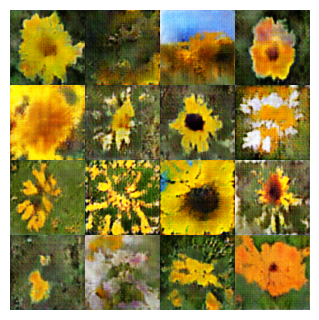

Epoch 28/100 | Iter 19 /189 | D_loss -16.7290 | G_loss 85.4003 | Gradient_Penalty 4.0648 | Gradient_Norm 1.4796 | 
Epoch 28/100 | Iter 38 /189 | D_loss -16.3160 | G_loss 100.7178 | Gradient_Penalty 3.4962 | Gradient_Norm 1.4403 | 
Epoch 28/100 | Iter 57 /189 | D_loss -12.5537 | G_loss 95.3000 | Gradient_Penalty 1.5289 | Gradient_Norm 1.3395 | 
Epoch 28/100 | Iter 76 /189 | D_loss -22.2647 | G_loss 87.0037 | Gradient_Penalty 5.9275 | Gradient_Norm 1.6001 | 
Epoch 28/100 | Iter 95 /189 | D_loss -19.5197 | G_loss 79.2608 | Gradient_Penalty 2.1745 | Gradient_Norm 1.3993 | 
Epoch 28/100 | Iter 114/189 | D_loss -17.1951 | G_loss 93.9125 | Gradient_Penalty 5.3774 | Gradient_Norm 1.5672 | 
Epoch 28/100 | Iter 133/189 | D_loss -10.6011 | G_loss 94.1025 | Gradient_Penalty 3.6086 | Gradient_Norm 1.4821 | 
Epoch 28/100 | Iter 152/189 | D_loss -18.5804 | G_loss 84.4803 | Gradient_Penalty 4.2386 | Gradient_Norm 1.4579 | 
Epoch 28/100 | Iter 171/189 | D_loss -16.9953 | G_loss 92.8529 | Gradient_Penal

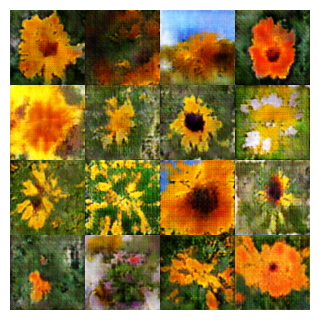

Epoch 29/100 | Iter 19 /189 | D_loss -21.4427 | G_loss 93.3696 | Gradient_Penalty 2.2834 | Gradient_Norm 1.3544 | 
Epoch 29/100 | Iter 38 /189 | D_loss -20.0390 | G_loss 114.1850 | Gradient_Penalty 3.2488 | Gradient_Norm 1.4292 | 
Epoch 29/100 | Iter 57 /189 | D_loss -26.6495 | G_loss 91.6828 | Gradient_Penalty 8.5767 | Gradient_Norm 1.7175 | 
Epoch 29/100 | Iter 76 /189 | D_loss -17.2984 | G_loss 109.2604 | Gradient_Penalty 1.1124 | Gradient_Norm 1.2913 | 
Epoch 29/100 | Iter 95 /189 | D_loss -17.9830 | G_loss 98.9190 | Gradient_Penalty 7.0311 | Gradient_Norm 1.6565 | 
Epoch 29/100 | Iter 114/189 | D_loss -20.2081 | G_loss 102.5026 | Gradient_Penalty 2.3037 | Gradient_Norm 1.3315 | 
Epoch 29/100 | Iter 133/189 | D_loss -22.7500 | G_loss 90.6134 | Gradient_Penalty 6.4374 | Gradient_Norm 1.5538 | 
Epoch 29/100 | Iter 152/189 | D_loss -15.2273 | G_loss 93.7975 | Gradient_Penalty 1.9520 | Gradient_Norm 1.3146 | 
Epoch 29/100 | Iter 171/189 | D_loss -20.4078 | G_loss 90.3984 | Gradient_Pen

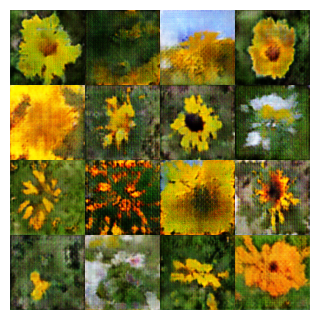

Epoch 30/100 | Iter 19 /189 | D_loss -11.2634 | G_loss 97.0687 | Gradient_Penalty 1.3453 | Gradient_Norm 1.2847 | 
Epoch 30/100 | Iter 38 /189 | D_loss -10.6264 | G_loss 93.0818 | Gradient_Penalty 5.6460 | Gradient_Norm 1.4729 | 
Epoch 30/100 | Iter 57 /189 | D_loss -24.2791 | G_loss 105.0049 | Gradient_Penalty 7.3101 | Gradient_Norm 1.5801 | 
Epoch 30/100 | Iter 76 /189 | D_loss -15.8002 | G_loss 95.7377 | Gradient_Penalty 3.6066 | Gradient_Norm 1.4588 | 
Epoch 30/100 | Iter 95 /189 | D_loss -19.7527 | G_loss 89.3750 | Gradient_Penalty 3.6123 | Gradient_Norm 1.4859 | 
Epoch 30/100 | Iter 114/189 | D_loss -14.5330 | G_loss 100.4863 | Gradient_Penalty 2.7290 | Gradient_Norm 1.3760 | 
Epoch 30/100 | Iter 133/189 | D_loss -17.6047 | G_loss 97.1513 | Gradient_Penalty 5.3316 | Gradient_Norm 1.5464 | 
Epoch 30/100 | Iter 152/189 | D_loss -18.9217 | G_loss 101.1297 | Gradient_Penalty 3.7916 | Gradient_Norm 1.4799 | 
Epoch 30/100 | Iter 171/189 | D_loss -20.2061 | G_loss 98.6775 | Gradient_Pen

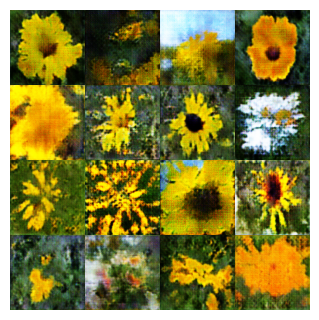

Epoch 31/100 | Iter 19 /189 | D_loss -17.4814 | G_loss 93.8413 | Gradient_Penalty 2.7830 | Gradient_Norm 1.4209 | 
Epoch 31/100 | Iter 38 /189 | D_loss -14.6125 | G_loss 105.0957 | Gradient_Penalty 3.9116 | Gradient_Norm 1.4403 | 
Epoch 31/100 | Iter 57 /189 | D_loss -14.5065 | G_loss 90.7300 | Gradient_Penalty 6.1091 | Gradient_Norm 1.5666 | 
Epoch 31/100 | Iter 76 /189 | D_loss -22.6644 | G_loss 88.4761 | Gradient_Penalty 11.6984 | Gradient_Norm 1.6608 | 
Epoch 31/100 | Iter 95 /189 | D_loss -14.4285 | G_loss 102.0830 | Gradient_Penalty 5.2674 | Gradient_Norm 1.4783 | 
Epoch 31/100 | Iter 114/189 | D_loss -12.6421 | G_loss 111.5443 | Gradient_Penalty 2.2382 | Gradient_Norm 1.3609 | 
Epoch 31/100 | Iter 133/189 | D_loss -13.2127 | G_loss 110.8649 | Gradient_Penalty 5.0112 | Gradient_Norm 1.5758 | 
Epoch 31/100 | Iter 152/189 | D_loss -12.4631 | G_loss 109.0786 | Gradient_Penalty 3.5876 | Gradient_Norm 1.4536 | 
Epoch 31/100 | Iter 171/189 | D_loss -7.0815 | G_loss 100.2044 | Gradient_

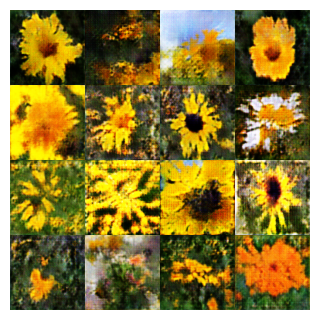

Epoch 32/100 | Iter 19 /189 | D_loss -13.8633 | G_loss 110.9030 | Gradient_Penalty 3.6153 | Gradient_Norm 1.4965 | 
Epoch 32/100 | Iter 38 /189 | D_loss -12.2592 | G_loss 98.7400 | Gradient_Penalty 5.0636 | Gradient_Norm 1.5463 | 
Epoch 32/100 | Iter 57 /189 | D_loss -28.5058 | G_loss 105.4603 | Gradient_Penalty 1.6610 | Gradient_Norm 1.3383 | 
Epoch 32/100 | Iter 76 /189 | D_loss -9.3090 | G_loss 107.5090 | Gradient_Penalty 3.0004 | Gradient_Norm 1.4162 | 
Epoch 32/100 | Iter 95 /189 | D_loss -16.7582 | G_loss 99.7761 | Gradient_Penalty 2.8018 | Gradient_Norm 1.4538 | 
Epoch 32/100 | Iter 114/189 | D_loss -19.6549 | G_loss 105.2576 | Gradient_Penalty 7.2128 | Gradient_Norm 1.5474 | 
Epoch 32/100 | Iter 133/189 | D_loss -18.7724 | G_loss 102.9568 | Gradient_Penalty 4.4582 | Gradient_Norm 1.4775 | 
Epoch 32/100 | Iter 152/189 | D_loss -19.0991 | G_loss 102.6583 | Gradient_Penalty 0.9853 | Gradient_Norm 1.2399 | 
Epoch 32/100 | Iter 171/189 | D_loss -15.9424 | G_loss 112.4574 | Gradient_

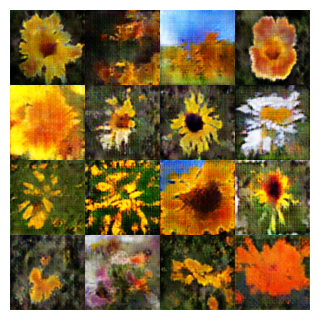

Epoch 33/100 | Iter 19 /189 | D_loss -14.0575 | G_loss 117.2736 | Gradient_Penalty 2.9119 | Gradient_Norm 1.3864 | 
Epoch 33/100 | Iter 38 /189 | D_loss -14.9958 | G_loss 105.8025 | Gradient_Penalty 1.5629 | Gradient_Norm 1.2826 | 
Epoch 33/100 | Iter 57 /189 | D_loss -18.9317 | G_loss 111.7340 | Gradient_Penalty 2.8477 | Gradient_Norm 1.4254 | 
Epoch 33/100 | Iter 76 /189 | D_loss -18.0438 | G_loss 111.2282 | Gradient_Penalty 1.9540 | Gradient_Norm 1.3495 | 
Epoch 33/100 | Iter 95 /189 | D_loss -15.3392 | G_loss 108.9315 | Gradient_Penalty 2.0092 | Gradient_Norm 1.3360 | 
Epoch 33/100 | Iter 114/189 | D_loss -19.4162 | G_loss 96.1483 | Gradient_Penalty 2.6082 | Gradient_Norm 1.4401 | 
Epoch 33/100 | Iter 133/189 | D_loss -24.2449 | G_loss 111.4550 | Gradient_Penalty 8.9299 | Gradient_Norm 1.5410 | 
Epoch 33/100 | Iter 152/189 | D_loss -13.6509 | G_loss 109.7879 | Gradient_Penalty 4.4911 | Gradient_Norm 1.4985 | 
Epoch 33/100 | Iter 171/189 | D_loss -21.7178 | G_loss 106.1198 | Gradien

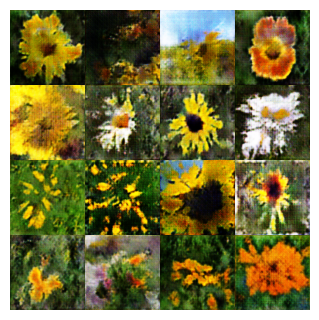

Epoch 34/100 | Iter 19 /189 | D_loss -18.6765 | G_loss 117.5682 | Gradient_Penalty 1.3534 | Gradient_Norm 1.2908 | 
Epoch 34/100 | Iter 38 /189 | D_loss -18.7448 | G_loss 108.0625 | Gradient_Penalty 4.9061 | Gradient_Norm 1.4735 | 
Epoch 34/100 | Iter 57 /189 | D_loss -16.7716 | G_loss 107.9809 | Gradient_Penalty 2.1582 | Gradient_Norm 1.3159 | 
Epoch 34/100 | Iter 76 /189 | D_loss -19.2721 | G_loss 128.6003 | Gradient_Penalty 3.7549 | Gradient_Norm 1.5164 | 
Epoch 34/100 | Iter 95 /189 | D_loss -19.1694 | G_loss 100.6370 | Gradient_Penalty 1.4879 | Gradient_Norm 1.2886 | 
Epoch 34/100 | Iter 114/189 | D_loss -19.0264 | G_loss 103.3368 | Gradient_Penalty 3.5064 | Gradient_Norm 1.4297 | 
Epoch 34/100 | Iter 133/189 | D_loss -18.6666 | G_loss 116.7614 | Gradient_Penalty 2.1242 | Gradient_Norm 1.3711 | 
Epoch 34/100 | Iter 152/189 | D_loss -20.4310 | G_loss 98.8729 | Gradient_Penalty 6.8360 | Gradient_Norm 1.6654 | 
Epoch 34/100 | Iter 171/189 | D_loss -19.5360 | G_loss 114.9298 | Gradien

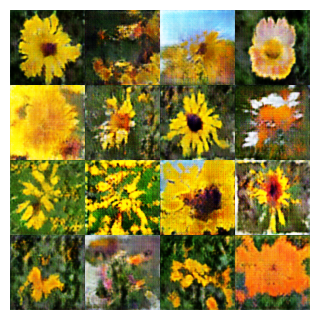

Epoch 35/100 | Iter 19 /189 | D_loss -13.1410 | G_loss 112.8984 | Gradient_Penalty 1.7077 | Gradient_Norm 1.3031 | 
Epoch 35/100 | Iter 38 /189 | D_loss -14.0440 | G_loss 120.7454 | Gradient_Penalty 4.1951 | Gradient_Norm 1.4782 | 
Epoch 35/100 | Iter 57 /189 | D_loss -12.7739 | G_loss 119.6305 | Gradient_Penalty 3.6867 | Gradient_Norm 1.4478 | 
Epoch 35/100 | Iter 76 /189 | D_loss -15.5933 | G_loss 103.6250 | Gradient_Penalty 3.8144 | Gradient_Norm 1.3673 | 
Epoch 35/100 | Iter 95 /189 | D_loss -13.7661 | G_loss 110.1692 | Gradient_Penalty 2.5302 | Gradient_Norm 1.4101 | 
Epoch 35/100 | Iter 114/189 | D_loss -15.9217 | G_loss 114.2188 | Gradient_Penalty 1.4837 | Gradient_Norm 1.2416 | 
Epoch 35/100 | Iter 133/189 | D_loss -16.6245 | G_loss 117.3651 | Gradient_Penalty 3.4990 | Gradient_Norm 1.4488 | 
Epoch 35/100 | Iter 152/189 | D_loss -17.3376 | G_loss 98.8142 | Gradient_Penalty 6.6204 | Gradient_Norm 1.5325 | 
Epoch 35/100 | Iter 171/189 | D_loss -25.0256 | G_loss 109.4818 | Gradien

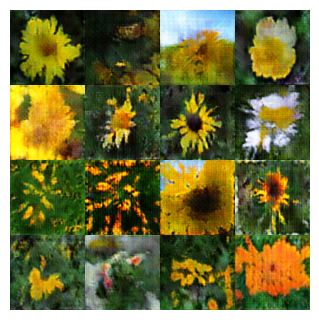

Epoch 36/100 | Iter 19 /189 | D_loss -17.0853 | G_loss 112.3860 | Gradient_Penalty 2.2686 | Gradient_Norm 1.4091 | 
Epoch 36/100 | Iter 38 /189 | D_loss -17.6103 | G_loss 96.7376 | Gradient_Penalty 7.9523 | Gradient_Norm 1.5501 | 
Epoch 36/100 | Iter 57 /189 | D_loss -12.9281 | G_loss 105.7878 | Gradient_Penalty 2.1157 | Gradient_Norm 1.3576 | 
Epoch 36/100 | Iter 76 /189 | D_loss -9.9451 | G_loss 118.2538 | Gradient_Penalty 4.9004 | Gradient_Norm 1.4992 | 
Epoch 36/100 | Iter 95 /189 | D_loss -20.5717 | G_loss 106.4600 | Gradient_Penalty 2.5675 | Gradient_Norm 1.3310 | 
Epoch 36/100 | Iter 114/189 | D_loss -19.4697 | G_loss 104.9979 | Gradient_Penalty 8.8285 | Gradient_Norm 1.6119 | 
Epoch 36/100 | Iter 133/189 | D_loss -14.7694 | G_loss 117.6563 | Gradient_Penalty 2.3249 | Gradient_Norm 1.3541 | 
Epoch 36/100 | Iter 152/189 | D_loss -22.0858 | G_loss 105.0916 | Gradient_Penalty 7.2419 | Gradient_Norm 1.6350 | 
Epoch 36/100 | Iter 171/189 | D_loss -9.5874 | G_loss 125.8073 | Gradient_

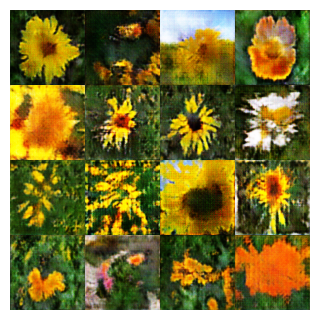

Epoch 37/100 | Iter 19 /189 | D_loss -10.6447 | G_loss 118.9093 | Gradient_Penalty 8.5546 | Gradient_Norm 1.6599 | 
Epoch 37/100 | Iter 38 /189 | D_loss -20.7253 | G_loss 108.4636 | Gradient_Penalty 4.6198 | Gradient_Norm 1.5339 | 
Epoch 37/100 | Iter 57 /189 | D_loss -20.3133 | G_loss 103.8617 | Gradient_Penalty 2.2831 | Gradient_Norm 1.3460 | 
Epoch 37/100 | Iter 76 /189 | D_loss -12.1759 | G_loss 118.7118 | Gradient_Penalty 1.3136 | Gradient_Norm 1.2956 | 
Epoch 37/100 | Iter 95 /189 | D_loss -19.3704 | G_loss 115.8878 | Gradient_Penalty 2.6271 | Gradient_Norm 1.3876 | 
Epoch 37/100 | Iter 114/189 | D_loss -11.0895 | G_loss 117.3088 | Gradient_Penalty 2.9194 | Gradient_Norm 1.3783 | 
Epoch 37/100 | Iter 133/189 | D_loss -16.1269 | G_loss 115.3803 | Gradient_Penalty 2.4689 | Gradient_Norm 1.4023 | 
Epoch 37/100 | Iter 152/189 | D_loss -23.8989 | G_loss 118.4716 | Gradient_Penalty 4.6809 | Gradient_Norm 1.4932 | 
Epoch 37/100 | Iter 171/189 | D_loss -19.8732 | G_loss 106.6379 | Gradie

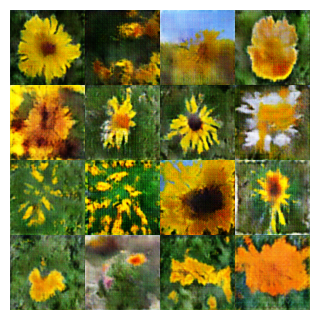

Epoch 38/100 | Iter 19 /189 | D_loss -17.1288 | G_loss 130.5812 | Gradient_Penalty 1.7022 | Gradient_Norm 1.3197 | 
Epoch 38/100 | Iter 38 /189 | D_loss -16.9209 | G_loss 116.0364 | Gradient_Penalty 2.8422 | Gradient_Norm 1.3986 | 
Epoch 38/100 | Iter 57 /189 | D_loss -21.7107 | G_loss 121.7105 | Gradient_Penalty 7.5526 | Gradient_Norm 1.4916 | 
Epoch 38/100 | Iter 76 /189 | D_loss -26.6650 | G_loss 114.1396 | Gradient_Penalty 2.6768 | Gradient_Norm 1.4062 | 
Epoch 38/100 | Iter 95 /189 | D_loss -19.9929 | G_loss 116.4170 | Gradient_Penalty 7.9782 | Gradient_Norm 1.5751 | 
Epoch 38/100 | Iter 114/189 | D_loss -11.6666 | G_loss 117.9782 | Gradient_Penalty 2.8216 | Gradient_Norm 1.4346 | 
Epoch 38/100 | Iter 133/189 | D_loss -19.7817 | G_loss 106.1003 | Gradient_Penalty 3.8220 | Gradient_Norm 1.4430 | 
Epoch 38/100 | Iter 152/189 | D_loss -12.2042 | G_loss 123.6884 | Gradient_Penalty 3.0199 | Gradient_Norm 1.4222 | 
Epoch 38/100 | Iter 171/189 | D_loss -20.0376 | G_loss 118.4783 | Gradie

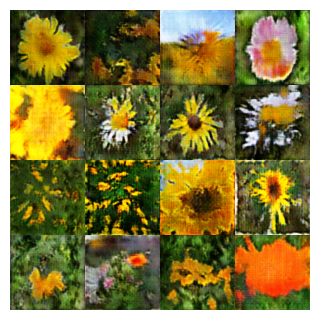

Epoch 39/100 | Iter 19 /189 | D_loss -16.5838 | G_loss 107.9972 | Gradient_Penalty 3.8775 | Gradient_Norm 1.4272 | 
Epoch 39/100 | Iter 38 /189 | D_loss -18.8596 | G_loss 112.9845 | Gradient_Penalty 5.1941 | Gradient_Norm 1.5263 | 
Epoch 39/100 | Iter 57 /189 | D_loss -20.8128 | G_loss 115.2209 | Gradient_Penalty 3.4702 | Gradient_Norm 1.4514 | 
Epoch 39/100 | Iter 76 /189 | D_loss -19.9836 | G_loss 102.5710 | Gradient_Penalty 2.3297 | Gradient_Norm 1.3996 | 
Epoch 39/100 | Iter 95 /189 | D_loss -24.9082 | G_loss 112.7759 | Gradient_Penalty 1.6728 | Gradient_Norm 1.2870 | 
Epoch 39/100 | Iter 114/189 | D_loss -14.2991 | G_loss 106.2400 | Gradient_Penalty 1.8810 | Gradient_Norm 1.3117 | 
Epoch 39/100 | Iter 133/189 | D_loss -13.2355 | G_loss 115.4850 | Gradient_Penalty 0.9513 | Gradient_Norm 1.2584 | 
Epoch 39/100 | Iter 152/189 | D_loss -20.5146 | G_loss 129.1130 | Gradient_Penalty 2.2902 | Gradient_Norm 1.3375 | 
Epoch 39/100 | Iter 171/189 | D_loss -17.3322 | G_loss 123.9618 | Gradie

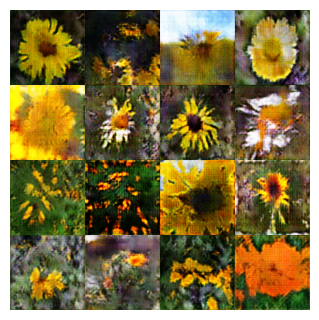

Epoch 40/100 | Iter 19 /189 | D_loss -11.6875 | G_loss 106.1706 | Gradient_Penalty 5.7376 | Gradient_Norm 1.6048 | 
Epoch 40/100 | Iter 38 /189 | D_loss -22.3531 | G_loss 109.0696 | Gradient_Penalty 3.2068 | Gradient_Norm 1.4402 | 
Epoch 40/100 | Iter 57 /189 | D_loss -17.3808 | G_loss 115.7211 | Gradient_Penalty 4.0815 | Gradient_Norm 1.4852 | 
Epoch 40/100 | Iter 76 /189 | D_loss -14.0955 | G_loss 119.4794 | Gradient_Penalty 1.2080 | Gradient_Norm 1.2888 | 
Epoch 40/100 | Iter 95 /189 | D_loss -14.2705 | G_loss 117.8651 | Gradient_Penalty 7.7405 | Gradient_Norm 1.5185 | 
Epoch 40/100 | Iter 114/189 | D_loss -21.5491 | G_loss 117.5068 | Gradient_Penalty 6.8620 | Gradient_Norm 1.6269 | 
Epoch 40/100 | Iter 133/189 | D_loss -14.2760 | G_loss 117.0408 | Gradient_Penalty 2.0765 | Gradient_Norm 1.3396 | 
Epoch 40/100 | Iter 152/189 | D_loss -20.9110 | G_loss 106.7290 | Gradient_Penalty 2.0616 | Gradient_Norm 1.3604 | 
Epoch 40/100 | Iter 171/189 | D_loss -17.7331 | G_loss 121.7026 | Gradie

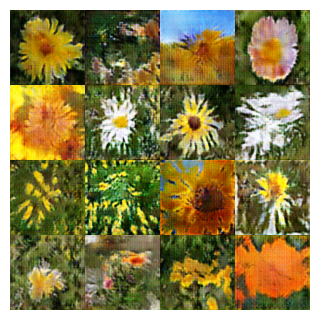

Epoch 41/100 | Iter 19 /189 | D_loss -18.6822 | G_loss 111.3752 | Gradient_Penalty 5.5238 | Gradient_Norm 1.5611 | 
Epoch 41/100 | Iter 38 /189 | D_loss -14.9722 | G_loss 111.1009 | Gradient_Penalty 2.3223 | Gradient_Norm 1.3860 | 
Epoch 41/100 | Iter 57 /189 | D_loss -13.4603 | G_loss 121.6819 | Gradient_Penalty 2.8235 | Gradient_Norm 1.3210 | 
Epoch 41/100 | Iter 76 /189 | D_loss -25.8705 | G_loss 116.3568 | Gradient_Penalty 3.3197 | Gradient_Norm 1.4494 | 
Epoch 41/100 | Iter 95 /189 | D_loss -15.9551 | G_loss 133.1767 | Gradient_Penalty 2.5363 | Gradient_Norm 1.3476 | 
Epoch 41/100 | Iter 114/189 | D_loss -10.8921 | G_loss 117.7299 | Gradient_Penalty 1.9853 | Gradient_Norm 1.3422 | 
Epoch 41/100 | Iter 133/189 | D_loss -24.7849 | G_loss 117.3243 | Gradient_Penalty 1.4829 | Gradient_Norm 1.3128 | 
Epoch 41/100 | Iter 152/189 | D_loss -19.4673 | G_loss 100.8219 | Gradient_Penalty 4.1218 | Gradient_Norm 1.5574 | 
Epoch 41/100 | Iter 171/189 | D_loss -15.5728 | G_loss 115.1992 | Gradie

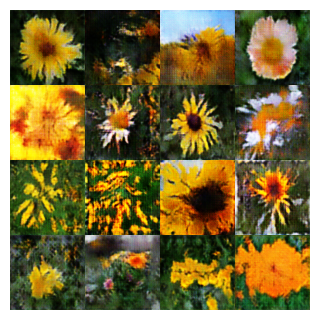

Epoch 42/100 | Iter 19 /189 | D_loss -22.2478 | G_loss 118.9934 | Gradient_Penalty 2.1000 | Gradient_Norm 1.3538 | 
Epoch 42/100 | Iter 38 /189 | D_loss -14.0375 | G_loss 116.1321 | Gradient_Penalty 2.3738 | Gradient_Norm 1.3775 | 
Epoch 42/100 | Iter 57 /189 | D_loss -14.3566 | G_loss 126.2477 | Gradient_Penalty 2.9086 | Gradient_Norm 1.4279 | 
Epoch 42/100 | Iter 76 /189 | D_loss -18.7341 | G_loss 120.4983 | Gradient_Penalty 1.6684 | Gradient_Norm 1.2998 | 
Epoch 42/100 | Iter 95 /189 | D_loss -14.9330 | G_loss 135.5290 | Gradient_Penalty 3.4910 | Gradient_Norm 1.4491 | 
Epoch 42/100 | Iter 114/189 | D_loss -15.9266 | G_loss 122.2266 | Gradient_Penalty 2.6876 | Gradient_Norm 1.3948 | 
Epoch 42/100 | Iter 133/189 | D_loss -12.4989 | G_loss 120.7408 | Gradient_Penalty 4.2710 | Gradient_Norm 1.4743 | 
Epoch 42/100 | Iter 152/189 | D_loss -16.3168 | G_loss 119.0047 | Gradient_Penalty 2.5947 | Gradient_Norm 1.4095 | 
Epoch 42/100 | Iter 171/189 | D_loss -16.7348 | G_loss 118.4076 | Gradie

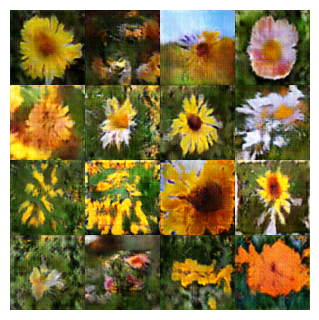

Epoch 43/100 | Iter 19 /189 | D_loss -11.1852 | G_loss 121.2839 | Gradient_Penalty 2.5249 | Gradient_Norm 1.3792 | 
Epoch 43/100 | Iter 38 /189 | D_loss -16.3460 | G_loss 110.4688 | Gradient_Penalty 4.8841 | Gradient_Norm 1.5276 | 
Epoch 43/100 | Iter 57 /189 | D_loss -14.2038 | G_loss 114.8683 | Gradient_Penalty 1.3880 | Gradient_Norm 1.3075 | 
Epoch 43/100 | Iter 76 /189 | D_loss -15.3334 | G_loss 121.6775 | Gradient_Penalty 3.2522 | Gradient_Norm 1.4167 | 
Epoch 43/100 | Iter 95 /189 | D_loss -20.7273 | G_loss 120.0260 | Gradient_Penalty 3.7904 | Gradient_Norm 1.4542 | 
Epoch 43/100 | Iter 114/189 | D_loss -19.0779 | G_loss 105.0346 | Gradient_Penalty 3.6253 | Gradient_Norm 1.4987 | 
Epoch 43/100 | Iter 133/189 | D_loss -16.5134 | G_loss 129.8520 | Gradient_Penalty 2.0189 | Gradient_Norm 1.3459 | 
Epoch 43/100 | Iter 152/189 | D_loss -17.5152 | G_loss 122.1207 | Gradient_Penalty 5.7129 | Gradient_Norm 1.4810 | 
Epoch 43/100 | Iter 171/189 | D_loss -12.9904 | G_loss 128.4105 | Gradie

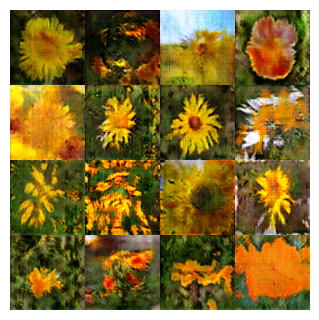

Epoch 44/100 | Iter 19 /189 | D_loss -17.2762 | G_loss 122.7069 | Gradient_Penalty 2.4063 | Gradient_Norm 1.3787 | 
Epoch 44/100 | Iter 38 /189 | D_loss -22.1955 | G_loss 116.1553 | Gradient_Penalty 6.1546 | Gradient_Norm 1.6005 | 
Epoch 44/100 | Iter 57 /189 | D_loss -16.0027 | G_loss 131.6091 | Gradient_Penalty 5.3667 | Gradient_Norm 1.5515 | 
Epoch 44/100 | Iter 76 /189 | D_loss -17.7529 | G_loss 126.3604 | Gradient_Penalty 2.4260 | Gradient_Norm 1.3967 | 
Epoch 44/100 | Iter 95 /189 | D_loss -21.1825 | G_loss 108.2745 | Gradient_Penalty 10.1086 | Gradient_Norm 1.7871 | 
Epoch 44/100 | Iter 114/189 | D_loss -14.5568 | G_loss 134.1800 | Gradient_Penalty 3.8071 | Gradient_Norm 1.4860 | 
Epoch 44/100 | Iter 133/189 | D_loss -16.1470 | G_loss 135.0466 | Gradient_Penalty 1.9286 | Gradient_Norm 1.3820 | 
Epoch 44/100 | Iter 152/189 | D_loss -21.3649 | G_loss 120.7637 | Gradient_Penalty 2.8246 | Gradient_Norm 1.4491 | 
Epoch 44/100 | Iter 171/189 | D_loss -18.3103 | G_loss 110.7666 | Gradi

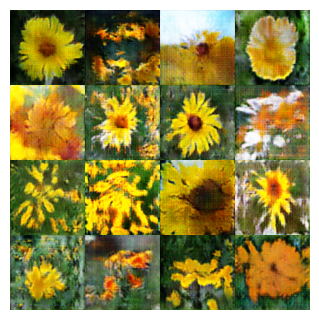

Epoch 45/100 | Iter 19 /189 | D_loss -16.3282 | G_loss 115.4205 | Gradient_Penalty 4.7851 | Gradient_Norm 1.5258 | 
Epoch 45/100 | Iter 38 /189 | D_loss -17.1279 | G_loss 116.5735 | Gradient_Penalty 2.5891 | Gradient_Norm 1.3759 | 
Epoch 45/100 | Iter 57 /189 | D_loss -20.8911 | G_loss 121.9806 | Gradient_Penalty 4.5435 | Gradient_Norm 1.5201 | 
Epoch 45/100 | Iter 76 /189 | D_loss -9.9516 | G_loss 126.6000 | Gradient_Penalty 2.1263 | Gradient_Norm 1.3807 | 
Epoch 45/100 | Iter 95 /189 | D_loss -9.2341 | G_loss 122.2105 | Gradient_Penalty 16.3068 | Gradient_Norm 1.6899 | 
Epoch 45/100 | Iter 114/189 | D_loss -15.9455 | G_loss 126.0592 | Gradient_Penalty 3.8654 | Gradient_Norm 1.4465 | 
Epoch 45/100 | Iter 133/189 | D_loss -14.8817 | G_loss 139.4406 | Gradient_Penalty 3.5340 | Gradient_Norm 1.4244 | 
Epoch 45/100 | Iter 152/189 | D_loss -17.3507 | G_loss 123.0820 | Gradient_Penalty 6.1548 | Gradient_Norm 1.5103 | 
Epoch 45/100 | Iter 171/189 | D_loss -22.8354 | G_loss 114.3335 | Gradien

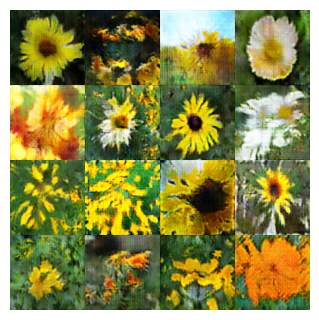

Epoch 46/100 | Iter 19 /189 | D_loss -18.4487 | G_loss 138.8387 | Gradient_Penalty 3.4343 | Gradient_Norm 1.4306 | 
Epoch 46/100 | Iter 38 /189 | D_loss -16.7344 | G_loss 136.8061 | Gradient_Penalty 1.3960 | Gradient_Norm 1.2471 | 
Epoch 46/100 | Iter 57 /189 | D_loss -17.8954 | G_loss 133.6376 | Gradient_Penalty 5.2169 | Gradient_Norm 1.4395 | 
Epoch 46/100 | Iter 76 /189 | D_loss -13.5498 | G_loss 131.0059 | Gradient_Penalty 3.0833 | Gradient_Norm 1.4779 | 
Epoch 46/100 | Iter 95 /189 | D_loss -22.7076 | G_loss 126.5547 | Gradient_Penalty 9.9968 | Gradient_Norm 1.5559 | 
Epoch 46/100 | Iter 114/189 | D_loss -14.9790 | G_loss 125.2084 | Gradient_Penalty 1.6387 | Gradient_Norm 1.3289 | 
Epoch 46/100 | Iter 133/189 | D_loss -18.1911 | G_loss 122.8030 | Gradient_Penalty 3.3641 | Gradient_Norm 1.4445 | 
Epoch 46/100 | Iter 152/189 | D_loss -27.7392 | G_loss 127.1197 | Gradient_Penalty 4.6072 | Gradient_Norm 1.4189 | 
Epoch 46/100 | Iter 171/189 | D_loss -15.3915 | G_loss 126.0325 | Gradie

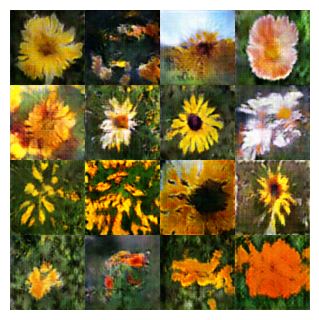

Epoch 47/100 | Iter 19 /189 | D_loss -22.4814 | G_loss 114.4622 | Gradient_Penalty 3.1045 | Gradient_Norm 1.4086 | 
Epoch 47/100 | Iter 38 /189 | D_loss -22.4644 | G_loss 117.0959 | Gradient_Penalty 3.0196 | Gradient_Norm 1.4247 | 
Epoch 47/100 | Iter 57 /189 | D_loss -17.8313 | G_loss 125.8279 | Gradient_Penalty 1.9980 | Gradient_Norm 1.3482 | 
Epoch 47/100 | Iter 76 /189 | D_loss -11.8033 | G_loss 134.9212 | Gradient_Penalty 2.0198 | Gradient_Norm 1.3712 | 
Epoch 47/100 | Iter 95 /189 | D_loss -14.7097 | G_loss 124.4150 | Gradient_Penalty 1.6063 | Gradient_Norm 1.3386 | 
Epoch 47/100 | Iter 114/189 | D_loss -20.3996 | G_loss 133.7598 | Gradient_Penalty 4.0526 | Gradient_Norm 1.4887 | 
Epoch 47/100 | Iter 133/189 | D_loss -11.3254 | G_loss 130.3153 | Gradient_Penalty 5.9807 | Gradient_Norm 1.5194 | 
Epoch 47/100 | Iter 152/189 | D_loss -11.4227 | G_loss 138.8570 | Gradient_Penalty 4.8489 | Gradient_Norm 1.4322 | 
Epoch 47/100 | Iter 171/189 | D_loss -15.9034 | G_loss 132.0623 | Gradie

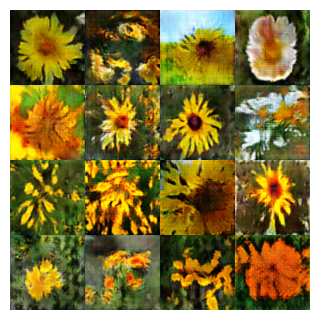

Epoch 48/100 | Iter 19 /189 | D_loss -24.0086 | G_loss 118.9789 | Gradient_Penalty 2.3074 | Gradient_Norm 1.2742 | 
Epoch 48/100 | Iter 38 /189 | D_loss -12.1780 | G_loss 130.4995 | Gradient_Penalty 2.4850 | Gradient_Norm 1.3951 | 
Epoch 48/100 | Iter 57 /189 | D_loss -11.5336 | G_loss 125.4871 | Gradient_Penalty 2.1007 | Gradient_Norm 1.3568 | 
Epoch 48/100 | Iter 76 /189 | D_loss -13.2082 | G_loss 140.4786 | Gradient_Penalty 2.5792 | Gradient_Norm 1.3691 | 
Epoch 48/100 | Iter 95 /189 | D_loss -9.2751 | G_loss 138.4630 | Gradient_Penalty 5.4357 | Gradient_Norm 1.4967 | 
Epoch 48/100 | Iter 114/189 | D_loss -14.2769 | G_loss 143.6123 | Gradient_Penalty 13.2878 | Gradient_Norm 1.6602 | 
Epoch 48/100 | Iter 133/189 | D_loss -16.2080 | G_loss 130.7916 | Gradient_Penalty 2.3520 | Gradient_Norm 1.3562 | 
Epoch 48/100 | Iter 152/189 | D_loss -20.1978 | G_loss 134.8275 | Gradient_Penalty 3.1264 | Gradient_Norm 1.4319 | 
Epoch 48/100 | Iter 171/189 | D_loss -17.3185 | G_loss 129.4966 | Gradie

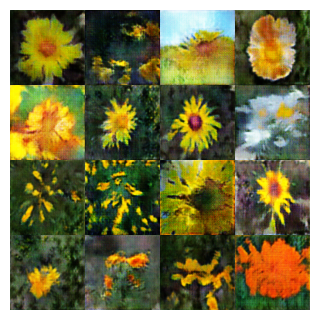

Epoch 49/100 | Iter 19 /189 | D_loss -17.4067 | G_loss 137.1467 | Gradient_Penalty 6.9570 | Gradient_Norm 1.5961 | 
Epoch 49/100 | Iter 38 /189 | D_loss -19.6635 | G_loss 145.2037 | Gradient_Penalty 4.5002 | Gradient_Norm 1.5151 | 
Epoch 49/100 | Iter 57 /189 | D_loss -17.3598 | G_loss 134.4686 | Gradient_Penalty 2.2740 | Gradient_Norm 1.3513 | 
Epoch 49/100 | Iter 76 /189 | D_loss -21.1707 | G_loss 136.0056 | Gradient_Penalty 2.4828 | Gradient_Norm 1.4079 | 
Epoch 49/100 | Iter 95 /189 | D_loss -20.9842 | G_loss 127.3431 | Gradient_Penalty 1.5014 | Gradient_Norm 1.3259 | 
Epoch 49/100 | Iter 114/189 | D_loss -17.5427 | G_loss 133.0317 | Gradient_Penalty 4.7747 | Gradient_Norm 1.5091 | 
Epoch 49/100 | Iter 133/189 | D_loss -20.0151 | G_loss 142.6636 | Gradient_Penalty 3.9678 | Gradient_Norm 1.4316 | 
Epoch 49/100 | Iter 152/189 | D_loss -19.4097 | G_loss 120.8994 | Gradient_Penalty 5.9198 | Gradient_Norm 1.4762 | 
Epoch 49/100 | Iter 171/189 | D_loss -19.8355 | G_loss 130.0679 | Gradie

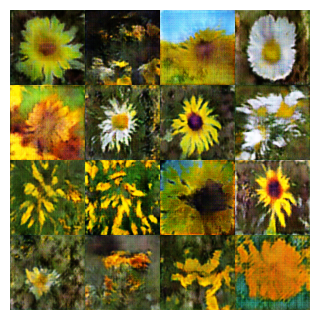

Epoch 50/100 | Iter 19 /189 | D_loss -22.4445 | G_loss 128.8468 | Gradient_Penalty 2.9884 | Gradient_Norm 1.3644 | 
Epoch 50/100 | Iter 38 /189 | D_loss -20.4248 | G_loss 139.4388 | Gradient_Penalty 9.6333 | Gradient_Norm 1.7316 | 
Epoch 50/100 | Iter 57 /189 | D_loss -11.6202 | G_loss 141.9428 | Gradient_Penalty 2.6105 | Gradient_Norm 1.4229 | 
Epoch 50/100 | Iter 76 /189 | D_loss -14.1454 | G_loss 127.6765 | Gradient_Penalty 2.9302 | Gradient_Norm 1.4570 | 
Epoch 50/100 | Iter 95 /189 | D_loss -21.8120 | G_loss 147.6840 | Gradient_Penalty 2.8994 | Gradient_Norm 1.4197 | 
Epoch 50/100 | Iter 114/189 | D_loss -17.8585 | G_loss 130.3193 | Gradient_Penalty 10.3983 | Gradient_Norm 1.5593 | 
Epoch 50/100 | Iter 133/189 | D_loss -17.7959 | G_loss 138.5108 | Gradient_Penalty 2.8642 | Gradient_Norm 1.4261 | 
Epoch 50/100 | Iter 152/189 | D_loss -20.6968 | G_loss 143.3314 | Gradient_Penalty 1.9396 | Gradient_Norm 1.3213 | 
Epoch 50/100 | Iter 171/189 | D_loss -16.1516 | G_loss 136.8589 | Gradi

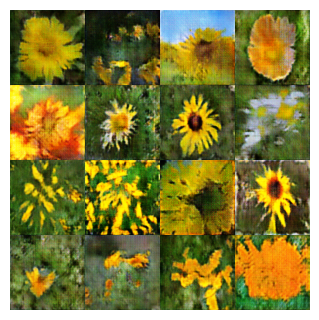

Epoch 51/100 | Iter 19 /189 | D_loss -15.9859 | G_loss 140.5007 | Gradient_Penalty 3.4893 | Gradient_Norm 1.4524 | 
Epoch 51/100 | Iter 38 /189 | D_loss -22.6495 | G_loss 152.5650 | Gradient_Penalty 1.9001 | Gradient_Norm 1.3791 | 
Epoch 51/100 | Iter 57 /189 | D_loss -18.2411 | G_loss 126.5206 | Gradient_Penalty 4.0463 | Gradient_Norm 1.5020 | 
Epoch 51/100 | Iter 76 /189 | D_loss -14.0530 | G_loss 146.9253 | Gradient_Penalty 3.0760 | Gradient_Norm 1.4267 | 
Epoch 51/100 | Iter 95 /189 | D_loss -17.8987 | G_loss 124.1248 | Gradient_Penalty 12.1005 | Gradient_Norm 1.6450 | 
Epoch 51/100 | Iter 114/189 | D_loss -19.6628 | G_loss 140.6523 | Gradient_Penalty 4.7302 | Gradient_Norm 1.5607 | 
Epoch 51/100 | Iter 133/189 | D_loss -21.6122 | G_loss 133.0179 | Gradient_Penalty 3.3176 | Gradient_Norm 1.4582 | 
Epoch 51/100 | Iter 152/189 | D_loss -17.6480 | G_loss 124.1822 | Gradient_Penalty 2.7365 | Gradient_Norm 1.3979 | 
Epoch 51/100 | Iter 171/189 | D_loss -12.8862 | G_loss 135.6268 | Gradi

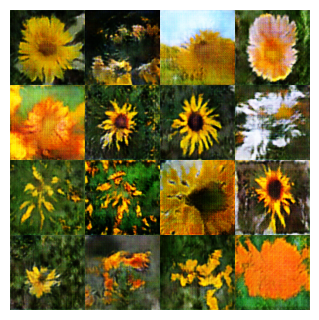

Epoch 52/100 | Iter 19 /189 | D_loss -13.8986 | G_loss 134.9909 | Gradient_Penalty 3.3851 | Gradient_Norm 1.3896 | 
Epoch 52/100 | Iter 38 /189 | D_loss -32.2181 | G_loss 137.8980 | Gradient_Penalty 4.9556 | Gradient_Norm 1.5870 | 
Epoch 52/100 | Iter 57 /189 | D_loss -21.1754 | G_loss 128.1039 | Gradient_Penalty 2.1755 | Gradient_Norm 1.4017 | 
Epoch 52/100 | Iter 76 /189 | D_loss -15.3261 | G_loss 142.7726 | Gradient_Penalty 4.2131 | Gradient_Norm 1.4395 | 
Epoch 52/100 | Iter 95 /189 | D_loss -8.3037 | G_loss 144.5164 | Gradient_Penalty 2.3626 | Gradient_Norm 1.3382 | 
Epoch 52/100 | Iter 114/189 | D_loss -18.7014 | G_loss 121.2500 | Gradient_Penalty 4.4365 | Gradient_Norm 1.5463 | 
Epoch 52/100 | Iter 133/189 | D_loss -20.9635 | G_loss 133.6788 | Gradient_Penalty 3.5220 | Gradient_Norm 1.4406 | 
Epoch 52/100 | Iter 152/189 | D_loss -15.4586 | G_loss 145.7596 | Gradient_Penalty 1.8446 | Gradient_Norm 1.3486 | 
Epoch 52/100 | Iter 171/189 | D_loss -15.3635 | G_loss 135.3479 | Gradien

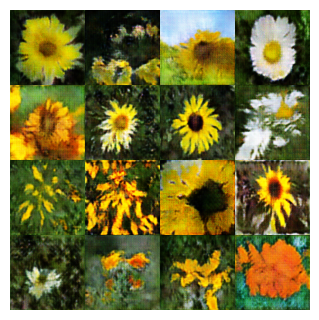

Epoch 53/100 | Iter 19 /189 | D_loss -10.2110 | G_loss 144.5751 | Gradient_Penalty 4.3279 | Gradient_Norm 1.4902 | 
Epoch 53/100 | Iter 38 /189 | D_loss -16.0165 | G_loss 131.9529 | Gradient_Penalty 2.3906 | Gradient_Norm 1.3012 | 
Epoch 53/100 | Iter 57 /189 | D_loss -28.3282 | G_loss 151.9056 | Gradient_Penalty 3.0524 | Gradient_Norm 1.4163 | 
Epoch 53/100 | Iter 76 /189 | D_loss -18.3953 | G_loss 133.2649 | Gradient_Penalty 2.5089 | Gradient_Norm 1.4003 | 
Epoch 53/100 | Iter 95 /189 | D_loss -24.4240 | G_loss 140.4989 | Gradient_Penalty 2.2471 | Gradient_Norm 1.3921 | 
Epoch 53/100 | Iter 114/189 | D_loss -22.1144 | G_loss 138.8886 | Gradient_Penalty 3.2734 | Gradient_Norm 1.3807 | 
Epoch 53/100 | Iter 133/189 | D_loss -18.1377 | G_loss 136.1035 | Gradient_Penalty 2.5265 | Gradient_Norm 1.3741 | 
Epoch 53/100 | Iter 152/189 | D_loss -20.3782 | G_loss 137.8508 | Gradient_Penalty 3.6000 | Gradient_Norm 1.4782 | 
Epoch 53/100 | Iter 171/189 | D_loss -18.0050 | G_loss 137.4919 | Gradie

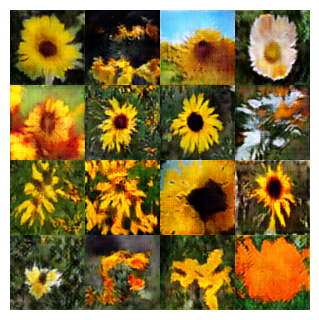

Epoch 54/100 | Iter 19 /189 | D_loss -20.0331 | G_loss 136.2340 | Gradient_Penalty 7.4824 | Gradient_Norm 1.6477 | 
Epoch 54/100 | Iter 38 /189 | D_loss -16.6589 | G_loss 152.8759 | Gradient_Penalty 4.0735 | Gradient_Norm 1.4498 | 
Epoch 54/100 | Iter 57 /189 | D_loss -15.7653 | G_loss 146.5564 | Gradient_Penalty 2.3605 | Gradient_Norm 1.3919 | 
Epoch 54/100 | Iter 76 /189 | D_loss -20.6492 | G_loss 137.1794 | Gradient_Penalty 8.3263 | Gradient_Norm 1.4706 | 
Epoch 54/100 | Iter 95 /189 | D_loss -25.3166 | G_loss 142.2699 | Gradient_Penalty 2.2314 | Gradient_Norm 1.3611 | 
Epoch 54/100 | Iter 114/189 | D_loss -15.2610 | G_loss 145.6928 | Gradient_Penalty 3.4205 | Gradient_Norm 1.4209 | 
Epoch 54/100 | Iter 133/189 | D_loss -22.6049 | G_loss 140.4743 | Gradient_Penalty 2.8897 | Gradient_Norm 1.4173 | 
Epoch 54/100 | Iter 152/189 | D_loss -25.8426 | G_loss 143.2673 | Gradient_Penalty 3.1380 | Gradient_Norm 1.4277 | 
Epoch 54/100 | Iter 171/189 | D_loss -9.0390 | G_loss 150.3557 | Gradien

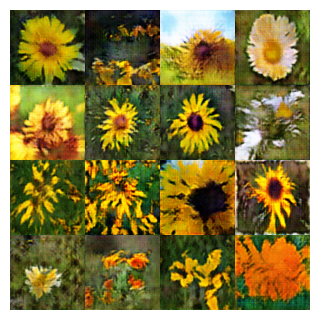

Epoch 55/100 | Iter 19 /189 | D_loss -22.8561 | G_loss 141.4746 | Gradient_Penalty 2.4685 | Gradient_Norm 1.3901 | 
Epoch 55/100 | Iter 38 /189 | D_loss -11.9360 | G_loss 155.9622 | Gradient_Penalty 1.9789 | Gradient_Norm 1.3883 | 
Epoch 55/100 | Iter 57 /189 | D_loss -9.8807 | G_loss 152.2984 | Gradient_Penalty 3.8306 | Gradient_Norm 1.4514 | 
Epoch 55/100 | Iter 76 /189 | D_loss -16.8392 | G_loss 143.1344 | Gradient_Penalty 2.7491 | Gradient_Norm 1.4107 | 
Epoch 55/100 | Iter 95 /189 | D_loss -14.4306 | G_loss 143.1799 | Gradient_Penalty 5.2239 | Gradient_Norm 1.5767 | 
Epoch 55/100 | Iter 114/189 | D_loss -15.0251 | G_loss 146.1240 | Gradient_Penalty 3.8438 | Gradient_Norm 1.4500 | 
Epoch 55/100 | Iter 133/189 | D_loss -15.9314 | G_loss 151.5755 | Gradient_Penalty 1.5777 | Gradient_Norm 1.3226 | 
Epoch 55/100 | Iter 152/189 | D_loss -20.8499 | G_loss 135.8593 | Gradient_Penalty 3.7365 | Gradient_Norm 1.5059 | 
Epoch 55/100 | Iter 171/189 | D_loss -19.5928 | G_loss 143.1017 | Gradien

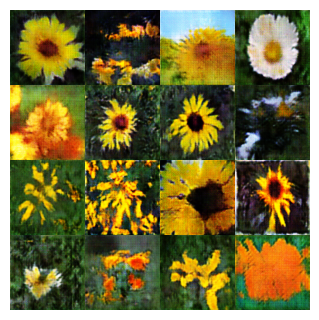

Epoch 56/100 | Iter 19 /189 | D_loss -15.2295 | G_loss 153.2855 | Gradient_Penalty 2.7308 | Gradient_Norm 1.3532 | 
Epoch 56/100 | Iter 38 /189 | D_loss -16.0231 | G_loss 156.3864 | Gradient_Penalty 5.2938 | Gradient_Norm 1.4996 | 
Epoch 56/100 | Iter 57 /189 | D_loss -23.9280 | G_loss 140.4499 | Gradient_Penalty 2.8743 | Gradient_Norm 1.4307 | 
Epoch 56/100 | Iter 76 /189 | D_loss -20.1271 | G_loss 146.9470 | Gradient_Penalty 1.4431 | Gradient_Norm 1.3000 | 
Epoch 56/100 | Iter 95 /189 | D_loss -20.8620 | G_loss 144.0422 | Gradient_Penalty 1.6490 | Gradient_Norm 1.3383 | 
Epoch 56/100 | Iter 114/189 | D_loss -17.0577 | G_loss 144.6758 | Gradient_Penalty 1.4897 | Gradient_Norm 1.3206 | 
Epoch 56/100 | Iter 133/189 | D_loss -12.2217 | G_loss 141.4395 | Gradient_Penalty 3.6837 | Gradient_Norm 1.4190 | 
Epoch 56/100 | Iter 152/189 | D_loss -18.4277 | G_loss 156.6853 | Gradient_Penalty 2.6554 | Gradient_Norm 1.3708 | 
Epoch 56/100 | Iter 171/189 | D_loss -17.8907 | G_loss 151.6689 | Gradie

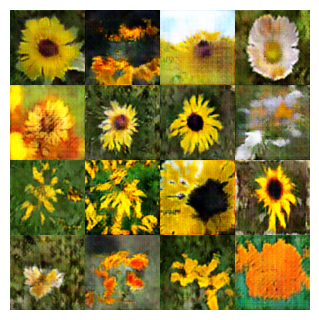

Epoch 57/100 | Iter 19 /189 | D_loss -18.3424 | G_loss 152.1531 | Gradient_Penalty 2.3182 | Gradient_Norm 1.3413 | 
Epoch 57/100 | Iter 38 /189 | D_loss -21.1436 | G_loss 147.8205 | Gradient_Penalty 7.4490 | Gradient_Norm 1.6438 | 
Epoch 57/100 | Iter 57 /189 | D_loss -16.3256 | G_loss 153.6513 | Gradient_Penalty 2.2265 | Gradient_Norm 1.3665 | 
Epoch 57/100 | Iter 76 /189 | D_loss -16.0795 | G_loss 150.1106 | Gradient_Penalty 2.7647 | Gradient_Norm 1.4562 | 
Epoch 57/100 | Iter 95 /189 | D_loss -19.8286 | G_loss 140.7404 | Gradient_Penalty 8.5612 | Gradient_Norm 1.6495 | 
Epoch 57/100 | Iter 114/189 | D_loss -16.9551 | G_loss 155.4578 | Gradient_Penalty 13.8452 | Gradient_Norm 1.8098 | 
Epoch 57/100 | Iter 133/189 | D_loss -30.1924 | G_loss 143.2132 | Gradient_Penalty 5.1042 | Gradient_Norm 1.4966 | 
Epoch 57/100 | Iter 152/189 | D_loss -11.2977 | G_loss 159.7205 | Gradient_Penalty 2.8627 | Gradient_Norm 1.4222 | 
Epoch 57/100 | Iter 171/189 | D_loss -13.6193 | G_loss 155.4099 | Gradi

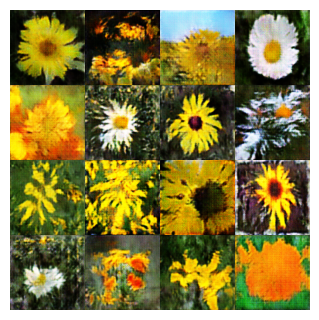

Epoch 58/100 | Iter 19 /189 | D_loss -18.0615 | G_loss 172.9837 | Gradient_Penalty 3.0205 | Gradient_Norm 1.4171 | 
Epoch 58/100 | Iter 38 /189 | D_loss -20.7035 | G_loss 150.5304 | Gradient_Penalty 4.2079 | Gradient_Norm 1.5013 | 
Epoch 58/100 | Iter 57 /189 | D_loss -12.9955 | G_loss 148.1039 | Gradient_Penalty 2.1166 | Gradient_Norm 1.3374 | 
Epoch 58/100 | Iter 76 /189 | D_loss -16.7486 | G_loss 155.3935 | Gradient_Penalty 2.6458 | Gradient_Norm 1.3977 | 
Epoch 58/100 | Iter 95 /189 | D_loss -14.4775 | G_loss 144.5556 | Gradient_Penalty 2.8791 | Gradient_Norm 1.4402 | 
Epoch 58/100 | Iter 114/189 | D_loss -21.5407 | G_loss 152.7338 | Gradient_Penalty 4.7127 | Gradient_Norm 1.4398 | 
Epoch 58/100 | Iter 133/189 | D_loss -18.8055 | G_loss 146.4293 | Gradient_Penalty 3.1985 | Gradient_Norm 1.4215 | 
Epoch 58/100 | Iter 152/189 | D_loss -20.3987 | G_loss 150.8881 | Gradient_Penalty 3.2658 | Gradient_Norm 1.4696 | 
Epoch 58/100 | Iter 171/189 | D_loss -21.6324 | G_loss 156.7211 | Gradie

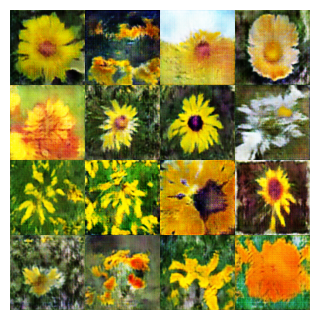

Epoch 59/100 | Iter 19 /189 | D_loss -19.0797 | G_loss 153.6324 | Gradient_Penalty 3.7971 | Gradient_Norm 1.4772 | 
Epoch 59/100 | Iter 38 /189 | D_loss -16.0431 | G_loss 156.2638 | Gradient_Penalty 3.3790 | Gradient_Norm 1.4391 | 
Epoch 59/100 | Iter 57 /189 | D_loss -15.8946 | G_loss 160.3396 | Gradient_Penalty 5.4100 | Gradient_Norm 1.5335 | 
Epoch 59/100 | Iter 76 /189 | D_loss -13.6041 | G_loss 144.4204 | Gradient_Penalty 2.5463 | Gradient_Norm 1.4234 | 
Epoch 59/100 | Iter 95 /189 | D_loss -23.0921 | G_loss 141.0773 | Gradient_Penalty 4.1958 | Gradient_Norm 1.5278 | 
Epoch 59/100 | Iter 114/189 | D_loss -14.0991 | G_loss 143.1278 | Gradient_Penalty 5.6635 | Gradient_Norm 1.4676 | 
Epoch 59/100 | Iter 133/189 | D_loss -16.9800 | G_loss 145.5313 | Gradient_Penalty 2.8628 | Gradient_Norm 1.3390 | 
Epoch 59/100 | Iter 152/189 | D_loss -17.7953 | G_loss 155.5600 | Gradient_Penalty 3.1863 | Gradient_Norm 1.4170 | 
Epoch 59/100 | Iter 171/189 | D_loss -10.9385 | G_loss 159.4348 | Gradie

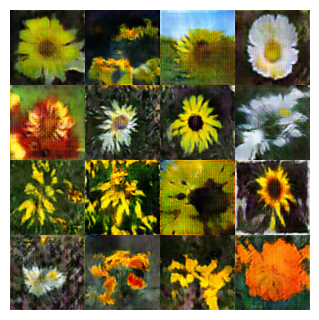

Epoch 60/100 | Iter 19 /189 | D_loss -14.3778 | G_loss 148.7596 | Gradient_Penalty 7.1371 | Gradient_Norm 1.6506 | 
Epoch 60/100 | Iter 38 /189 | D_loss -17.0633 | G_loss 171.5899 | Gradient_Penalty 2.8381 | Gradient_Norm 1.4484 | 
Epoch 60/100 | Iter 57 /189 | D_loss -19.9128 | G_loss 150.0971 | Gradient_Penalty 1.6364 | Gradient_Norm 1.3625 | 
Epoch 60/100 | Iter 76 /189 | D_loss -22.1061 | G_loss 142.1831 | Gradient_Penalty 4.0546 | Gradient_Norm 1.4788 | 
Epoch 60/100 | Iter 95 /189 | D_loss -17.8270 | G_loss 142.5610 | Gradient_Penalty 4.4987 | Gradient_Norm 1.4623 | 
Epoch 60/100 | Iter 114/189 | D_loss -15.9963 | G_loss 157.5548 | Gradient_Penalty 2.2938 | Gradient_Norm 1.4000 | 
Epoch 60/100 | Iter 133/189 | D_loss -19.8675 | G_loss 155.8715 | Gradient_Penalty 2.9674 | Gradient_Norm 1.4397 | 
Epoch 60/100 | Iter 152/189 | D_loss -18.9099 | G_loss 159.7004 | Gradient_Penalty 5.5178 | Gradient_Norm 1.5343 | 
Epoch 60/100 | Iter 171/189 | D_loss -18.4731 | G_loss 151.3191 | Gradie

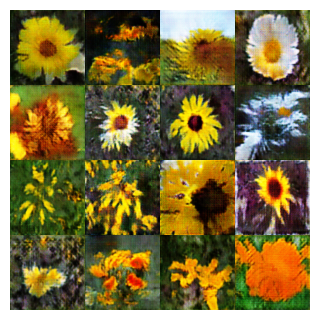

Epoch 61/100 | Iter 19 /189 | D_loss -17.4679 | G_loss 142.9204 | Gradient_Penalty 3.6043 | Gradient_Norm 1.4501 | 
Epoch 61/100 | Iter 38 /189 | D_loss -13.6538 | G_loss 158.6001 | Gradient_Penalty 1.8051 | Gradient_Norm 1.3222 | 
Epoch 61/100 | Iter 57 /189 | D_loss -25.2086 | G_loss 159.5869 | Gradient_Penalty 4.0188 | Gradient_Norm 1.4936 | 
Epoch 61/100 | Iter 76 /189 | D_loss -22.0349 | G_loss 151.0609 | Gradient_Penalty 4.2076 | Gradient_Norm 1.4954 | 
Epoch 61/100 | Iter 95 /189 | D_loss -18.7560 | G_loss 143.0061 | Gradient_Penalty 2.2399 | Gradient_Norm 1.3324 | 
Epoch 61/100 | Iter 114/189 | D_loss -14.9997 | G_loss 149.0825 | Gradient_Penalty 3.3052 | Gradient_Norm 1.3527 | 
Epoch 61/100 | Iter 133/189 | D_loss -19.6006 | G_loss 154.1570 | Gradient_Penalty 1.6113 | Gradient_Norm 1.3289 | 
Epoch 61/100 | Iter 152/189 | D_loss -26.2831 | G_loss 152.3092 | Gradient_Penalty 3.4148 | Gradient_Norm 1.4457 | 
Epoch 61/100 | Iter 171/189 | D_loss -14.3213 | G_loss 144.4721 | Gradie

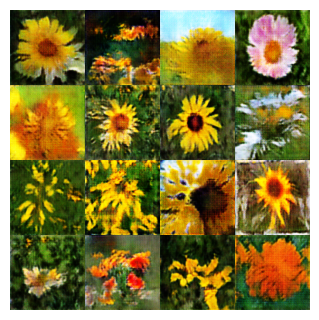

Epoch 62/100 | Iter 19 /189 | D_loss -18.1988 | G_loss 171.4950 | Gradient_Penalty 2.7368 | Gradient_Norm 1.4169 | 
Epoch 62/100 | Iter 38 /189 | D_loss -13.3640 | G_loss 152.1575 | Gradient_Penalty 3.7147 | Gradient_Norm 1.4228 | 
Epoch 62/100 | Iter 57 /189 | D_loss -16.1104 | G_loss 166.8076 | Gradient_Penalty 1.8455 | Gradient_Norm 1.3665 | 
Epoch 62/100 | Iter 76 /189 | D_loss -18.4204 | G_loss 169.0636 | Gradient_Penalty 2.6799 | Gradient_Norm 1.3994 | 
Epoch 62/100 | Iter 95 /189 | D_loss -17.1589 | G_loss 156.0972 | Gradient_Penalty 3.8088 | Gradient_Norm 1.4513 | 
Epoch 62/100 | Iter 114/189 | D_loss -34.6542 | G_loss 146.7559 | Gradient_Penalty 4.2595 | Gradient_Norm 1.5118 | 
Epoch 62/100 | Iter 133/189 | D_loss -3.9688 | G_loss 179.7355 | Gradient_Penalty 14.2276 | Gradient_Norm 1.5803 | 
Epoch 62/100 | Iter 152/189 | D_loss -18.6984 | G_loss 155.1116 | Gradient_Penalty 10.2022 | Gradient_Norm 1.6130 | 
Epoch 62/100 | Iter 171/189 | D_loss -14.8571 | G_loss 167.0494 | Gradi

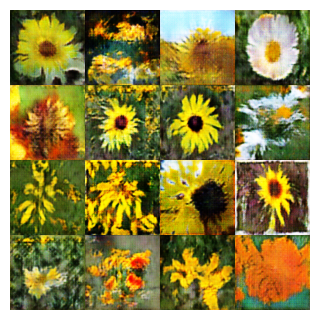

Epoch 63/100 | Iter 19 /189 | D_loss -23.2720 | G_loss 164.3298 | Gradient_Penalty 2.3316 | Gradient_Norm 1.4039 | 
Epoch 63/100 | Iter 38 /189 | D_loss -22.2015 | G_loss 162.7527 | Gradient_Penalty 2.1760 | Gradient_Norm 1.3872 | 
Epoch 63/100 | Iter 57 /189 | D_loss -17.4597 | G_loss 160.9166 | Gradient_Penalty 2.2848 | Gradient_Norm 1.3490 | 
Epoch 63/100 | Iter 76 /189 | D_loss -9.4965 | G_loss 165.4824 | Gradient_Penalty 4.9912 | Gradient_Norm 1.4621 | 
Epoch 63/100 | Iter 95 /189 | D_loss -22.4674 | G_loss 156.6759 | Gradient_Penalty 9.9781 | Gradient_Norm 1.7961 | 
Epoch 63/100 | Iter 114/189 | D_loss -18.0556 | G_loss 159.6859 | Gradient_Penalty 3.1526 | Gradient_Norm 1.3810 | 
Epoch 63/100 | Iter 133/189 | D_loss -27.9724 | G_loss 158.5505 | Gradient_Penalty 6.5320 | Gradient_Norm 1.6111 | 
Epoch 63/100 | Iter 152/189 | D_loss -20.6505 | G_loss 160.9318 | Gradient_Penalty 3.2497 | Gradient_Norm 1.4466 | 
Epoch 63/100 | Iter 171/189 | D_loss -16.3050 | G_loss 160.8383 | Gradien

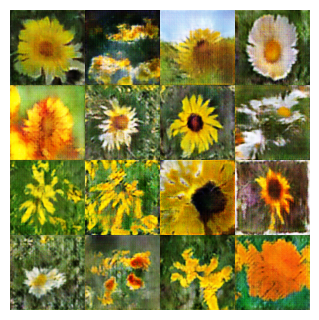

Epoch 64/100 | Iter 19 /189 | D_loss -19.1618 | G_loss 162.9152 | Gradient_Penalty 2.9658 | Gradient_Norm 1.4375 | 
Epoch 64/100 | Iter 38 /189 | D_loss -37.5042 | G_loss 163.9917 | Gradient_Penalty 5.0147 | Gradient_Norm 1.5397 | 
Epoch 64/100 | Iter 57 /189 | D_loss -17.5606 | G_loss 154.2131 | Gradient_Penalty 2.6391 | Gradient_Norm 1.4064 | 
Epoch 64/100 | Iter 76 /189 | D_loss -18.8478 | G_loss 159.2089 | Gradient_Penalty 3.4400 | Gradient_Norm 1.4282 | 
Epoch 64/100 | Iter 95 /189 | D_loss -17.8262 | G_loss 169.0339 | Gradient_Penalty 1.4057 | Gradient_Norm 1.2822 | 
Epoch 64/100 | Iter 114/189 | D_loss -16.3866 | G_loss 167.3857 | Gradient_Penalty 3.8605 | Gradient_Norm 1.4402 | 
Epoch 64/100 | Iter 133/189 | D_loss -15.2887 | G_loss 166.2944 | Gradient_Penalty 2.8493 | Gradient_Norm 1.4141 | 
Epoch 64/100 | Iter 152/189 | D_loss -20.2154 | G_loss 160.4758 | Gradient_Penalty 3.0600 | Gradient_Norm 1.4398 | 
Epoch 64/100 | Iter 171/189 | D_loss -20.7764 | G_loss 158.7043 | Gradie

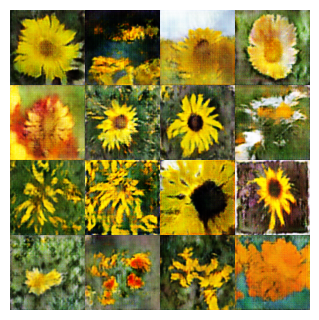

Epoch 65/100 | Iter 19 /189 | D_loss -24.3277 | G_loss 168.6306 | Gradient_Penalty 6.7900 | Gradient_Norm 1.6419 | 
Epoch 65/100 | Iter 38 /189 | D_loss -25.4161 | G_loss 140.5515 | Gradient_Penalty 3.7584 | Gradient_Norm 1.4871 | 
Epoch 65/100 | Iter 57 /189 | D_loss -18.0950 | G_loss 155.3065 | Gradient_Penalty 3.7573 | Gradient_Norm 1.4418 | 
Epoch 65/100 | Iter 76 /189 | D_loss -18.2366 | G_loss 165.2557 | Gradient_Penalty 1.9717 | Gradient_Norm 1.3460 | 
Epoch 65/100 | Iter 95 /189 | D_loss -25.2767 | G_loss 154.4338 | Gradient_Penalty 3.2225 | Gradient_Norm 1.4275 | 
Epoch 65/100 | Iter 114/189 | D_loss -21.5964 | G_loss 140.5264 | Gradient_Penalty 7.9980 | Gradient_Norm 1.6150 | 
Epoch 65/100 | Iter 133/189 | D_loss -20.8938 | G_loss 176.0950 | Gradient_Penalty 5.0722 | Gradient_Norm 1.5092 | 
Epoch 65/100 | Iter 152/189 | D_loss -16.0602 | G_loss 168.3984 | Gradient_Penalty 2.8300 | Gradient_Norm 1.4341 | 
Epoch 65/100 | Iter 171/189 | D_loss -16.0519 | G_loss 159.2646 | Gradie

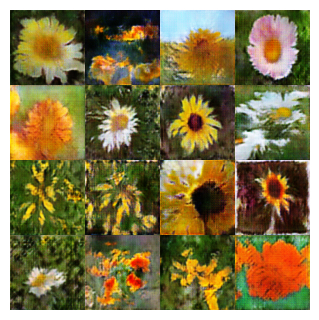

Epoch 66/100 | Iter 19 /189 | D_loss -18.7474 | G_loss 169.5206 | Gradient_Penalty 7.1291 | Gradient_Norm 1.5888 | 
Epoch 66/100 | Iter 38 /189 | D_loss -17.0599 | G_loss 168.7352 | Gradient_Penalty 1.2761 | Gradient_Norm 1.2956 | 
Epoch 66/100 | Iter 57 /189 | D_loss -28.8754 | G_loss 152.7227 | Gradient_Penalty 3.4023 | Gradient_Norm 1.5171 | 
Epoch 66/100 | Iter 76 /189 | D_loss -23.4635 | G_loss 166.9185 | Gradient_Penalty 3.4446 | Gradient_Norm 1.4582 | 
Epoch 66/100 | Iter 95 /189 | D_loss -16.7927 | G_loss 156.3747 | Gradient_Penalty 7.0070 | Gradient_Norm 1.6073 | 
Epoch 66/100 | Iter 114/189 | D_loss -27.6573 | G_loss 161.2293 | Gradient_Penalty 16.1933 | Gradient_Norm 1.9108 | 
Epoch 66/100 | Iter 133/189 | D_loss -15.1830 | G_loss 181.7812 | Gradient_Penalty 1.2028 | Gradient_Norm 1.2883 | 
Epoch 66/100 | Iter 152/189 | D_loss -16.5010 | G_loss 161.6862 | Gradient_Penalty 2.2444 | Gradient_Norm 1.3008 | 
Epoch 66/100 | Iter 171/189 | D_loss -18.7390 | G_loss 180.8582 | Gradi

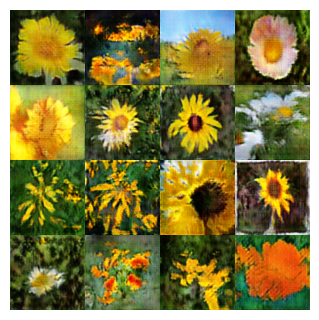

Epoch 67/100 | Iter 19 /189 | D_loss -15.3450 | G_loss 177.8406 | Gradient_Penalty 3.9111 | Gradient_Norm 1.5106 | 
Epoch 67/100 | Iter 38 /189 | D_loss -24.3093 | G_loss 154.5630 | Gradient_Penalty 3.0991 | Gradient_Norm 1.4553 | 
Epoch 67/100 | Iter 57 /189 | D_loss -21.5706 | G_loss 159.2435 | Gradient_Penalty 4.3440 | Gradient_Norm 1.5031 | 
Epoch 67/100 | Iter 76 /189 | D_loss -20.3533 | G_loss 154.6189 | Gradient_Penalty 1.9321 | Gradient_Norm 1.3520 | 
Epoch 67/100 | Iter 95 /189 | D_loss -16.1270 | G_loss 191.6872 | Gradient_Penalty 1.1095 | Gradient_Norm 1.2639 | 
Epoch 67/100 | Iter 114/189 | D_loss -17.6645 | G_loss 169.7234 | Gradient_Penalty 2.7898 | Gradient_Norm 1.4011 | 
Epoch 67/100 | Iter 133/189 | D_loss -16.2189 | G_loss 170.3239 | Gradient_Penalty 3.2439 | Gradient_Norm 1.4378 | 
Epoch 67/100 | Iter 152/189 | D_loss -25.5684 | G_loss 166.4101 | Gradient_Penalty 4.4285 | Gradient_Norm 1.5488 | 
Epoch 67/100 | Iter 171/189 | D_loss -19.2377 | G_loss 190.0752 | Gradie

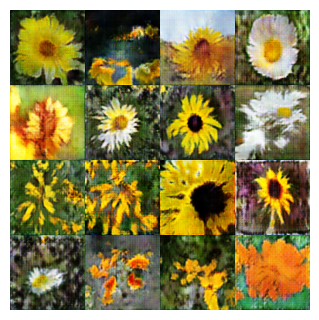

Epoch 68/100 | Iter 19 /189 | D_loss -31.0257 | G_loss 177.6794 | Gradient_Penalty 5.0200 | Gradient_Norm 1.5864 | 
Epoch 68/100 | Iter 38 /189 | D_loss -17.0418 | G_loss 190.7415 | Gradient_Penalty 8.0906 | Gradient_Norm 1.5726 | 
Epoch 68/100 | Iter 57 /189 | D_loss -17.9999 | G_loss 164.6434 | Gradient_Penalty 2.2012 | Gradient_Norm 1.3880 | 
Epoch 68/100 | Iter 76 /189 | D_loss -16.1584 | G_loss 172.5793 | Gradient_Penalty 2.8957 | Gradient_Norm 1.3728 | 
Epoch 68/100 | Iter 95 /189 | D_loss -22.0763 | G_loss 178.9129 | Gradient_Penalty 2.0250 | Gradient_Norm 1.3613 | 
Epoch 68/100 | Iter 114/189 | D_loss -30.8830 | G_loss 175.7495 | Gradient_Penalty 1.9117 | Gradient_Norm 1.3312 | 
Epoch 68/100 | Iter 133/189 | D_loss -22.9593 | G_loss 154.2427 | Gradient_Penalty 5.8214 | Gradient_Norm 1.6231 | 
Epoch 68/100 | Iter 152/189 | D_loss -15.9562 | G_loss 174.4523 | Gradient_Penalty 3.0595 | Gradient_Norm 1.4326 | 
Epoch 68/100 | Iter 171/189 | D_loss -16.0452 | G_loss 173.9806 | Gradie

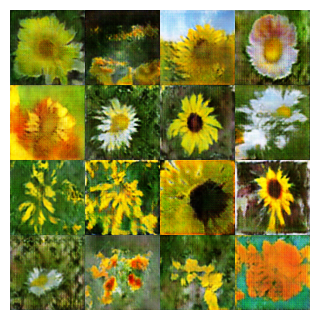

Epoch 69/100 | Iter 19 /189 | D_loss -23.6042 | G_loss 157.6736 | Gradient_Penalty 7.3473 | Gradient_Norm 1.5588 | 
Epoch 69/100 | Iter 38 /189 | D_loss -22.6141 | G_loss 169.0285 | Gradient_Penalty 3.9637 | Gradient_Norm 1.4909 | 
Epoch 69/100 | Iter 57 /189 | D_loss -22.1797 | G_loss 179.0616 | Gradient_Penalty 5.0716 | Gradient_Norm 1.5837 | 
Epoch 69/100 | Iter 76 /189 | D_loss -15.9253 | G_loss 159.5181 | Gradient_Penalty 3.4572 | Gradient_Norm 1.4772 | 
Epoch 69/100 | Iter 95 /189 | D_loss -14.8750 | G_loss 168.6607 | Gradient_Penalty 3.6330 | Gradient_Norm 1.4899 | 
Epoch 69/100 | Iter 114/189 | D_loss -15.2985 | G_loss 164.6418 | Gradient_Penalty 3.3426 | Gradient_Norm 1.4677 | 
Epoch 69/100 | Iter 133/189 | D_loss -17.1465 | G_loss 183.1662 | Gradient_Penalty 2.8255 | Gradient_Norm 1.4295 | 
Epoch 69/100 | Iter 152/189 | D_loss -11.8166 | G_loss 177.5518 | Gradient_Penalty 1.8650 | Gradient_Norm 1.3476 | 
Epoch 69/100 | Iter 171/189 | D_loss -16.6277 | G_loss 174.1907 | Gradie

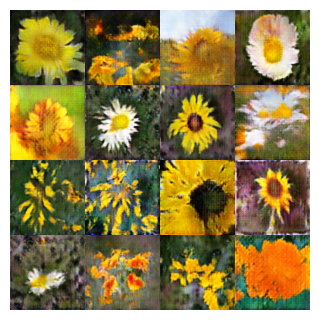

Epoch 70/100 | Iter 19 /189 | D_loss -12.7727 | G_loss 168.2107 | Gradient_Penalty 7.9285 | Gradient_Norm 1.6213 | 
Epoch 70/100 | Iter 38 /189 | D_loss -16.0810 | G_loss 189.0876 | Gradient_Penalty 5.2450 | Gradient_Norm 1.4528 | 
Epoch 70/100 | Iter 57 /189 | D_loss -25.6466 | G_loss 184.5730 | Gradient_Penalty 4.7387 | Gradient_Norm 1.5843 | 
Epoch 70/100 | Iter 76 /189 | D_loss -12.5688 | G_loss 167.9577 | Gradient_Penalty 9.8928 | Gradient_Norm 1.7216 | 
Epoch 70/100 | Iter 95 /189 | D_loss -18.4656 | G_loss 169.7041 | Gradient_Penalty 2.6478 | Gradient_Norm 1.3928 | 
Epoch 70/100 | Iter 114/189 | D_loss -22.2798 | G_loss 173.2829 | Gradient_Penalty 4.4572 | Gradient_Norm 1.5516 | 
Epoch 70/100 | Iter 133/189 | D_loss -22.2026 | G_loss 156.4596 | Gradient_Penalty 2.0982 | Gradient_Norm 1.3647 | 
Epoch 70/100 | Iter 152/189 | D_loss -17.3888 | G_loss 171.2545 | Gradient_Penalty 2.1300 | Gradient_Norm 1.2670 | 
Epoch 70/100 | Iter 171/189 | D_loss -19.1361 | G_loss 161.8887 | Gradie

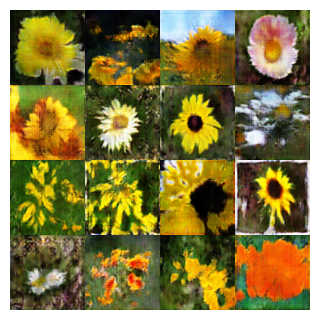

Epoch 71/100 | Iter 19 /189 | D_loss -19.1669 | G_loss 172.3795 | Gradient_Penalty 5.1409 | Gradient_Norm 1.5332 | 
Epoch 71/100 | Iter 38 /189 | D_loss -22.5120 | G_loss 183.2239 | Gradient_Penalty 3.1528 | Gradient_Norm 1.4407 | 
Epoch 71/100 | Iter 57 /189 | D_loss -22.6453 | G_loss 180.0379 | Gradient_Penalty 5.8507 | Gradient_Norm 1.5650 | 
Epoch 71/100 | Iter 76 /189 | D_loss -24.2566 | G_loss 172.8595 | Gradient_Penalty 2.3112 | Gradient_Norm 1.3773 | 
Epoch 71/100 | Iter 95 /189 | D_loss -21.6562 | G_loss 175.6751 | Gradient_Penalty 2.2338 | Gradient_Norm 1.4022 | 
Epoch 71/100 | Iter 114/189 | D_loss -20.1810 | G_loss 179.0511 | Gradient_Penalty 2.1726 | Gradient_Norm 1.4109 | 
Epoch 71/100 | Iter 133/189 | D_loss -20.3800 | G_loss 198.5933 | Gradient_Penalty 7.7809 | Gradient_Norm 1.6277 | 
Epoch 71/100 | Iter 152/189 | D_loss -11.0326 | G_loss 179.0064 | Gradient_Penalty 2.9539 | Gradient_Norm 1.3986 | 
Epoch 71/100 | Iter 171/189 | D_loss -20.1261 | G_loss 173.4528 | Gradie

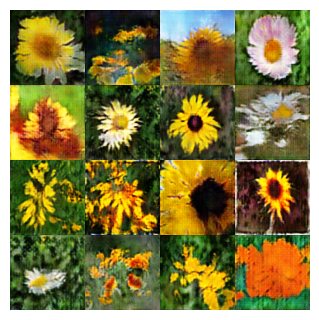

Epoch 72/100 | Iter 19 /189 | D_loss -20.5999 | G_loss 168.5314 | Gradient_Penalty 4.9702 | Gradient_Norm 1.5542 | 
Epoch 72/100 | Iter 38 /189 | D_loss -24.3963 | G_loss 192.5015 | Gradient_Penalty 4.9367 | Gradient_Norm 1.4883 | 
Epoch 72/100 | Iter 57 /189 | D_loss -19.0982 | G_loss 173.3228 | Gradient_Penalty 6.8752 | Gradient_Norm 1.6178 | 
Epoch 72/100 | Iter 76 /189 | D_loss -24.7013 | G_loss 163.9664 | Gradient_Penalty 4.3050 | Gradient_Norm 1.4843 | 
Epoch 72/100 | Iter 95 /189 | D_loss -18.5090 | G_loss 172.5088 | Gradient_Penalty 3.9658 | Gradient_Norm 1.4402 | 
Epoch 72/100 | Iter 114/189 | D_loss -23.2360 | G_loss 185.7369 | Gradient_Penalty 4.5272 | Gradient_Norm 1.4997 | 
Epoch 72/100 | Iter 133/189 | D_loss -19.1314 | G_loss 167.3150 | Gradient_Penalty 4.9829 | Gradient_Norm 1.4866 | 
Epoch 72/100 | Iter 152/189 | D_loss -16.4434 | G_loss 181.3777 | Gradient_Penalty 4.8127 | Gradient_Norm 1.4860 | 
Epoch 72/100 | Iter 171/189 | D_loss -15.6423 | G_loss 181.4695 | Gradie

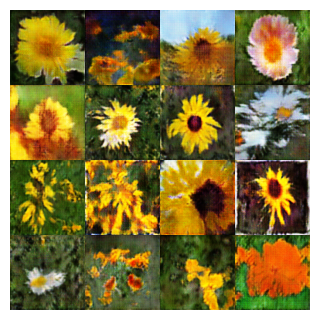

Epoch 73/100 | Iter 19 /189 | D_loss -17.3785 | G_loss 176.6833 | Gradient_Penalty 2.8276 | Gradient_Norm 1.4298 | 
Epoch 73/100 | Iter 38 /189 | D_loss -21.6585 | G_loss 177.2842 | Gradient_Penalty 6.5234 | Gradient_Norm 1.4522 | 
Epoch 73/100 | Iter 57 /189 | D_loss -17.5325 | G_loss 170.4265 | Gradient_Penalty 3.3576 | Gradient_Norm 1.3875 | 
Epoch 73/100 | Iter 76 /189 | D_loss -20.4436 | G_loss 167.3870 | Gradient_Penalty 2.2728 | Gradient_Norm 1.3800 | 
Epoch 73/100 | Iter 95 /189 | D_loss -15.1646 | G_loss 180.6620 | Gradient_Penalty 2.5689 | Gradient_Norm 1.4053 | 
Epoch 73/100 | Iter 114/189 | D_loss -15.2069 | G_loss 184.6973 | Gradient_Penalty 2.2458 | Gradient_Norm 1.3778 | 
Epoch 73/100 | Iter 133/189 | D_loss -19.8434 | G_loss 188.5810 | Gradient_Penalty 2.7093 | Gradient_Norm 1.4293 | 
Epoch 73/100 | Iter 152/189 | D_loss -19.6455 | G_loss 180.5077 | Gradient_Penalty 7.1397 | Gradient_Norm 1.5566 | 
Epoch 73/100 | Iter 171/189 | D_loss -21.2688 | G_loss 172.6207 | Gradie

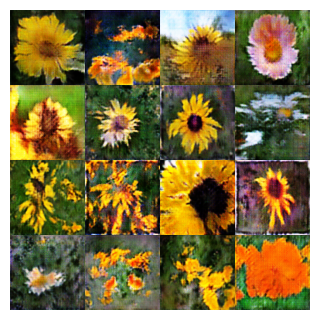

Epoch 74/100 | Iter 19 /189 | D_loss -21.5826 | G_loss 167.5916 | Gradient_Penalty 5.2078 | Gradient_Norm 1.5190 | 
Epoch 74/100 | Iter 38 /189 | D_loss -14.2098 | G_loss 173.2693 | Gradient_Penalty 5.0975 | Gradient_Norm 1.5329 | 
Epoch 74/100 | Iter 57 /189 | D_loss -26.8356 | G_loss 170.2717 | Gradient_Penalty 1.5472 | Gradient_Norm 1.3335 | 
Epoch 74/100 | Iter 76 /189 | D_loss -17.4717 | G_loss 176.7319 | Gradient_Penalty 6.3756 | Gradient_Norm 1.5972 | 
Epoch 74/100 | Iter 95 /189 | D_loss -15.4835 | G_loss 175.9046 | Gradient_Penalty 2.9835 | Gradient_Norm 1.3427 | 
Epoch 74/100 | Iter 114/189 | D_loss -18.1453 | G_loss 181.0750 | Gradient_Penalty 1.7672 | Gradient_Norm 1.3181 | 
Epoch 74/100 | Iter 133/189 | D_loss -14.4258 | G_loss 182.8657 | Gradient_Penalty 3.0974 | Gradient_Norm 1.4021 | 
Epoch 74/100 | Iter 152/189 | D_loss -24.3019 | G_loss 179.0286 | Gradient_Penalty 2.2936 | Gradient_Norm 1.3977 | 
Epoch 74/100 | Iter 171/189 | D_loss -18.9268 | G_loss 182.5854 | Gradie

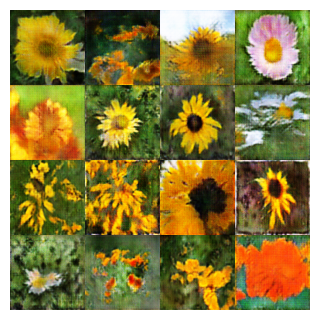

Epoch 75/100 | Iter 19 /189 | D_loss -24.5967 | G_loss 168.0735 | Gradient_Penalty 8.2085 | Gradient_Norm 1.7089 | 
Epoch 75/100 | Iter 38 /189 | D_loss -16.9671 | G_loss 189.2200 | Gradient_Penalty 2.2331 | Gradient_Norm 1.3823 | 
Epoch 75/100 | Iter 57 /189 | D_loss -23.7051 | G_loss 165.4617 | Gradient_Penalty 10.0054 | Gradient_Norm 1.6914 | 
Epoch 75/100 | Iter 76 /189 | D_loss -14.6751 | G_loss 171.8407 | Gradient_Penalty 2.4796 | Gradient_Norm 1.3911 | 
Epoch 75/100 | Iter 95 /189 | D_loss -16.0002 | G_loss 204.3753 | Gradient_Penalty 2.2092 | Gradient_Norm 1.3725 | 
Epoch 75/100 | Iter 114/189 | D_loss -16.1338 | G_loss 185.2341 | Gradient_Penalty 4.0612 | Gradient_Norm 1.4414 | 
Epoch 75/100 | Iter 133/189 | D_loss -20.9938 | G_loss 174.1584 | Gradient_Penalty 2.6583 | Gradient_Norm 1.3968 | 
Epoch 75/100 | Iter 152/189 | D_loss -18.0405 | G_loss 191.9982 | Gradient_Penalty 2.3357 | Gradient_Norm 1.3544 | 
Epoch 75/100 | Iter 171/189 | D_loss -26.9638 | G_loss 181.4413 | Gradi

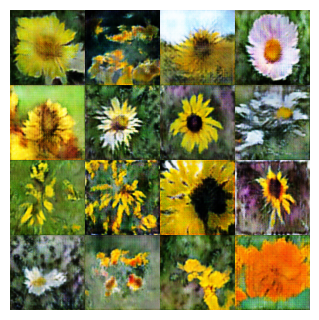

Epoch 76/100 | Iter 19 /189 | D_loss -17.4188 | G_loss 196.9742 | Gradient_Penalty 4.8813 | Gradient_Norm 1.5462 | 
Epoch 76/100 | Iter 38 /189 | D_loss -23.2354 | G_loss 177.9653 | Gradient_Penalty 10.0749 | Gradient_Norm 1.7036 | 
Epoch 76/100 | Iter 57 /189 | D_loss -14.8730 | G_loss 177.4224 | Gradient_Penalty 3.2713 | Gradient_Norm 1.4511 | 
Epoch 76/100 | Iter 76 /189 | D_loss -16.7697 | G_loss 196.3852 | Gradient_Penalty 5.5963 | Gradient_Norm 1.6015 | 
Epoch 76/100 | Iter 95 /189 | D_loss -14.5746 | G_loss 178.1957 | Gradient_Penalty 2.1436 | Gradient_Norm 1.3790 | 
Epoch 76/100 | Iter 114/189 | D_loss -13.9690 | G_loss 188.4337 | Gradient_Penalty 1.1252 | Gradient_Norm 1.2563 | 
Epoch 76/100 | Iter 133/189 | D_loss -18.4534 | G_loss 182.2506 | Gradient_Penalty 5.8817 | Gradient_Norm 1.6461 | 
Epoch 76/100 | Iter 152/189 | D_loss -29.3301 | G_loss 176.3311 | Gradient_Penalty 6.9884 | Gradient_Norm 1.6203 | 
Epoch 76/100 | Iter 171/189 | D_loss -22.5260 | G_loss 185.7514 | Gradi

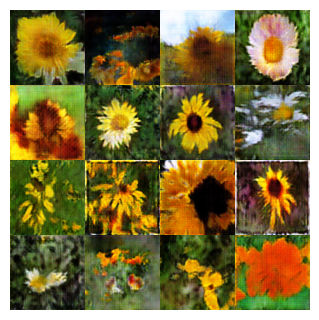

Epoch 77/100 | Iter 19 /189 | D_loss -17.7323 | G_loss 179.6614 | Gradient_Penalty 2.0128 | Gradient_Norm 1.3713 | 
Epoch 77/100 | Iter 38 /189 | D_loss -17.1493 | G_loss 177.5744 | Gradient_Penalty 2.7165 | Gradient_Norm 1.4467 | 
Epoch 77/100 | Iter 57 /189 | D_loss -18.7126 | G_loss 177.0203 | Gradient_Penalty 4.4766 | Gradient_Norm 1.4744 | 
Epoch 77/100 | Iter 76 /189 | D_loss -19.6050 | G_loss 189.4266 | Gradient_Penalty 5.5145 | Gradient_Norm 1.5983 | 
Epoch 77/100 | Iter 95 /189 | D_loss -16.6774 | G_loss 185.5501 | Gradient_Penalty 4.0953 | Gradient_Norm 1.5146 | 
Epoch 77/100 | Iter 114/189 | D_loss -15.2181 | G_loss 173.1653 | Gradient_Penalty 6.5912 | Gradient_Norm 1.6291 | 
Epoch 77/100 | Iter 133/189 | D_loss -22.4871 | G_loss 186.9635 | Gradient_Penalty 6.1644 | Gradient_Norm 1.6558 | 
Epoch 77/100 | Iter 152/189 | D_loss -22.3378 | G_loss 184.4836 | Gradient_Penalty 4.3858 | Gradient_Norm 1.5601 | 
Epoch 77/100 | Iter 171/189 | D_loss -16.8472 | G_loss 194.1609 | Gradie

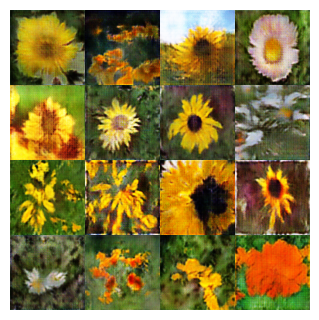

Epoch 78/100 | Iter 19 /189 | D_loss -14.2530 | G_loss 181.6915 | Gradient_Penalty 2.3086 | Gradient_Norm 1.3271 | 
Epoch 78/100 | Iter 38 /189 | D_loss -21.4001 | G_loss 189.6177 | Gradient_Penalty 9.4820 | Gradient_Norm 1.6779 | 
Epoch 78/100 | Iter 57 /189 | D_loss -17.9087 | G_loss 185.5198 | Gradient_Penalty 2.3968 | Gradient_Norm 1.3745 | 
Epoch 78/100 | Iter 76 /189 | D_loss -23.5128 | G_loss 194.4327 | Gradient_Penalty 4.2681 | Gradient_Norm 1.5026 | 
Epoch 78/100 | Iter 95 /189 | D_loss -16.5634 | G_loss 190.6844 | Gradient_Penalty 1.5383 | Gradient_Norm 1.3402 | 
Epoch 78/100 | Iter 114/189 | D_loss -11.2810 | G_loss 203.0912 | Gradient_Penalty 3.7364 | Gradient_Norm 1.4497 | 
Epoch 78/100 | Iter 133/189 | D_loss -23.4955 | G_loss 195.9886 | Gradient_Penalty 3.8960 | Gradient_Norm 1.4901 | 
Epoch 78/100 | Iter 152/189 | D_loss -28.0516 | G_loss 190.6285 | Gradient_Penalty 12.1483 | Gradient_Norm 1.7644 | 
Epoch 78/100 | Iter 171/189 | D_loss -13.4717 | G_loss 187.2007 | Gradi

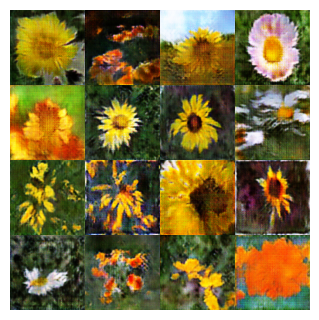

Epoch 79/100 | Iter 19 /189 | D_loss -27.6045 | G_loss 184.2308 | Gradient_Penalty 8.9597 | Gradient_Norm 1.7709 | 
Epoch 79/100 | Iter 38 /189 | D_loss -7.1985 | G_loss 198.8311 | Gradient_Penalty 4.7552 | Gradient_Norm 1.5268 | 
Epoch 79/100 | Iter 57 /189 | D_loss -13.2605 | G_loss 192.5945 | Gradient_Penalty 4.4780 | Gradient_Norm 1.4629 | 
Epoch 79/100 | Iter 76 /189 | D_loss -15.9248 | G_loss 195.5166 | Gradient_Penalty 16.6225 | Gradient_Norm 1.7319 | 
Epoch 79/100 | Iter 95 /189 | D_loss -20.0423 | G_loss 214.3480 | Gradient_Penalty 2.4776 | Gradient_Norm 1.4052 | 
Epoch 79/100 | Iter 114/189 | D_loss -14.6108 | G_loss 195.7711 | Gradient_Penalty 4.2286 | Gradient_Norm 1.4527 | 
Epoch 79/100 | Iter 133/189 | D_loss -16.5944 | G_loss 195.9721 | Gradient_Penalty 2.1338 | Gradient_Norm 1.3721 | 
Epoch 79/100 | Iter 152/189 | D_loss -17.1040 | G_loss 188.6003 | Gradient_Penalty 2.2082 | Gradient_Norm 1.4011 | 
Epoch 79/100 | Iter 171/189 | D_loss -22.3689 | G_loss 189.6710 | Gradie

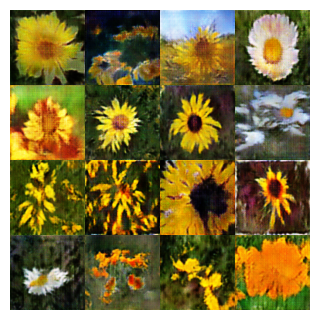

Epoch 80/100 | Iter 19 /189 | D_loss -19.5977 | G_loss 197.3779 | Gradient_Penalty 6.5021 | Gradient_Norm 1.5702 | 
Epoch 80/100 | Iter 38 /189 | D_loss -26.9472 | G_loss 213.1722 | Gradient_Penalty 2.0038 | Gradient_Norm 1.3862 | 
Epoch 80/100 | Iter 57 /189 | D_loss -14.9239 | G_loss 196.8211 | Gradient_Penalty 4.6183 | Gradient_Norm 1.5205 | 
Epoch 80/100 | Iter 76 /189 | D_loss -16.9393 | G_loss 189.4222 | Gradient_Penalty 6.2653 | Gradient_Norm 1.5914 | 
Epoch 80/100 | Iter 95 /189 | D_loss -23.9155 | G_loss 183.8172 | Gradient_Penalty 2.8566 | Gradient_Norm 1.4302 | 
Epoch 80/100 | Iter 114/189 | D_loss -25.5972 | G_loss 189.9538 | Gradient_Penalty 2.4765 | Gradient_Norm 1.4383 | 
Epoch 80/100 | Iter 133/189 | D_loss -19.5707 | G_loss 193.8507 | Gradient_Penalty 1.8179 | Gradient_Norm 1.3581 | 
Epoch 80/100 | Iter 152/189 | D_loss -17.5597 | G_loss 186.6369 | Gradient_Penalty 3.6630 | Gradient_Norm 1.4750 | 
Epoch 80/100 | Iter 171/189 | D_loss -20.2692 | G_loss 184.8456 | Gradie

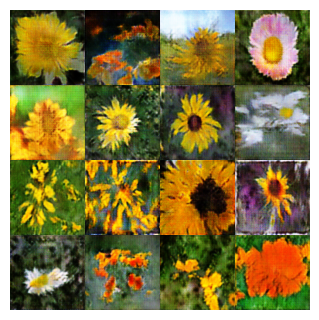

Epoch 81/100 | Iter 19 /189 | D_loss -17.2482 | G_loss 194.8608 | Gradient_Penalty 2.6948 | Gradient_Norm 1.4024 | 
Epoch 81/100 | Iter 38 /189 | D_loss -18.0616 | G_loss 198.0270 | Gradient_Penalty 6.9443 | Gradient_Norm 1.6594 | 
Epoch 81/100 | Iter 57 /189 | D_loss -18.2929 | G_loss 202.1131 | Gradient_Penalty 1.6557 | Gradient_Norm 1.3442 | 
Epoch 81/100 | Iter 76 /189 | D_loss -17.1987 | G_loss 194.2953 | Gradient_Penalty 3.1092 | Gradient_Norm 1.4699 | 
Epoch 81/100 | Iter 95 /189 | D_loss -15.5808 | G_loss 204.4471 | Gradient_Penalty 4.4339 | Gradient_Norm 1.5416 | 
Epoch 81/100 | Iter 114/189 | D_loss -30.3796 | G_loss 187.4044 | Gradient_Penalty 2.6357 | Gradient_Norm 1.4339 | 
Epoch 81/100 | Iter 133/189 | D_loss -26.8497 | G_loss 195.1353 | Gradient_Penalty 5.7893 | Gradient_Norm 1.6227 | 
Epoch 81/100 | Iter 152/189 | D_loss -25.5619 | G_loss 199.3766 | Gradient_Penalty 4.5349 | Gradient_Norm 1.5215 | 
Epoch 81/100 | Iter 171/189 | D_loss -18.7545 | G_loss 187.0320 | Gradie

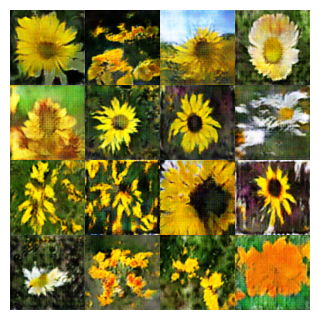

Epoch 82/100 | Iter 19 /189 | D_loss -20.7890 | G_loss 216.6375 | Gradient_Penalty 2.7138 | Gradient_Norm 1.4403 | 
Epoch 82/100 | Iter 38 /189 | D_loss -20.8798 | G_loss 186.3302 | Gradient_Penalty 8.7872 | Gradient_Norm 1.4830 | 
Epoch 82/100 | Iter 57 /189 | D_loss -20.4956 | G_loss 199.2260 | Gradient_Penalty 2.8234 | Gradient_Norm 1.4424 | 
Epoch 82/100 | Iter 76 /189 | D_loss -23.6297 | G_loss 202.9294 | Gradient_Penalty 1.9489 | Gradient_Norm 1.3584 | 
Epoch 82/100 | Iter 95 /189 | D_loss -19.6709 | G_loss 200.5196 | Gradient_Penalty 6.9847 | Gradient_Norm 1.5787 | 
Epoch 82/100 | Iter 114/189 | D_loss -16.7064 | G_loss 202.1090 | Gradient_Penalty 5.0363 | Gradient_Norm 1.5645 | 
Epoch 82/100 | Iter 133/189 | D_loss -10.3918 | G_loss 199.2570 | Gradient_Penalty 14.5684 | Gradient_Norm 1.5419 | 
Epoch 82/100 | Iter 152/189 | D_loss -24.1718 | G_loss 189.7790 | Gradient_Penalty 4.4509 | Gradient_Norm 1.4848 | 
Epoch 82/100 | Iter 171/189 | D_loss -11.3320 | G_loss 195.1068 | Gradi

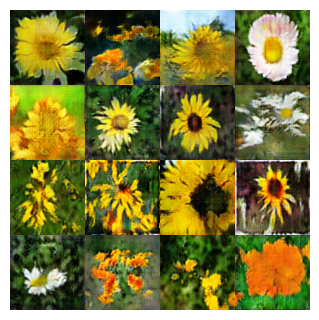

Epoch 83/100 | Iter 19 /189 | D_loss -20.7079 | G_loss 190.5902 | Gradient_Penalty 3.2271 | Gradient_Norm 1.4630 | 
Epoch 83/100 | Iter 38 /189 | D_loss -17.1397 | G_loss 199.3048 | Gradient_Penalty 2.9648 | Gradient_Norm 1.4299 | 
Epoch 83/100 | Iter 57 /189 | D_loss -19.7474 | G_loss 208.6037 | Gradient_Penalty 1.8216 | Gradient_Norm 1.3452 | 
Epoch 83/100 | Iter 76 /189 | D_loss -7.1198 | G_loss 208.0501 | Gradient_Penalty 14.9263 | Gradient_Norm 1.6012 | 
Epoch 83/100 | Iter 95 /189 | D_loss -19.8503 | G_loss 194.8763 | Gradient_Penalty 3.3112 | Gradient_Norm 1.4770 | 
Epoch 83/100 | Iter 114/189 | D_loss -18.2795 | G_loss 198.7750 | Gradient_Penalty 2.4460 | Gradient_Norm 1.4028 | 
Epoch 83/100 | Iter 133/189 | D_loss -16.6023 | G_loss 186.1391 | Gradient_Penalty 3.5922 | Gradient_Norm 1.4797 | 
Epoch 83/100 | Iter 152/189 | D_loss -24.8741 | G_loss 188.8987 | Gradient_Penalty 2.1961 | Gradient_Norm 1.3662 | 
Epoch 83/100 | Iter 171/189 | D_loss -17.2686 | G_loss 189.3525 | Gradie

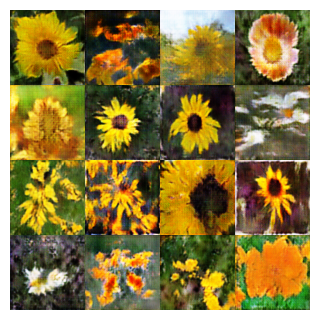

Epoch 84/100 | Iter 19 /189 | D_loss -21.4454 | G_loss 196.9956 | Gradient_Penalty 3.0632 | Gradient_Norm 1.4561 | 
Epoch 84/100 | Iter 38 /189 | D_loss -20.4685 | G_loss 193.8769 | Gradient_Penalty 3.5323 | Gradient_Norm 1.4917 | 
Epoch 84/100 | Iter 57 /189 | D_loss -16.5013 | G_loss 206.1952 | Gradient_Penalty 2.6181 | Gradient_Norm 1.4080 | 
Epoch 84/100 | Iter 76 /189 | D_loss -21.6139 | G_loss 206.1560 | Gradient_Penalty 3.0906 | Gradient_Norm 1.4354 | 
Epoch 84/100 | Iter 95 /189 | D_loss -18.7575 | G_loss 201.4780 | Gradient_Penalty 4.5722 | Gradient_Norm 1.5584 | 
Epoch 84/100 | Iter 114/189 | D_loss -21.3246 | G_loss 202.0940 | Gradient_Penalty 3.5165 | Gradient_Norm 1.4869 | 
Epoch 84/100 | Iter 133/189 | D_loss -16.5458 | G_loss 188.5060 | Gradient_Penalty 2.8987 | Gradient_Norm 1.4104 | 
Epoch 84/100 | Iter 152/189 | D_loss -27.7251 | G_loss 213.1777 | Gradient_Penalty 3.4239 | Gradient_Norm 1.4811 | 
Epoch 84/100 | Iter 171/189 | D_loss -13.1680 | G_loss 192.1024 | Gradie

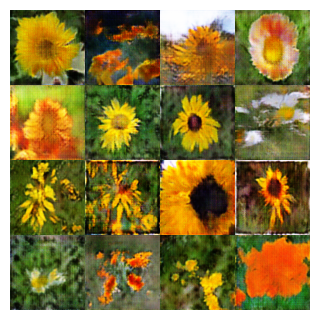

Epoch 85/100 | Iter 19 /189 | D_loss -23.9602 | G_loss 195.4792 | Gradient_Penalty 5.2406 | Gradient_Norm 1.5737 | 
Epoch 85/100 | Iter 38 /189 | D_loss -20.3096 | G_loss 198.4651 | Gradient_Penalty 6.0425 | Gradient_Norm 1.5766 | 
Epoch 85/100 | Iter 57 /189 | D_loss -28.7083 | G_loss 197.3559 | Gradient_Penalty 1.8190 | Gradient_Norm 1.3369 | 
Epoch 85/100 | Iter 76 /189 | D_loss -20.7062 | G_loss 222.0638 | Gradient_Penalty 3.7903 | Gradient_Norm 1.4941 | 
Epoch 85/100 | Iter 95 /189 | D_loss -20.4991 | G_loss 217.1963 | Gradient_Penalty 4.8009 | Gradient_Norm 1.5689 | 
Epoch 85/100 | Iter 114/189 | D_loss -28.8777 | G_loss 202.3041 | Gradient_Penalty 9.8888 | Gradient_Norm 1.6662 | 
Epoch 85/100 | Iter 133/189 | D_loss -16.9384 | G_loss 199.2634 | Gradient_Penalty 5.7494 | Gradient_Norm 1.5091 | 
Epoch 85/100 | Iter 152/189 | D_loss -15.0669 | G_loss 212.4607 | Gradient_Penalty 5.9866 | Gradient_Norm 1.5016 | 
Epoch 85/100 | Iter 171/189 | D_loss -23.8315 | G_loss 179.5637 | Gradie

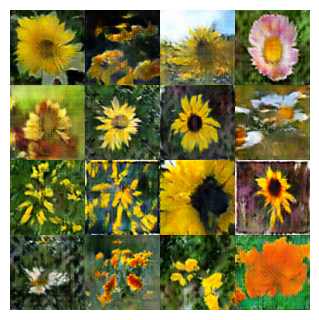

Epoch 86/100 | Iter 19 /189 | D_loss -25.4067 | G_loss 181.0318 | Gradient_Penalty 6.4671 | Gradient_Norm 1.4885 | 
Epoch 86/100 | Iter 38 /189 | D_loss -16.2717 | G_loss 204.5031 | Gradient_Penalty 3.0496 | Gradient_Norm 1.4746 | 
Epoch 86/100 | Iter 57 /189 | D_loss -24.9176 | G_loss 201.9883 | Gradient_Penalty 4.8345 | Gradient_Norm 1.5600 | 
Epoch 86/100 | Iter 76 /189 | D_loss -25.0169 | G_loss 194.3033 | Gradient_Penalty 3.2057 | Gradient_Norm 1.4720 | 
Epoch 86/100 | Iter 95 /189 | D_loss -30.4127 | G_loss 208.7559 | Gradient_Penalty 3.6152 | Gradient_Norm 1.4974 | 
Epoch 86/100 | Iter 114/189 | D_loss -12.8869 | G_loss 195.6922 | Gradient_Penalty 2.3299 | Gradient_Norm 1.3942 | 
Epoch 86/100 | Iter 133/189 | D_loss -14.1641 | G_loss 211.0904 | Gradient_Penalty 2.4043 | Gradient_Norm 1.3660 | 
Epoch 86/100 | Iter 152/189 | D_loss -16.6267 | G_loss 212.6370 | Gradient_Penalty 9.1922 | Gradient_Norm 1.6579 | 
Epoch 86/100 | Iter 171/189 | D_loss -20.6954 | G_loss 209.7167 | Gradie

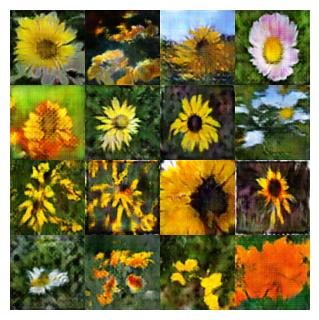

Epoch 87/100 | Iter 19 /189 | D_loss -21.8636 | G_loss 225.0110 | Gradient_Penalty 4.1754 | Gradient_Norm 1.5100 | 
Epoch 87/100 | Iter 38 /189 | D_loss -20.5095 | G_loss 200.8605 | Gradient_Penalty 3.0241 | Gradient_Norm 1.4109 | 
Epoch 87/100 | Iter 57 /189 | D_loss -28.5404 | G_loss 201.1174 | Gradient_Penalty 3.5327 | Gradient_Norm 1.4822 | 
Epoch 87/100 | Iter 76 /189 | D_loss -24.9702 | G_loss 201.1993 | Gradient_Penalty 2.7563 | Gradient_Norm 1.3887 | 
Epoch 87/100 | Iter 95 /189 | D_loss -34.3930 | G_loss 195.8823 | Gradient_Penalty 4.5517 | Gradient_Norm 1.5371 | 
Epoch 87/100 | Iter 114/189 | D_loss -25.1084 | G_loss 202.4521 | Gradient_Penalty 4.4357 | Gradient_Norm 1.4969 | 
Epoch 87/100 | Iter 133/189 | D_loss -16.0209 | G_loss 212.0498 | Gradient_Penalty 1.3858 | Gradient_Norm 1.2957 | 
Epoch 87/100 | Iter 152/189 | D_loss -15.6099 | G_loss 207.6419 | Gradient_Penalty 4.7242 | Gradient_Norm 1.4876 | 
Epoch 87/100 | Iter 171/189 | D_loss -24.0009 | G_loss 200.7392 | Gradie

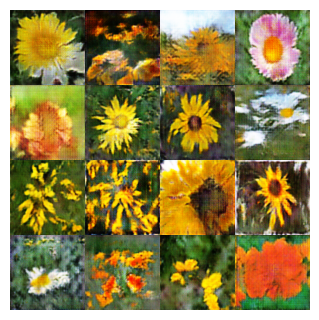

Epoch 88/100 | Iter 19 /189 | D_loss -13.2402 | G_loss 205.6833 | Gradient_Penalty 5.9139 | Gradient_Norm 1.4813 | 
Epoch 88/100 | Iter 38 /189 | D_loss -25.2070 | G_loss 200.9163 | Gradient_Penalty 2.3069 | Gradient_Norm 1.3995 | 
Epoch 88/100 | Iter 57 /189 | D_loss -20.0380 | G_loss 229.3714 | Gradient_Penalty 3.1953 | Gradient_Norm 1.4494 | 
Epoch 88/100 | Iter 76 /189 | D_loss -24.7090 | G_loss 205.6287 | Gradient_Penalty 2.4488 | Gradient_Norm 1.4127 | 
Epoch 88/100 | Iter 95 /189 | D_loss -22.2034 | G_loss 186.5827 | Gradient_Penalty 5.6702 | Gradient_Norm 1.6153 | 
Epoch 88/100 | Iter 114/189 | D_loss -22.0308 | G_loss 215.1557 | Gradient_Penalty 2.0734 | Gradient_Norm 1.3937 | 
Epoch 88/100 | Iter 133/189 | D_loss -20.8610 | G_loss 221.7438 | Gradient_Penalty 9.7350 | Gradient_Norm 1.7683 | 
Epoch 88/100 | Iter 152/189 | D_loss -17.6301 | G_loss 217.2766 | Gradient_Penalty 2.6161 | Gradient_Norm 1.3895 | 
Epoch 88/100 | Iter 171/189 | D_loss -22.3876 | G_loss 198.9837 | Gradie

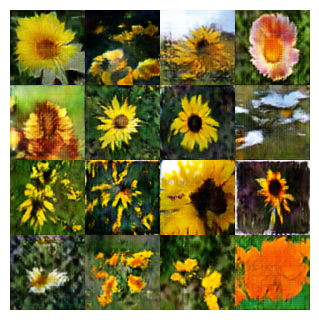

Epoch 89/100 | Iter 19 /189 | D_loss -25.6180 | G_loss 203.2899 | Gradient_Penalty 7.8289 | Gradient_Norm 1.6533 | 
Epoch 89/100 | Iter 38 /189 | D_loss -23.8860 | G_loss 205.8167 | Gradient_Penalty 3.8033 | Gradient_Norm 1.4680 | 
Epoch 89/100 | Iter 57 /189 | D_loss -13.7776 | G_loss 205.4620 | Gradient_Penalty 3.6421 | Gradient_Norm 1.4966 | 
Epoch 89/100 | Iter 76 /189 | D_loss -20.4672 | G_loss 236.2067 | Gradient_Penalty 3.0758 | Gradient_Norm 1.4743 | 
Epoch 89/100 | Iter 95 /189 | D_loss -19.3892 | G_loss 196.2090 | Gradient_Penalty 7.2740 | Gradient_Norm 1.6694 | 
Epoch 89/100 | Iter 114/189 | D_loss -19.5917 | G_loss 217.7943 | Gradient_Penalty 6.8245 | Gradient_Norm 1.6007 | 
Epoch 89/100 | Iter 133/189 | D_loss -27.7136 | G_loss 206.0711 | Gradient_Penalty 2.0126 | Gradient_Norm 1.3142 | 
Epoch 89/100 | Iter 152/189 | D_loss -17.5690 | G_loss 211.3490 | Gradient_Penalty 3.8772 | Gradient_Norm 1.4854 | 
Epoch 89/100 | Iter 171/189 | D_loss -16.8059 | G_loss 217.2712 | Gradie

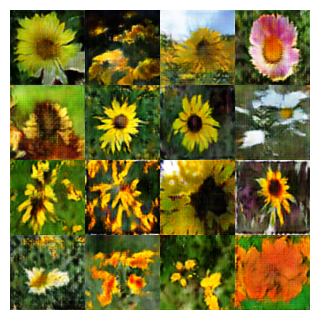

Epoch 90/100 | Iter 19 /189 | D_loss -17.9523 | G_loss 207.8777 | Gradient_Penalty 5.2158 | Gradient_Norm 1.5356 | 
Epoch 90/100 | Iter 38 /189 | D_loss -15.7477 | G_loss 218.6549 | Gradient_Penalty 3.3448 | Gradient_Norm 1.4361 | 
Epoch 90/100 | Iter 57 /189 | D_loss -22.0191 | G_loss 210.3536 | Gradient_Penalty 2.8984 | Gradient_Norm 1.3908 | 
Epoch 90/100 | Iter 76 /189 | D_loss -30.7829 | G_loss 206.6852 | Gradient_Penalty 2.9575 | Gradient_Norm 1.4393 | 
Epoch 90/100 | Iter 95 /189 | D_loss -30.4652 | G_loss 208.8223 | Gradient_Penalty 6.9892 | Gradient_Norm 1.5901 | 
Epoch 90/100 | Iter 114/189 | D_loss -17.7403 | G_loss 209.5230 | Gradient_Penalty 12.8020 | Gradient_Norm 1.6314 | 
Epoch 90/100 | Iter 133/189 | D_loss -25.6536 | G_loss 239.7514 | Gradient_Penalty 6.5524 | Gradient_Norm 1.6264 | 
Epoch 90/100 | Iter 152/189 | D_loss -20.4980 | G_loss 218.3658 | Gradient_Penalty 2.9757 | Gradient_Norm 1.4372 | 
Epoch 90/100 | Iter 171/189 | D_loss -17.8087 | G_loss 211.4806 | Gradi

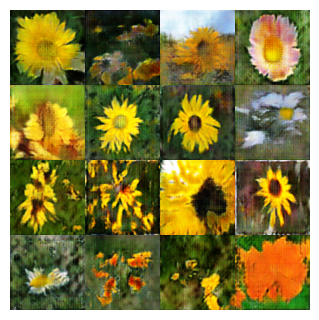

Epoch 91/100 | Iter 19 /189 | D_loss -28.3227 | G_loss 196.1127 | Gradient_Penalty 5.4451 | Gradient_Norm 1.5368 | 
Epoch 91/100 | Iter 38 /189 | D_loss -22.0730 | G_loss 210.8024 | Gradient_Penalty 4.1722 | Gradient_Norm 1.4749 | 
Epoch 91/100 | Iter 57 /189 | D_loss -19.3682 | G_loss 213.5262 | Gradient_Penalty 2.7955 | Gradient_Norm 1.3978 | 
Epoch 91/100 | Iter 76 /189 | D_loss -18.9870 | G_loss 227.8288 | Gradient_Penalty 4.6831 | Gradient_Norm 1.5696 | 
Epoch 91/100 | Iter 95 /189 | D_loss -32.8071 | G_loss 199.1471 | Gradient_Penalty 5.0710 | Gradient_Norm 1.5139 | 
Epoch 91/100 | Iter 114/189 | D_loss -20.7706 | G_loss 222.1018 | Gradient_Penalty 4.7690 | Gradient_Norm 1.5308 | 
Epoch 91/100 | Iter 133/189 | D_loss -37.9702 | G_loss 220.5053 | Gradient_Penalty 4.8752 | Gradient_Norm 1.5466 | 
Epoch 91/100 | Iter 152/189 | D_loss -18.5820 | G_loss 216.7670 | Gradient_Penalty 4.4445 | Gradient_Norm 1.5096 | 
Epoch 91/100 | Iter 171/189 | D_loss -12.6262 | G_loss 220.7724 | Gradie

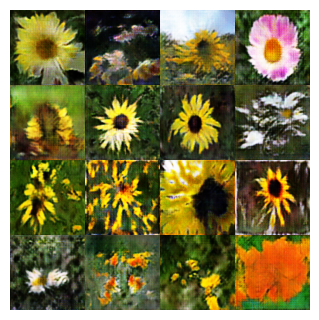

Epoch 92/100 | Iter 19 /189 | D_loss -17.0058 | G_loss 224.7653 | Gradient_Penalty 7.0419 | Gradient_Norm 1.5542 | 
Epoch 92/100 | Iter 38 /189 | D_loss -16.7531 | G_loss 210.8387 | Gradient_Penalty 4.3779 | Gradient_Norm 1.4853 | 
Epoch 92/100 | Iter 57 /189 | D_loss -34.6109 | G_loss 206.3498 | Gradient_Penalty 15.0172 | Gradient_Norm 1.8745 | 
Epoch 92/100 | Iter 76 /189 | D_loss -16.0777 | G_loss 216.6420 | Gradient_Penalty 4.8694 | Gradient_Norm 1.5655 | 
Epoch 92/100 | Iter 95 /189 | D_loss -23.9006 | G_loss 215.3024 | Gradient_Penalty 2.8121 | Gradient_Norm 1.4005 | 
Epoch 92/100 | Iter 114/189 | D_loss -20.5706 | G_loss 211.8940 | Gradient_Penalty 4.9737 | Gradient_Norm 1.5275 | 
Epoch 92/100 | Iter 133/189 | D_loss -21.9577 | G_loss 217.2331 | Gradient_Penalty 4.8633 | Gradient_Norm 1.5016 | 
Epoch 92/100 | Iter 152/189 | D_loss -20.7370 | G_loss 210.0296 | Gradient_Penalty 2.1985 | Gradient_Norm 1.3589 | 
Epoch 92/100 | Iter 171/189 | D_loss -20.4202 | G_loss 221.8422 | Gradi

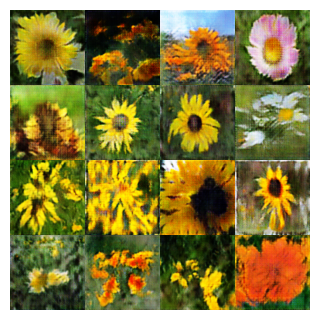

Epoch 93/100 | Iter 19 /189 | D_loss -23.2409 | G_loss 231.3589 | Gradient_Penalty 2.6578 | Gradient_Norm 1.4301 | 
Epoch 93/100 | Iter 38 /189 | D_loss -20.7267 | G_loss 217.0461 | Gradient_Penalty 8.7464 | Gradient_Norm 1.6116 | 
Epoch 93/100 | Iter 57 /189 | D_loss -21.7392 | G_loss 204.6842 | Gradient_Penalty 4.7296 | Gradient_Norm 1.5027 | 
Epoch 93/100 | Iter 76 /189 | D_loss -20.4867 | G_loss 226.4345 | Gradient_Penalty 6.2181 | Gradient_Norm 1.5672 | 
Epoch 93/100 | Iter 95 /189 | D_loss -23.0861 | G_loss 222.7283 | Gradient_Penalty 2.4974 | Gradient_Norm 1.4293 | 
Epoch 93/100 | Iter 114/189 | D_loss -8.5176 | G_loss 228.0297 | Gradient_Penalty 3.0646 | Gradient_Norm 1.4283 | 
Epoch 93/100 | Iter 133/189 | D_loss -24.9334 | G_loss 205.8167 | Gradient_Penalty 5.4021 | Gradient_Norm 1.5422 | 
Epoch 93/100 | Iter 152/189 | D_loss -20.2437 | G_loss 227.2711 | Gradient_Penalty 5.4981 | Gradient_Norm 1.5556 | 
Epoch 93/100 | Iter 171/189 | D_loss -13.0564 | G_loss 217.9193 | Gradien

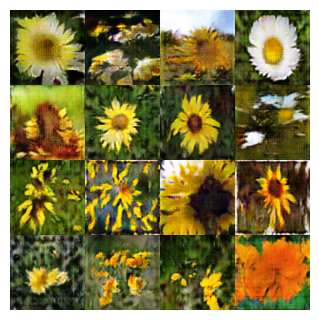

Epoch 94/100 | Iter 19 /189 | D_loss -18.7355 | G_loss 223.5221 | Gradient_Penalty 5.4683 | Gradient_Norm 1.5191 | 
Epoch 94/100 | Iter 38 /189 | D_loss -25.2838 | G_loss 216.8400 | Gradient_Penalty 2.2865 | Gradient_Norm 1.3873 | 
Epoch 94/100 | Iter 57 /189 | D_loss -25.0754 | G_loss 211.9250 | Gradient_Penalty 2.1347 | Gradient_Norm 1.3904 | 
Epoch 94/100 | Iter 76 /189 | D_loss -24.4224 | G_loss 218.9335 | Gradient_Penalty 3.6248 | Gradient_Norm 1.4249 | 
Epoch 94/100 | Iter 95 /189 | D_loss -22.5685 | G_loss 204.3607 | Gradient_Penalty 3.4236 | Gradient_Norm 1.4877 | 
Epoch 94/100 | Iter 114/189 | D_loss -22.2361 | G_loss 227.5663 | Gradient_Penalty 1.8900 | Gradient_Norm 1.3857 | 
Epoch 94/100 | Iter 133/189 | D_loss -14.9996 | G_loss 224.4894 | Gradient_Penalty 1.7506 | Gradient_Norm 1.3337 | 
Epoch 94/100 | Iter 152/189 | D_loss -15.9591 | G_loss 227.8478 | Gradient_Penalty 2.2506 | Gradient_Norm 1.3993 | 
Epoch 94/100 | Iter 171/189 | D_loss -28.3700 | G_loss 213.3592 | Gradie

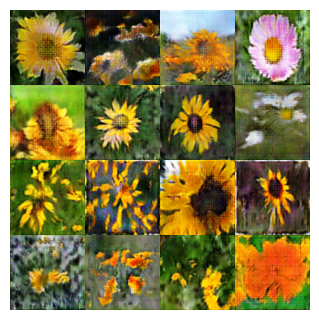

Epoch 95/100 | Iter 19 /189 | D_loss -23.9963 | G_loss 226.6026 | Gradient_Penalty 2.6539 | Gradient_Norm 1.4458 | 
Epoch 95/100 | Iter 38 /189 | D_loss -19.7443 | G_loss 218.4720 | Gradient_Penalty 3.0670 | Gradient_Norm 1.4197 | 
Epoch 95/100 | Iter 57 /189 | D_loss -14.7262 | G_loss 228.4729 | Gradient_Penalty 6.6621 | Gradient_Norm 1.6373 | 
Epoch 95/100 | Iter 76 /189 | D_loss -24.6855 | G_loss 210.4183 | Gradient_Penalty 8.0464 | Gradient_Norm 1.7140 | 
Epoch 95/100 | Iter 95 /189 | D_loss -22.0239 | G_loss 227.3044 | Gradient_Penalty 4.9153 | Gradient_Norm 1.4809 | 
Epoch 95/100 | Iter 114/189 | D_loss -19.9908 | G_loss 209.8790 | Gradient_Penalty 4.7126 | Gradient_Norm 1.5625 | 
Epoch 95/100 | Iter 133/189 | D_loss -22.5386 | G_loss 232.9789 | Gradient_Penalty 3.9254 | Gradient_Norm 1.4695 | 
Epoch 95/100 | Iter 152/189 | D_loss -15.2682 | G_loss 229.9454 | Gradient_Penalty 5.1576 | Gradient_Norm 1.5095 | 
Epoch 95/100 | Iter 171/189 | D_loss -36.3818 | G_loss 220.1452 | Gradie

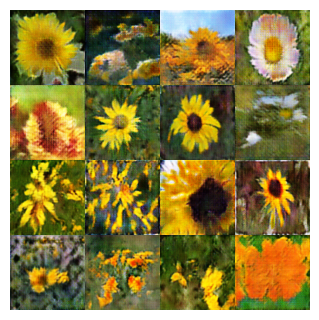

Epoch 96/100 | Iter 19 /189 | D_loss -25.0302 | G_loss 214.1041 | Gradient_Penalty 2.8285 | Gradient_Norm 1.3832 | 
Epoch 96/100 | Iter 38 /189 | D_loss -25.6939 | G_loss 233.0004 | Gradient_Penalty 7.4103 | Gradient_Norm 1.6740 | 
Epoch 96/100 | Iter 57 /189 | D_loss -33.9533 | G_loss 218.0409 | Gradient_Penalty 6.2290 | Gradient_Norm 1.6331 | 
Epoch 96/100 | Iter 76 /189 | D_loss -20.8124 | G_loss 235.7366 | Gradient_Penalty 2.2515 | Gradient_Norm 1.4285 | 
Epoch 96/100 | Iter 95 /189 | D_loss -27.0010 | G_loss 236.2117 | Gradient_Penalty 3.3347 | Gradient_Norm 1.4716 | 
Epoch 96/100 | Iter 114/189 | D_loss -19.8387 | G_loss 235.5345 | Gradient_Penalty 2.1277 | Gradient_Norm 1.3471 | 
Epoch 96/100 | Iter 133/189 | D_loss -23.1077 | G_loss 213.2556 | Gradient_Penalty 5.9061 | Gradient_Norm 1.5852 | 
Epoch 96/100 | Iter 152/189 | D_loss -14.4944 | G_loss 234.2110 | Gradient_Penalty 4.2690 | Gradient_Norm 1.5438 | 
Epoch 96/100 | Iter 171/189 | D_loss -24.9678 | G_loss 234.1441 | Gradie

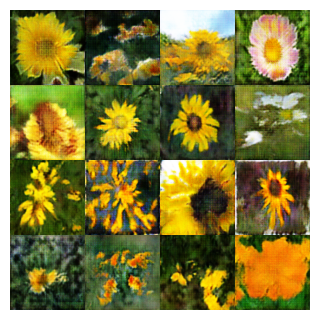

Epoch 97/100 | Iter 19 /189 | D_loss -39.9771 | G_loss 218.2726 | Gradient_Penalty 6.8449 | Gradient_Norm 1.6523 | 
Epoch 97/100 | Iter 38 /189 | D_loss -32.5479 | G_loss 235.1281 | Gradient_Penalty 10.8651 | Gradient_Norm 1.6516 | 
Epoch 97/100 | Iter 57 /189 | D_loss -34.1333 | G_loss 217.7029 | Gradient_Penalty 4.7010 | Gradient_Norm 1.5838 | 
Epoch 97/100 | Iter 76 /189 | D_loss -29.7579 | G_loss 237.4717 | Gradient_Penalty 3.5203 | Gradient_Norm 1.5244 | 
Epoch 97/100 | Iter 95 /189 | D_loss -20.6466 | G_loss 247.6585 | Gradient_Penalty 3.2384 | Gradient_Norm 1.4811 | 
Epoch 97/100 | Iter 114/189 | D_loss -14.0983 | G_loss 234.2436 | Gradient_Penalty 5.5333 | Gradient_Norm 1.4525 | 
Epoch 97/100 | Iter 133/189 | D_loss -20.2458 | G_loss 233.7505 | Gradient_Penalty 4.9661 | Gradient_Norm 1.5411 | 
Epoch 97/100 | Iter 152/189 | D_loss -19.2246 | G_loss 221.3887 | Gradient_Penalty 2.0407 | Gradient_Norm 1.3510 | 
Epoch 97/100 | Iter 171/189 | D_loss -28.1356 | G_loss 216.3400 | Gradi

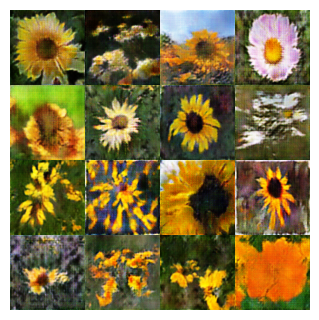

Epoch 98/100 | Iter 19 /189 | D_loss -22.4576 | G_loss 227.8058 | Gradient_Penalty 4.7496 | Gradient_Norm 1.5656 | 
Epoch 98/100 | Iter 38 /189 | D_loss -21.9065 | G_loss 227.1857 | Gradient_Penalty 4.6733 | Gradient_Norm 1.5638 | 
Epoch 98/100 | Iter 57 /189 | D_loss -15.2353 | G_loss 226.4892 | Gradient_Penalty 3.8465 | Gradient_Norm 1.5115 | 
Epoch 98/100 | Iter 76 /189 | D_loss -22.4240 | G_loss 229.5497 | Gradient_Penalty 3.2154 | Gradient_Norm 1.4657 | 
Epoch 98/100 | Iter 95 /189 | D_loss -20.8299 | G_loss 221.3743 | Gradient_Penalty 7.2239 | Gradient_Norm 1.6109 | 
Epoch 98/100 | Iter 114/189 | D_loss -24.7325 | G_loss 223.8427 | Gradient_Penalty 10.3120 | Gradient_Norm 1.7695 | 
Epoch 98/100 | Iter 133/189 | D_loss -24.5580 | G_loss 207.0865 | Gradient_Penalty 6.5865 | Gradient_Norm 1.6464 | 
Epoch 98/100 | Iter 152/189 | D_loss -24.1267 | G_loss 234.2561 | Gradient_Penalty 5.9729 | Gradient_Norm 1.5502 | 
Epoch 98/100 | Iter 171/189 | D_loss -29.7965 | G_loss 255.8591 | Gradi

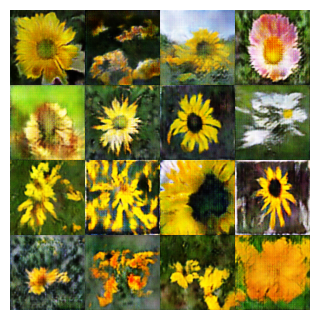

Epoch 99/100 | Iter 19 /189 | D_loss -24.8944 | G_loss 233.4964 | Gradient_Penalty 4.1154 | Gradient_Norm 1.5273 | 
Epoch 99/100 | Iter 38 /189 | D_loss -18.6121 | G_loss 228.9313 | Gradient_Penalty 4.3609 | Gradient_Norm 1.5415 | 
Epoch 99/100 | Iter 57 /189 | D_loss -13.7180 | G_loss 238.5302 | Gradient_Penalty 4.4318 | Gradient_Norm 1.4258 | 
Epoch 99/100 | Iter 76 /189 | D_loss -16.2871 | G_loss 235.1838 | Gradient_Penalty 1.9401 | Gradient_Norm 1.3644 | 
Epoch 99/100 | Iter 95 /189 | D_loss -18.3722 | G_loss 232.4343 | Gradient_Penalty 3.3636 | Gradient_Norm 1.4708 | 
Epoch 99/100 | Iter 114/189 | D_loss -16.6518 | G_loss 235.7544 | Gradient_Penalty 8.2853 | Gradient_Norm 1.5802 | 
Epoch 99/100 | Iter 133/189 | D_loss -19.8551 | G_loss 241.9855 | Gradient_Penalty 2.8106 | Gradient_Norm 1.4238 | 
Epoch 99/100 | Iter 152/189 | D_loss -20.4432 | G_loss 237.5115 | Gradient_Penalty 2.4477 | Gradient_Norm 1.4205 | 
Epoch 99/100 | Iter 171/189 | D_loss -26.7849 | G_loss 234.4481 | Gradie

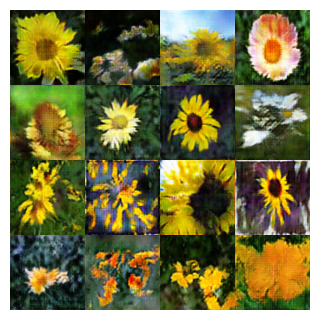

Epoch 100/100 | Iter 19 /189 | D_loss -34.0000 | G_loss 229.5290 | Gradient_Penalty 4.0762 | Gradient_Norm 1.4558 | 
Epoch 100/100 | Iter 38 /189 | D_loss -17.5791 | G_loss 229.2174 | Gradient_Penalty 5.2307 | Gradient_Norm 1.5361 | 
Epoch 100/100 | Iter 57 /189 | D_loss -21.5908 | G_loss 253.4575 | Gradient_Penalty 2.1468 | Gradient_Norm 1.3275 | 
Epoch 100/100 | Iter 76 /189 | D_loss -15.2290 | G_loss 228.4549 | Gradient_Penalty 17.9273 | Gradient_Norm 1.9387 | 
Epoch 100/100 | Iter 95 /189 | D_loss -13.5054 | G_loss 239.7809 | Gradient_Penalty 3.6244 | Gradient_Norm 1.4357 | 
Epoch 100/100 | Iter 114/189 | D_loss -15.6819 | G_loss 223.6780 | Gradient_Penalty 3.6983 | Gradient_Norm 1.4276 | 
Epoch 100/100 | Iter 133/189 | D_loss -19.7267 | G_loss 235.4726 | Gradient_Penalty 8.8093 | Gradient_Norm 1.6801 | 
Epoch 100/100 | Iter 152/189 | D_loss -17.3340 | G_loss 237.6715 | Gradient_Penalty 6.0136 | Gradient_Norm 1.5041 | 
Epoch 100/100 | Iter 171/189 | D_loss -18.3132 | G_loss 238.437

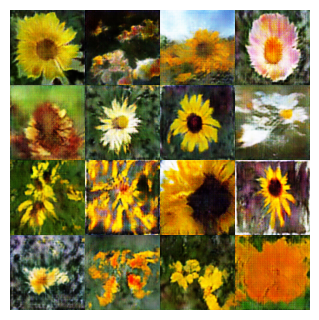

In [10]:
epochs = 100
print_every = 19
batch_size = loader.batch_size

n_disc = 2

G_loss = []
D_loss = []
Grad_pen = []
Grad_norm = []

fixed_z = torch.randn(16, latent_dim, device=device)

for epoch in tqdm(range(epochs)):
    generator.train()
    discriminator.train()
    for i, (images, _) in enumerate(loader):
        images = images.to(device)
        
        # Discriminator Train
        for _ in range(n_disc):
            z = torch.randn(batch_size, latent_dim, device=device)
            fake_imgs = generator(z).detach()
    
            d_true = discriminator(images)
            d_fake = discriminator(fake_imgs)
    
            gp, gn = gradient_penalty_loss(images, fake_imgs, discriminator, gp_weight)
    
            D_optimizer.zero_grad()
            d_loss = d_fake.mean() - d_true.mean() + gp
            d_loss.backward()
            D_optimizer.step()
        
        # Generator Train
        z = torch.randn(batch_size, latent_dim, device=device)
        fake_imgs = generator(z)

        d_fake = discriminator(fake_imgs)

        G_optimizer.zero_grad()
        g_loss = -d_fake.mean()
        g_loss.backward()
        G_optimizer.step()

        # Record Logs
        G_loss.append(g_loss.item())
        D_loss.append(d_loss.item())
        Grad_pen.append(gp.item())
        Grad_norm.append(gn.item())
        
        if (i+1)%print_every == 0:
            print(f"Epoch {epoch+1}/{epochs} | ", end="")
            print(f"Iter {i+1:<3}/{len(loader)} | ", end="")
            print(f"D_loss {d_loss.item():.4f} | ", end="")
            print(f"G_loss {g_loss.item():.4f} | ", end="")
            print(f"Gradient_Penalty {gp.item():.4f} | ", end="")
            print(f"Gradient_Norm {gn.item():.4f} | ")

    generator.eval()
    discriminator.eval()

    with torch.no_grad():
        generated = generator(fixed_z).cpu()

    generated = (generated + 1)/2
    generated = generated.clamp(0,1)

    fig, axes = plt.subplots(4,4, figsize=(3,3))
    for i, ax in enumerate(axes.flatten()):
        img = generated[i]
        ax.imshow(img.permute(1,2,0))
        ax.axis(False)
        
    plt.subplots_adjust(wspace=0, hspace=0)
    plt.tight_layout(pad=0)
    plt.savefig(f"/kaggle/working/progress/plot_{epoch+1}.png", dpi=300)
    plt.show()

G_loss_total += G_loss
D_loss_total += D_loss
Grad_pen_total += Grad_pen
Grad_norm_total += Grad_norm

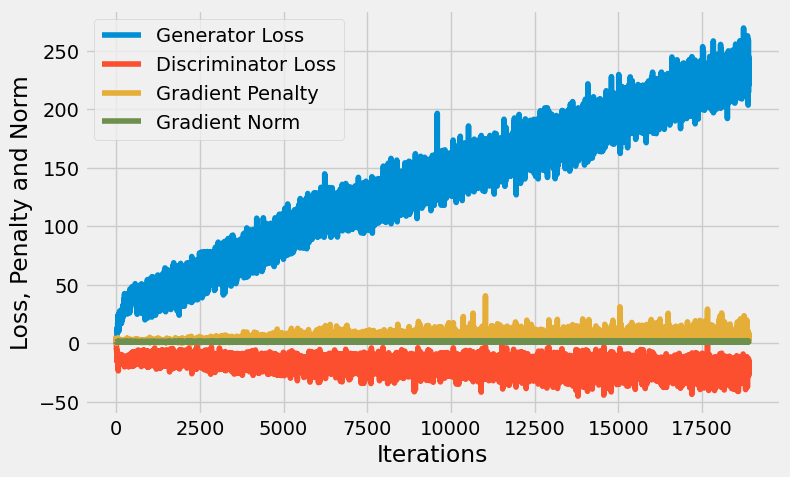

In [11]:
plt.style.use("fivethirtyeight")
plt.figure(figsize=(8,5))
plt.plot(G_loss_total, label = "Generator Loss")
plt.plot(D_loss_total, label = "Discriminator Loss")
plt.plot(Grad_pen_total, label = "Gradient Penalty")
plt.plot(Grad_norm_total, label = "Gradient Norm")
plt.xlabel("Iterations")
plt.ylabel("Loss, Penalty and Norm")
plt.legend()
plt.show()

In [12]:
import shutil

shutil.make_archive("flower_plots", "zip", "/kaggle/working/progress")

'/kaggle/working/flower_plots.zip'

In [95]:
# shutil.rmtree("/kaggle/working/progress")
# os.remove("/kaggle/working/flower_plots.zip")

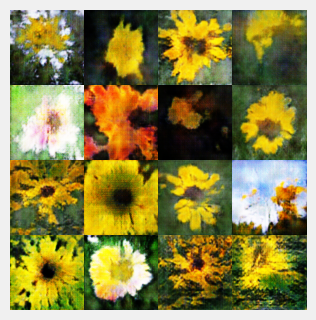

In [94]:
generator.eval()
discriminator.eval()

with torch.no_grad():
    z = torch.randn(16, latent_dim, device=device)
    generated = generator(z).cpu()

generated = (generated + 1)/2
generated = generated.clamp(0,1)

fig, axes = plt.subplots(4,4, figsize=(3,3))
for i, ax in enumerate(axes.flatten()):
    img = generated[i]
    ax.imshow(img.permute(1,2,0))
    ax.axis(False)
    
plt.subplots_adjust(wspace=0, hspace=0)
plt.tight_layout(pad=0)
plt.savefig(f"/kaggle/working/progress/plot_{epoch+1}.png", dpi=300)
plt.show()